In [1]:
import collections
import itertools
import logging
import random
import sys
from collections import deque
from datetime import datetime

from copy import deepcopy

import numpy as np

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
#%matplotlib tk
%matplotlib inline

import seaborn as sns

import gym
import pfrl

import torch
from tqdm import tqdm

from torch import nn
from gym.wrappers import RescaleAction

from util.ppo import PPO_KL
from util.modules import ortho_init, BetaPolicyModel
from util.env import VisionEnvWrapper, to_multi_modal
from conditioned_trp_env.envs.conditioned_trp_env import FoodClass

sns.set()
sns.set_context("talk")

seed = 100
n_channel = 4
n_frame_stack = 3
dim_vision_flatten = 200
im_size = (64, 64)

random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.cuda.manual_seed(seed)


########################################
# Environment
########################################

def get_env(n_blue_red=(6, 4), blue_nutrient=(0.1, 0), red_nutrient=(0, 0.1)):
    env = gym.make(
        id="trp_env:SmallLowGearAntTRP-v0",
        max_episode_steps=np.inf,
        internal_reset="setpoint",
        n_bins=2,
        sensor_range=0.1,
        n_blue=n_blue_red[0],
        n_red=n_blue_red[1],
        blue_nutrient=blue_nutrient,
        red_nutrient=red_nutrient,
    )
    env = RescaleAction(env, 0, 1)
    env = VisionEnvWrapper(env, im_size=im_size, n_frame=n_frame_stack, mode="rgbd_array")
    env = pfrl.wrappers.CastObservationToFloat32(env)
    return env


########################################
# Agent
########################################
obs_size_prop = 27
obs_size_intero = 2
action_size = 8

# vision encoder
class Encoder(nn.Module):
    def __init__(self):
        super(Encoder, self).__init__()

        self.flatten_size = 26912  # 35 * 35 * 32

        # random shift augmentation
        #self.aug = RandomShiftsAug(pad=2)

        self.vision_encoder = nn.Sequential(
            nn.Conv2d(in_channels=n_channel * n_frame_stack, out_channels=32, kernel_size=3, stride=2, bias=False),
            nn.ELU(inplace=True),
            nn.Conv2d(32, 32, 3, stride=1, bias=False),
            nn.ELU(inplace=True),
            nn.Flatten(),
            nn.Linear(in_features=self.flatten_size, out_features=dim_vision_flatten),
            nn.LayerNorm(normalized_shape=dim_vision_flatten),
            nn.Tanh()
        )

        # Initialization
        for l in self.vision_encoder:
            if isinstance(l, nn.Conv2d):
                gain = nn.init.calculate_gain('relu')
                nn.init.orthogonal_(l.weight, gain=gain)
                if hasattr(l.bias, "data"):
                    l.bias.data.fill_(0.0)
            if isinstance(l, nn.Linear):
                nn.init.orthogonal_(l.weight, gain=1)
                nn.init.zeros_(l.bias)
            
    def forward(self, x, enable_aug=False):
        x_prop, x_intero, x_vision = to_multi_modal(x,
                                                    im_size=im_size,
                                                    n_frame=n_frame_stack,
                                                    n_channel=n_channel)

#         if enable_aug:
#             x_vision = self.aug(x_vision.float())

        feature_vision = self.vision_encoder(x_vision)
        # print("feature", feature_vision.shape)

        return feature_vision, x_prop, x_intero


dim_joint_feature = dim_vision_flatten + 27 + 2


# compose a total model
class FFModel(nn.Module):
    def __init__(self):
        super(FFModel, self).__init__()

        self.encoder = Encoder()

        self.policy_network = BetaPolicyModel(obs_size=dim_joint_feature,
                                              action_size=action_size,
                                              activation=nn.Tanh,
                                              hidden1=300,
                                              hidden2=200)

        self.value_network = nn.Sequential(
            nn.Linear(dim_joint_feature, 400),
            nn.ReLU(inplace=True),
            nn.Linear(400, 300),
            nn.ReLU(inplace=True),
            nn.Linear(300, 1)
        )

        ortho_init(self.value_network[0], gain=1)
        ortho_init(self.value_network[2], gain=1)
        ortho_init(self.value_network[4], gain=1)
        
    def forward(self, x, enable_aug=False):
        # enable data augmentation while training
        feature_vision, x_prop, x_intero = self.encoder(x, enable_aug)

        # policy path (removing detach op for vision)
        x_policy = torch.cat((feature_vision, x_prop, x_intero), dim=1)
        distribs = self.policy_network(x_policy)

        # value path
        x_value = torch.cat((feature_vision, x_prop, x_intero), dim=1)
        vs_pred = self.value_network(x_value)

        return (distribs, vs_pred)
    
    def feature(self, x, layer=2):
        feature_vision, x_prop, x_intero = self.encoder(x)
        x_policy = torch.cat((feature_vision, x_prop, x_intero), dim=1)
        if layer == 1:
            latent = self.policy_network.fc[0](x_policy)
            latent = self.policy_network.fc[1](latent)
        elif layer == 2:
            latent = self.policy_network.fc(x_policy)
        else:
            raise ValueError(f"layer value should be 1 or 2. given {layer}")
        return latent.detach()
    
    def feature_vision(self, x):
        feature_vision, x_prop, x_intero = self.encoder(x)
        return feature_vision.detach()


model = FFModel()

opt = torch.optim.Adam(model.parameters())

if torch.cuda.is_available():
    gpu_id = 1
    print(torch.cuda.get_device_name(gpu_id))
else:
    gpu_id = None
    

if gpu_id is not None:
    device = torch.device(f'cuda:{gpu_id}')
else:
    device = "cpu"

agent = PPO_KL(
    model=model,
    optimizer=opt,
    gpu=gpu_id,
)

agent.load("data/success_vision/vision-homeostatic_shaped2021-11-26-14-16-12/20000000_finish")


def display_video(frames, framerate=30):
    height, width, _ = frames[0].shape
    dpi = 70
    orig_backend = matplotlib.get_backend()
    matplotlib.use('Agg')  # Switch to headless 'Agg' to inhibit figure rendering.
    fig, ax = plt.subplots(1, 1, figsize=(width / dpi, height / dpi), dpi=dpi)
    matplotlib.use(orig_backend)  # Switch back to the original backend.
    ax.set_axis_off()
    ax.set_aspect('equal')
    ax.set_position([0, 0, 1, 1])
    im = ax.imshow(frames[0], interpolation="nearest")
    def update(frame):
        im.set_data(frame)
        return [im]
    interval = 1000/framerate
    anim = animation.FuncAnimation(fig=fig, func=update, frames=frames,
                                   interval=interval, blit=True, repeat=False)
    return anim


env = get_env()

Import error. Trying to rebuild mujoco_py.
Compiling /opt/homebrew/Caskroom/miniforge/base/envs/ppo_pfrl/lib/python3.8/site-packages/mujoco_py/cymj.pyx because it changed.
[1/1] Cythonizing /opt/homebrew/Caskroom/miniforge/base/envs/ppo_pfrl/lib/python3.8/site-packages/mujoco_py/cymj.pyx
running build_ext
building 'mujoco_py.cymj' extension
/opt/homebrew/bin/gcc-11 -Wno-unused-result -Wsign-compare -Wunreachable-code -DNDEBUG -fwrapv -O2 -Wall -fPIC -O2 -isystem /opt/homebrew/Caskroom/miniforge/base/envs/ppo_pfrl/include -arch arm64 -fPIC -O2 -isystem /opt/homebrew/Caskroom/miniforge/base/envs/ppo_pfrl/include -arch arm64 -I/opt/homebrew/opt/openssl@1.1/include -DONMAC -I/opt/homebrew/Caskroom/miniforge/base/envs/ppo_pfrl/lib/python3.8/site-packages/mujoco_py -I/Users/naotoyoshida/.mujoco/mujoco210/include -I/opt/homebrew/Caskroom/miniforge/base/envs/ppo_pfrl/lib/python3.8/site-packages/numpy/core/include -I/opt/homebrew/Caskroom/miniforge/base/envs/ppo_pfrl/include/python3.8 -c /opt/h

In file included from /opt/homebrew/Caskroom/miniforge/base/envs/ppo_pfrl/lib/python3.8/site-packages/mujoco_py/cymj.c:743:
/Users/naotoyoshida/.mujoco/mujoco210/include/mjmodel.h:22:10: fatal error: mujoco/mjtnum.h: No such file or directory
   22 | #include <mujoco/mjtnum.h>
      |          ^~~~~~~~~~~~~~~~~
compilation terminated.


CompileError: command '/opt/homebrew/bin/gcc-11' failed with exit code 1

# Example Run

In [10]:
MAX_STEPS = 100 # 20000

env = get_env()
obs = env.reset()
frames = []

interoception = np.zeros((MAX_STEPS, 2))

for i in tqdm(range(MAX_STEPS)):
    action = agent.act(obs)
    obs, reward, done, info = env.step(action)
    
    interoception[i] = env.get_interoception()
    
    _, _, vision = to_multi_modal(torch.tensor([obs]), im_size=im_size, n_frame=n_frame_stack, n_channel=n_channel)
    vision = env.decode_vision(vision)
    vision = (255. * vision.permute(0, 2, 3, 1)[0].numpy()).astype(np.uint8)[:, :, :3]
    frames.append(vision)
    #vision = env.wrapped_env._get_viewer("rgb_array").read_pixels(64, 64, False)[::-1, :, :]
    frames.append(vision.copy())
    if done:
        break

plt.imshow(frames[10])

Creating offscreen glfw
GLFW error (code %d): %s 65537 b'The GLFW library is not initialized'
GLFW error (code %d): %s 65537 b'The GLFW library is not initialized'
GLFW error (code %d): %s 65537 b'The GLFW library is not initialized'


GlfwError: Failed to create GLFW window

## record video

In [3]:
FPS = 60
anim = display_video(frames, FPS)
writervideo = animation.FFMpegWriter(fps=FPS)
anim.save('ecocentroc_vision.mp4', writer=writervideo)

In [ ]:
plt.plot(interoception)

# Smooth Gradient Saliency

[SmoothGrad: removing noise by adding noise](https://arxiv.org/abs/1706.03825)


In [2]:
def get_vision(input_vision):
    input_vision = torch.split(input_vision, split_size_or_sections=[np.prod(im_size) * n_channel] * n_frame_stack, dim=1)

    input_vision = [im.reshape(-1, im_size[0], im_size[1], n_channel) for im in input_vision]

    input_vision = torch.cat(input_vision, dim=3)

    input_vision = input_vision.view(-1, im_size[0], im_size[1], n_channel * n_frame_stack).permute(0, 3, 1, 2)
    
    return input_vision


def get_visual_saliency(model, obs, action, intero=None, mode="policy", negpos=False):
    assert obs.shape[0] == 1, "obs must be single"
    
    grad_vision_out = None
        
    obs_ = obs.detach()
    o_prop, o_intero, o_vision = torch.split(obs_, split_size_or_sections=(27, 2, np.prod(im_size) * n_channel * n_frame_stack), dim=1)

    o_prop = o_prop.detach()
    if intero:
        o_intero = torch.tensor([intero], device=device)
    else:
        o_intero = o_intero.detach()

    o_vision = o_vision.detach()
    o_vision.requires_grad = True

    obs_ = torch.cat([o_prop, o_intero, o_vision], dim=1)

    dist, v_pred = model(obs_)
    
    if mode == "value":
        loss = v_pred.sum()
        loss = loss / loss.detach()
    elif mode == "policy":
        loss = dist.log_prob(action).sum()
    
    loss.backward()

    torch.nan_to_num(o_vision.grad)

    grad_vision = get_vision(o_vision.grad).cpu().numpy()
    
    if negpos:
        full_grad = grad_vision[0]
        grad_vision = grad_vision[0][8:12]
        grad_vision = np.sum(grad_vision, axis=0)
    else:
        full_grad = grad_vision[0]
        grad_vision = np.abs(grad_vision)
        grad_vision = grad_vision[0][8:12]
        #grad_vision = np.sum(grad_vision, axis=0)
        grad_vision = np.max(grad_vision, axis=0)
        
    grad_vision = grad_vision
    
    c

    return grad_vision, full_grad

### sample trajectory

Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4000/4000 [01:33<00:00, 42.55it/s]


(64, 64, 12)


(-0.2, 0.2)

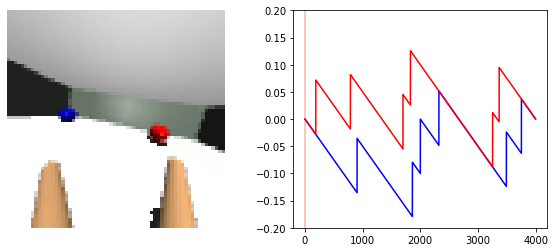

In [37]:
MAX_STEPS = 4000

env = get_env()
obs = env.reset()
frames = []

obs_list = []
action_list = []
intero_list = []

for i in tqdm(range(MAX_STEPS)):
    action = agent.act(obs)

    obs_list.append(deepcopy(obs))
    action_list.append(deepcopy(action))
    
    _, intero, vision = to_multi_modal(torch.tensor([obs]), im_size=im_size, n_frame=n_frame_stack, n_channel=n_channel)

    intero_list.append(intero.numpy()[0].tolist())

    vision = env.decode_vision(vision)
    vision = (255. * vision.permute(0, 2, 3, 1)[0].numpy()).astype(np.uint8)
    frames.append(vision)

    obs, reward, done, info = env.step(action)
    
    if done:
        break

intero_list = np.array(intero_list)

frame = frames[0]
print(frame.shape)
plt.figure(figsize=(10, 4))
plt.subplot(121)
plt.imshow(frame[:, :, -4:-1])
plt.axis('off')
plt.subplot(122)
plt.plot(intero_list[:, 0], "b")
plt.plot(intero_list[:, 1], "r")
plt.plot([5, 5], [-0.2, 0.2], "r", alpha=0.3)
plt.ylim([-0.2, 0.2])

### calculate saliency

In [70]:
mode = "policy"

sal_decay = None
decay_factor = 0.0
vmax = 0.02

sal_list = []
frames_sal = []
for i in tqdm(range(0, MAX_STEPS, 1)):    
    # get saliency
    obs_ = torch.tensor([obs_list[i]], device=device)
    action_ = torch.tensor([action_list[i]], device=device)
    
    sal, _ = get_visual_saliency(agent.model, obs_, action_, mode=mode)
    sal = np.clip(sal, a_min=-vmax, a_max=vmax)
    
    if sal_decay is not None:
        sal_decay = decay_factor * sal_decay + sal
    else:
        sal_decay = sal.copy()
    
    sal_list.append(sal_decay)
    
    # draw figure
    f_ = frames[i][:, :, -4:-1]
    fig = plt.figure(figsize=(15, 4), frameon=False)
    
    plt.subplot(121)
    plt.imshow(f_)
    plt.axis('off')

    plt.subplot(122)
    plt.imshow(sal_decay,
               cmap="viridis",
               interpolation="bicubic")
               #alpha=1.0, vmax=vmax)
    plt.axis('off')

#     plt.subplot(122)
#     plt.plot(intero_list[:, 0], "b", alpha=0.5)
#     plt.plot(intero_list[:, 1], "r", alpha=0.5)
#     plt.plot([i, i], [-0.2, 0.2], "r", alpha=0.3)

    fig.canvas.draw()

    data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
    data = data.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    
    plt.clf()
    plt.close()
    
    frames_sal.append(data)
    
frames_sal = np.array(frames_sal)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4000/4000 [11:56<00:00,  5.58it/s]


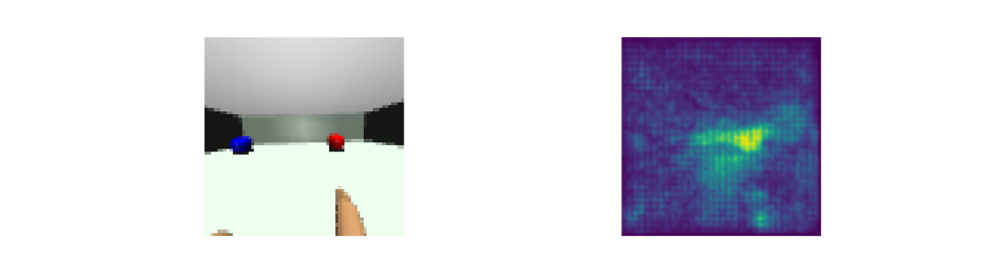

(288, 1080, 3)
[-0.0003 -0.0003]


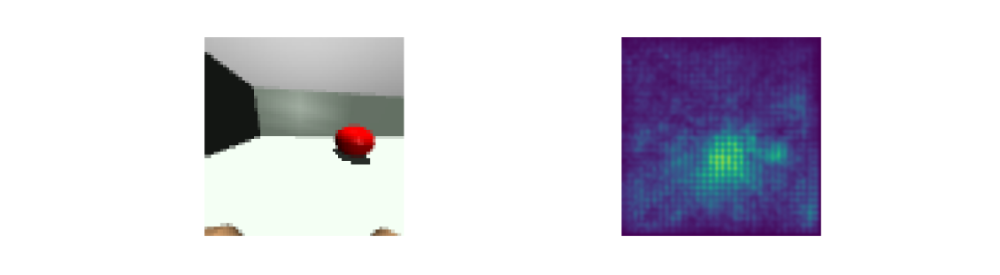

(288, 1080, 3)
[-0.00945 -0.00945]


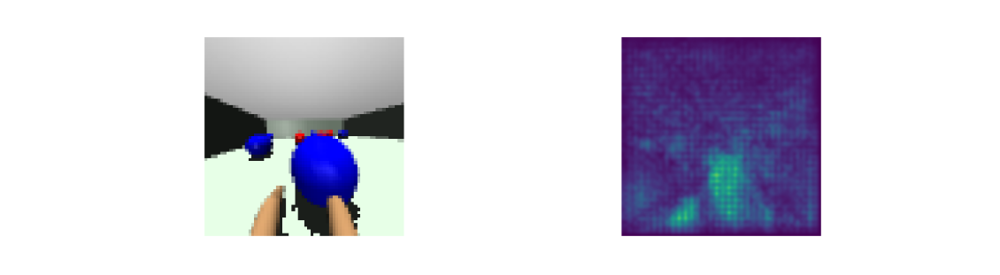

(288, 1080, 3)
[-0.05535  0.04465]


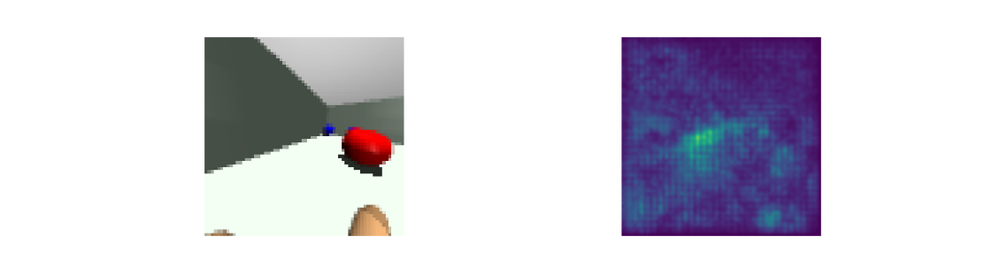

(288, 1080, 3)
[-0.0195 -0.0195]


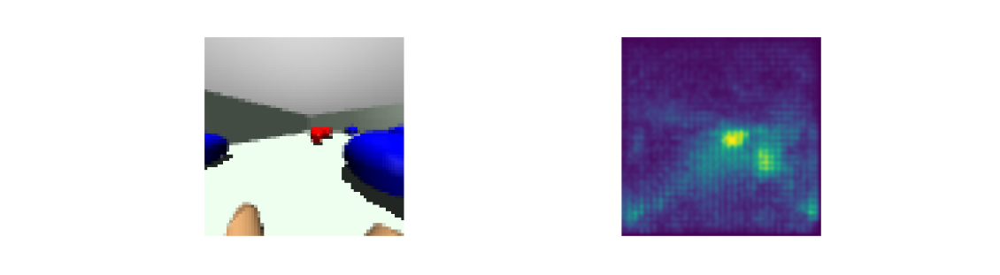

(288, 1080, 3)
[-0.03225  0.06775]


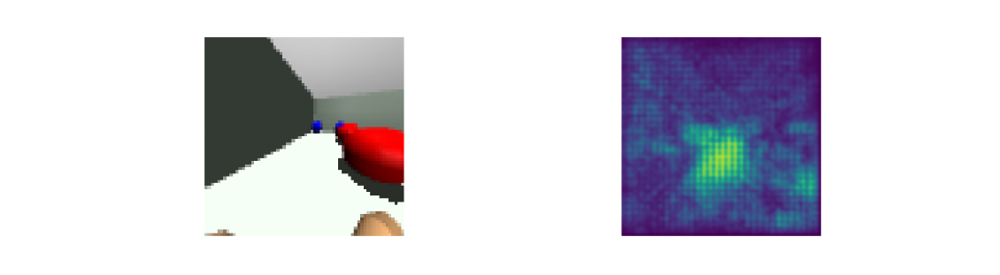

(288, 1080, 3)
[-0.02175 -0.02175]


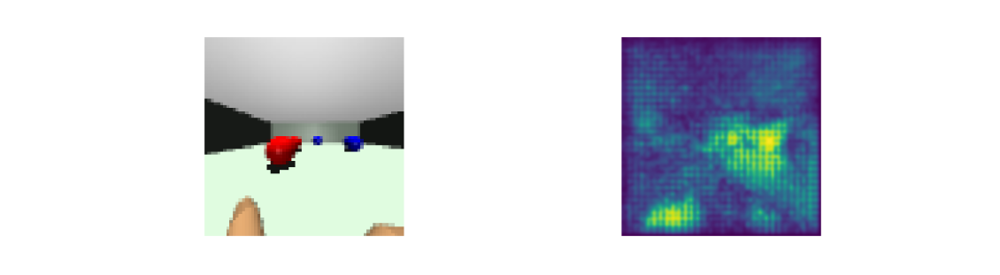

(288, 1080, 3)
[-0.03555  0.06445]


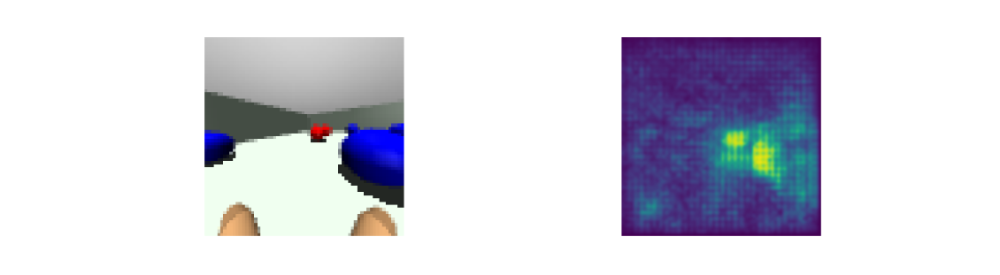

(288, 1080, 3)
[-0.0327  0.0673]


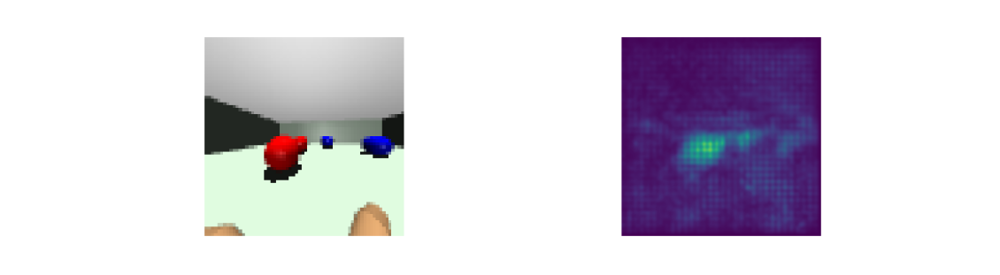

(288, 1080, 3)
[-0.0375  0.0625]


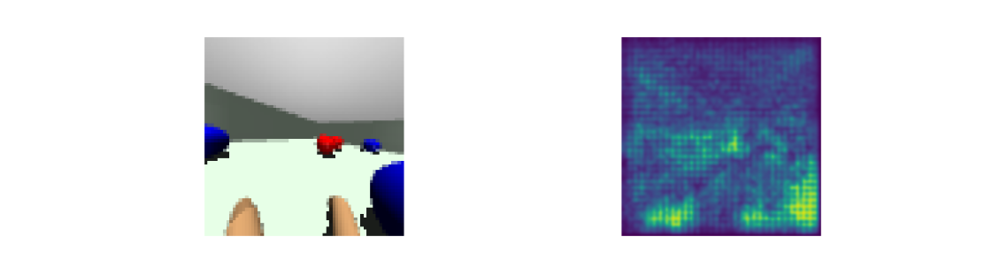

(288, 1080, 3)
[-0.0336  0.0664]


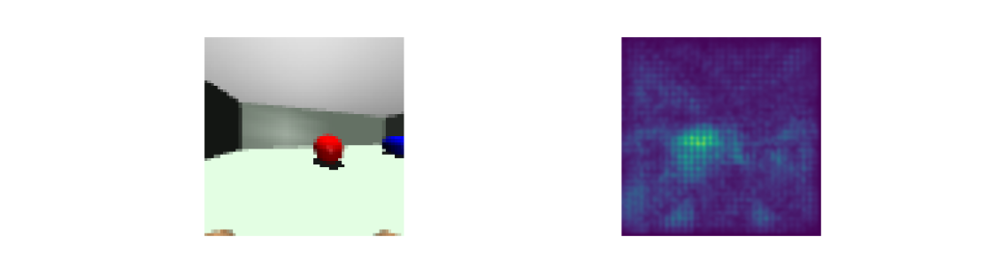

(288, 1080, 3)
[-0.0111 -0.0111]


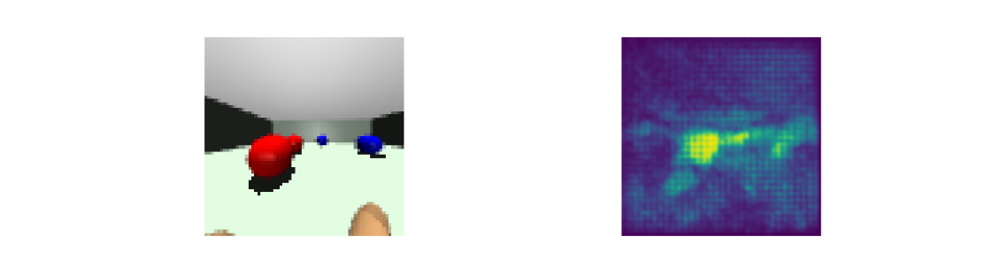

(288, 1080, 3)
[-0.0429  0.0571]


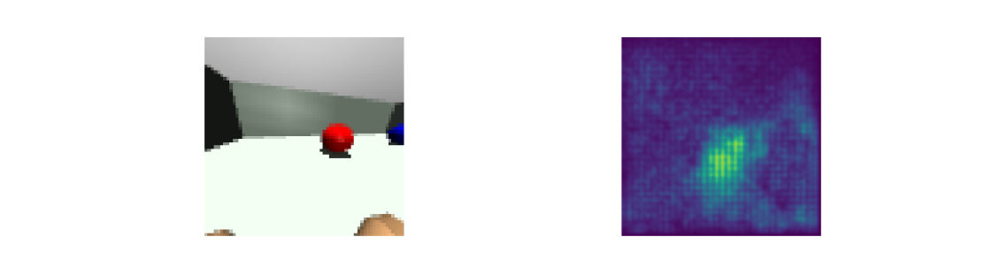

(288, 1080, 3)
[-0.01005 -0.01005]


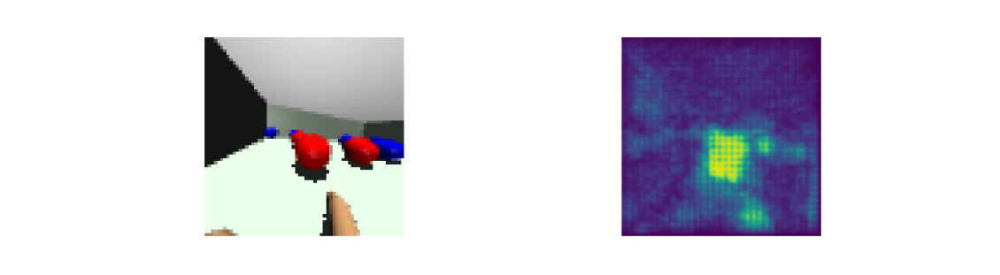

(288, 1080, 3)
[-0.0234 -0.0234]


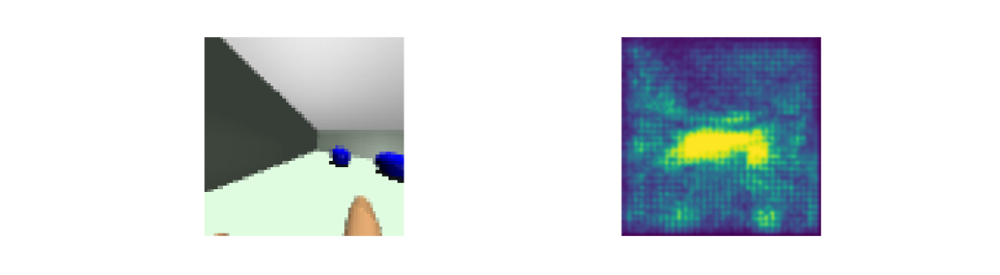

(288, 1080, 3)
[-0.0123 -0.0123]


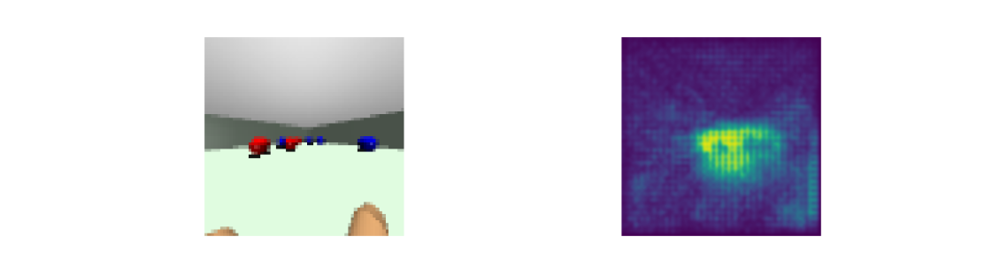

(288, 1080, 3)
[-0.0591  0.0409]


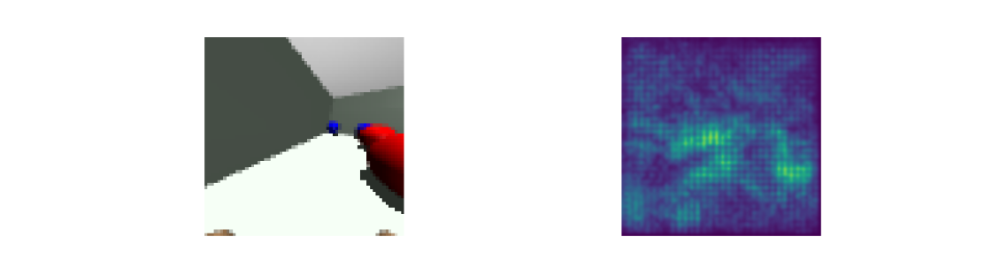

(288, 1080, 3)
[-0.02115 -0.02115]


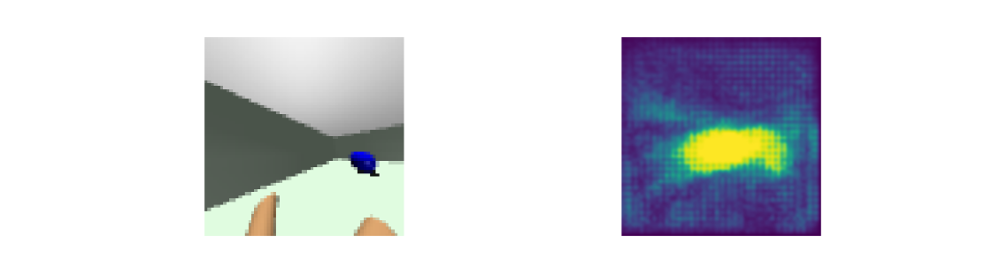

(288, 1080, 3)
[-0.01215 -0.01215]


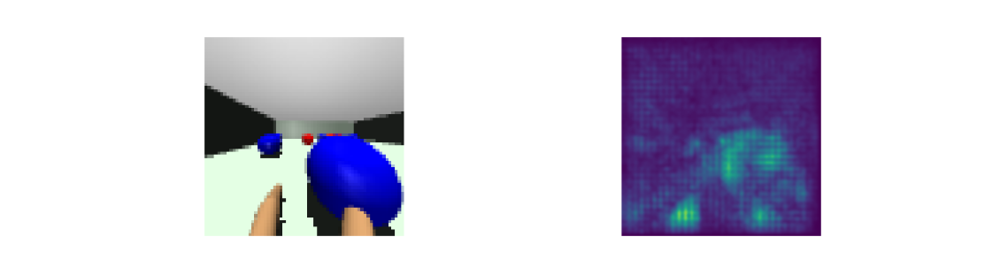

(288, 1080, 3)
[-0.05595  0.04405]


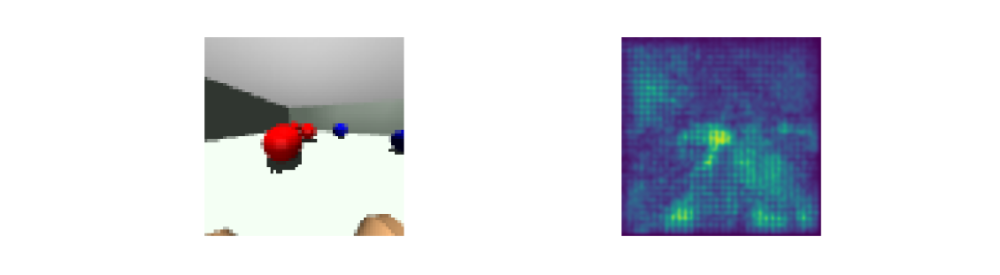

(288, 1080, 3)
[-0.04215  0.05785]


In [69]:
for i in range(20):
    index = np.random.choice(range(len(frames_sal)))
    plt.figure(figsize=(20, 8))
    plt.imshow(frames_sal[index])
    plt.axis('off')
    plt.show()
    print(frames_sal[0].shape)
    print(intero_list[index])

In [12]:
np.save(f"frames_sal_{mode}_overlay", frames_sal)

### record saliency

In [71]:
#frames_sal = np.load("frames_sal_p.npy")

s = datetime.now().strftime("%Y-%m-%d-%H-%M-%S")
FPS = 60

print("get anim...")
anim = display_video(frames_sal, FPS)
print("get writer...")
writervideo = animation.FFMpegWriter(fps=FPS)
print("saving...")
anim.save(f'ecocentroc_vision_sal_{mode}_{s}.mp4', writer=writervideo)
print("done.")

get anim...
get writer...
saving...
done.


## record vision and interoception

In [12]:
frames_vi = []
for i in tqdm(range(0, MAX_STEPS - 11, 1)):      
    # draw figure
    f_ = frames[i][:, :, -4:-1]
    fig = plt.figure(figsize=(10, 5), frameon=False)
    
    plt.subplot(121)
    plt.imshow(f_)
    plt.axis('off')

    plt.subplot(122)
    plt.plot([-0.2, 0.2], [0, 0], "gray", alpha=0.3, linewidth=1)
    plt.plot([0, 0], [-0.2, 0.2], "gray", alpha=0.3, linewidth=1)
    plt.plot(intero_list[:, 0], intero_list[:, 1], "gray", alpha=0.3, linewidth=1)
    plt.plot(intero_list[i:(i+10), 0], intero_list[i:(i+10), 1], "k", linewidth=3)
    plt.ylim([-0.2, 0.2])
    plt.xlim([-0.2, 0.2])
    plt.ylabel("Red")
    plt.xlabel("Blue")
    plt.axis('off')
    fig.canvas.draw()

    data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
    data = data.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    
    plt.clf()
    plt.close()
    
    frames_vi.append(data)
    
frames_vi = np.array(frames_vi)

  0%|          | 0/3989 [00:00<?, ?it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  0%|          | 1/3989 [00:00<14:27,  4.60it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  0%|          | 2/3989 [00:00<13:46,  4.82it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  0%|          | 3/3989 [00:00<13:35,  4.89it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of f

  1%|          | 28/3989 [00:05<13:18,  4.96it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  1%|          | 29/3989 [00:05<13:07,  5.03it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  1%|          | 30/3989 [00:05<12:58,  5.08it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  1%|          | 31/3989 [00:06<12:51,  5.13it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The bina

  1%|▏         | 56/3989 [00:11<12:30,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  1%|▏         | 57/3989 [00:11<12:29,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  1%|▏         | 58/3989 [00:13<46:59,  1.39it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  1%|▏         | 59/3989 [00:13<36:38,  1.79it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The bina

  2%|▏         | 84/3989 [00:18<12:49,  5.07it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  2%|▏         | 85/3989 [00:18<12:50,  5.07it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  2%|▏         | 86/3989 [00:18<12:49,  5.07it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  2%|▏         | 87/3989 [00:18<12:48,  5.08it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The bina

  3%|▎         | 112/3989 [00:23<12:26,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  3%|▎         | 113/3989 [00:23<12:27,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  3%|▎         | 114/3989 [00:24<12:28,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  3%|▎         | 115/3989 [00:24<12:27,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

  4%|▎         | 140/3989 [00:29<12:23,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  4%|▎         | 141/3989 [00:29<12:22,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  4%|▎         | 142/3989 [00:29<12:23,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  4%|▎         | 143/3989 [00:29<12:20,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

  4%|▍         | 168/3989 [00:34<12:09,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  4%|▍         | 169/3989 [00:34<12:06,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  4%|▍         | 170/3989 [00:34<12:07,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  4%|▍         | 171/3989 [00:34<12:06,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

  5%|▍         | 196/3989 [00:39<11:57,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  5%|▍         | 197/3989 [00:39<11:56,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  5%|▍         | 198/3989 [00:40<11:57,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  5%|▍         | 199/3989 [00:40<11:56,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

  6%|▌         | 224/3989 [00:45<12:08,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  6%|▌         | 225/3989 [00:45<12:03,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  6%|▌         | 226/3989 [00:45<12:00,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  6%|▌         | 227/3989 [00:45<11:58,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

  6%|▋         | 252/3989 [00:50<11:51,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  6%|▋         | 253/3989 [00:50<11:49,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  6%|▋         | 254/3989 [00:50<11:50,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  6%|▋         | 255/3989 [00:51<11:54,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

  7%|▋         | 280/3989 [00:55<11:47,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  7%|▋         | 281/3989 [00:55<11:45,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  7%|▋         | 282/3989 [00:56<11:44,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  7%|▋         | 283/3989 [00:56<11:43,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

  8%|▊         | 308/3989 [01:01<11:33,  5.31it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  8%|▊         | 309/3989 [01:01<11:34,  5.30it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  8%|▊         | 310/3989 [01:01<11:34,  5.30it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  8%|▊         | 311/3989 [01:01<11:37,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

  8%|▊         | 336/3989 [01:06<11:35,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  8%|▊         | 337/3989 [01:06<11:34,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  8%|▊         | 338/3989 [01:06<11:32,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  8%|▊         | 339/3989 [01:06<11:31,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

  9%|▉         | 364/3989 [01:12<11:34,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  9%|▉         | 365/3989 [01:12<11:31,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  9%|▉         | 366/3989 [01:12<11:30,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  9%|▉         | 367/3989 [01:12<11:31,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 10%|▉         | 392/3989 [01:17<11:27,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 10%|▉         | 393/3989 [01:17<11:32,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 10%|▉         | 394/3989 [01:17<11:30,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 10%|▉         | 395/3989 [01:18<11:30,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 11%|█         | 420/3989 [01:22<11:26,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 11%|█         | 421/3989 [01:23<11:25,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 11%|█         | 422/3989 [01:23<11:27,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 11%|█         | 423/3989 [01:23<11:31,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 11%|█         | 448/3989 [01:28<11:29,  5.13it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 11%|█▏        | 449/3989 [01:28<11:25,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 11%|█▏        | 450/3989 [01:28<11:20,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 11%|█▏        | 451/3989 [01:28<11:18,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 12%|█▏        | 476/3989 [01:33<11:17,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 12%|█▏        | 477/3989 [01:33<11:17,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 12%|█▏        | 478/3989 [01:34<11:18,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 12%|█▏        | 479/3989 [01:34<11:17,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 13%|█▎        | 504/3989 [01:39<11:13,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 13%|█▎        | 505/3989 [01:39<11:12,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 13%|█▎        | 506/3989 [01:39<11:17,  5.14it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 13%|█▎        | 507/3989 [01:39<11:12,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 13%|█▎        | 532/3989 [01:44<11:01,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 13%|█▎        | 533/3989 [01:44<11:02,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 13%|█▎        | 534/3989 [01:44<11:02,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 13%|█▎        | 535/3989 [01:45<10:59,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 14%|█▍        | 560/3989 [01:49<10:58,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 14%|█▍        | 561/3989 [01:50<10:59,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 14%|█▍        | 562/3989 [01:50<10:58,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 14%|█▍        | 563/3989 [01:50<10:54,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 15%|█▍        | 588/3989 [01:55<10:58,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 15%|█▍        | 589/3989 [01:55<10:49,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 15%|█▍        | 590/3989 [01:55<10:50,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 15%|█▍        | 591/3989 [01:55<10:50,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 15%|█▌        | 616/3989 [02:00<10:59,  5.12it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 15%|█▌        | 617/3989 [02:00<10:56,  5.14it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 15%|█▌        | 618/3989 [02:01<10:53,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 16%|█▌        | 619/3989 [02:01<10:47,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 16%|█▌        | 644/3989 [02:06<10:43,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 16%|█▌        | 645/3989 [02:06<10:41,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 16%|█▌        | 646/3989 [02:06<10:40,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 16%|█▌        | 647/3989 [02:06<10:39,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 17%|█▋        | 672/3989 [02:11<10:52,  5.09it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 17%|█▋        | 673/3989 [02:12<10:47,  5.12it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 17%|█▋        | 674/3989 [02:12<10:47,  5.12it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 17%|█▋        | 675/3989 [02:12<10:43,  5.15it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 18%|█▊        | 700/3989 [02:17<10:28,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 18%|█▊        | 701/3989 [02:17<10:28,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 18%|█▊        | 702/3989 [02:17<10:27,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 18%|█▊        | 703/3989 [02:17<10:26,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 18%|█▊        | 728/3989 [02:22<10:25,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 18%|█▊        | 729/3989 [02:22<10:25,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 18%|█▊        | 730/3989 [02:22<10:24,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 18%|█▊        | 731/3989 [02:23<10:22,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 19%|█▉        | 756/3989 [02:28<10:29,  5.13it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 19%|█▉        | 757/3989 [02:28<10:25,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 19%|█▉        | 758/3989 [02:28<10:20,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 19%|█▉        | 759/3989 [02:28<10:17,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 20%|█▉        | 784/3989 [02:33<10:17,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 20%|█▉        | 785/3989 [02:33<10:18,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 20%|█▉        | 786/3989 [02:33<10:20,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 20%|█▉        | 787/3989 [02:33<10:18,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 20%|██        | 812/3989 [02:38<10:04,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 20%|██        | 813/3989 [02:38<10:02,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 20%|██        | 814/3989 [02:39<10:01,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 20%|██        | 815/3989 [02:39<10:02,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 21%|██        | 840/3989 [02:44<10:01,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 21%|██        | 841/3989 [02:44<10:03,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 21%|██        | 842/3989 [02:44<10:02,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 21%|██        | 843/3989 [02:44<10:01,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 22%|██▏       | 868/3989 [02:49<09:53,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 22%|██▏       | 869/3989 [02:49<09:53,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 22%|██▏       | 870/3989 [02:49<09:51,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 22%|██▏       | 871/3989 [02:50<09:56,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 22%|██▏       | 896/3989 [02:54<09:50,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 22%|██▏       | 897/3989 [02:54<09:50,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 23%|██▎       | 898/3989 [02:55<09:52,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 23%|██▎       | 899/3989 [02:55<09:51,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 23%|██▎       | 924/3989 [03:00<09:40,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 23%|██▎       | 925/3989 [03:00<09:43,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 23%|██▎       | 926/3989 [03:00<09:42,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 23%|██▎       | 927/3989 [03:00<09:41,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 24%|██▍       | 952/3989 [03:05<09:38,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 24%|██▍       | 953/3989 [03:05<09:38,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 24%|██▍       | 954/3989 [03:05<09:37,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 24%|██▍       | 955/3989 [03:05<09:41,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 25%|██▍       | 980/3989 [03:10<09:36,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 25%|██▍       | 981/3989 [03:10<09:33,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 25%|██▍       | 982/3989 [03:11<09:33,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 25%|██▍       | 983/3989 [03:11<09:28,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The 

 25%|██▌       | 1008/3989 [03:16<09:35,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 25%|██▌       | 1009/3989 [03:16<09:35,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 25%|██▌       | 1010/3989 [03:16<09:33,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 25%|██▌       | 1011/3989 [03:16<09:32,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 26%|██▌       | 1036/3989 [03:21<09:25,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 26%|██▌       | 1037/3989 [03:22<09:25,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 26%|██▌       | 1038/3989 [03:22<09:23,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 26%|██▌       | 1039/3989 [03:22<09:24,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 27%|██▋       | 1064/3989 [03:27<09:23,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 27%|██▋       | 1065/3989 [03:27<09:23,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 27%|██▋       | 1066/3989 [03:27<09:21,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 27%|██▋       | 1067/3989 [03:27<09:21,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 27%|██▋       | 1092/3989 [03:32<09:12,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 27%|██▋       | 1093/3989 [03:32<09:13,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 27%|██▋       | 1094/3989 [03:33<09:15,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 27%|██▋       | 1095/3989 [03:33<09:14,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 28%|██▊       | 1120/3989 [03:37<09:13,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 28%|██▊       | 1121/3989 [03:38<09:12,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 28%|██▊       | 1122/3989 [03:38<09:14,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 28%|██▊       | 1123/3989 [03:38<09:13,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 29%|██▉       | 1148/3989 [03:43<09:02,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 29%|██▉       | 1149/3989 [03:43<09:01,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 29%|██▉       | 1150/3989 [03:43<09:00,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 29%|██▉       | 1151/3989 [03:43<09:00,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 29%|██▉       | 1176/3989 [03:48<08:56,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 30%|██▉       | 1177/3989 [03:48<08:55,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 30%|██▉       | 1178/3989 [03:49<08:57,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 30%|██▉       | 1179/3989 [03:49<08:55,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 30%|███       | 1204/3989 [03:54<08:47,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 30%|███       | 1205/3989 [03:54<08:47,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 30%|███       | 1206/3989 [03:54<08:48,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 30%|███       | 1207/3989 [03:54<08:51,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 31%|███       | 1232/3989 [03:59<08:41,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 31%|███       | 1233/3989 [03:59<08:40,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 31%|███       | 1234/3989 [03:59<08:40,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 31%|███       | 1235/3989 [03:59<08:40,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 32%|███▏      | 1260/3989 [04:04<08:33,  5.31it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 32%|███▏      | 1261/3989 [04:04<08:35,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 32%|███▏      | 1262/3989 [04:05<08:35,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 32%|███▏      | 1263/3989 [04:05<08:36,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 32%|███▏      | 1288/3989 [04:09<08:32,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 32%|███▏      | 1289/3989 [04:10<08:33,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 32%|███▏      | 1290/3989 [04:10<08:31,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 32%|███▏      | 1291/3989 [04:10<08:32,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 33%|███▎      | 1316/3989 [04:15<08:24,  5.30it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 33%|███▎      | 1317/3989 [04:15<08:28,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 33%|███▎      | 1318/3989 [04:15<08:28,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 33%|███▎      | 1319/3989 [04:15<08:30,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 34%|███▎      | 1344/3989 [04:20<08:23,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 34%|███▎      | 1345/3989 [04:20<08:22,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 34%|███▎      | 1346/3989 [04:20<08:21,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 34%|███▍      | 1347/3989 [04:21<08:20,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 34%|███▍      | 1372/3989 [04:25<08:15,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 34%|███▍      | 1373/3989 [04:26<08:17,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 34%|███▍      | 1374/3989 [04:26<08:16,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 34%|███▍      | 1375/3989 [04:26<08:15,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 35%|███▌      | 1400/3989 [04:31<08:09,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 35%|███▌      | 1401/3989 [04:31<08:09,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 35%|███▌      | 1402/3989 [04:31<08:11,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 35%|███▌      | 1403/3989 [04:31<08:18,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 36%|███▌      | 1428/3989 [04:36<08:13,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 36%|███▌      | 1429/3989 [04:37<08:11,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 36%|███▌      | 1430/3989 [04:37<08:09,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 36%|███▌      | 1431/3989 [04:37<08:22,  5.09it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 37%|███▋      | 1456/3989 [04:42<08:02,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 37%|███▋      | 1457/3989 [04:42<08:01,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 37%|███▋      | 1458/3989 [04:42<08:00,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 37%|███▋      | 1459/3989 [04:42<07:59,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 37%|███▋      | 1484/3989 [04:47<08:00,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 37%|███▋      | 1485/3989 [04:47<07:58,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 37%|███▋      | 1486/3989 [04:48<07:58,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 37%|███▋      | 1487/3989 [04:48<07:56,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 38%|███▊      | 1512/3989 [04:52<07:48,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 38%|███▊      | 1513/3989 [04:53<07:47,  5.30it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 38%|███▊      | 1514/3989 [04:53<07:49,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 38%|███▊      | 1515/3989 [04:53<07:50,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 39%|███▊      | 1540/3989 [04:58<07:49,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 39%|███▊      | 1541/3989 [04:58<07:48,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 39%|███▊      | 1542/3989 [04:58<07:50,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 39%|███▊      | 1543/3989 [04:58<07:48,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 39%|███▉      | 1568/3989 [05:03<07:42,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 39%|███▉      | 1569/3989 [05:03<07:45,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 39%|███▉      | 1570/3989 [05:04<07:41,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 39%|███▉      | 1571/3989 [05:04<07:41,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 40%|████      | 1596/3989 [05:09<07:40,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 40%|████      | 1597/3989 [05:09<07:39,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 40%|████      | 1598/3989 [05:09<07:39,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 40%|████      | 1599/3989 [05:09<07:36,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 41%|████      | 1624/3989 [05:14<07:31,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 41%|████      | 1625/3989 [05:14<07:30,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 41%|████      | 1626/3989 [05:14<07:30,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 41%|████      | 1627/3989 [05:15<07:27,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 41%|████▏     | 1652/3989 [05:19<07:28,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 41%|████▏     | 1653/3989 [05:19<07:25,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 41%|████▏     | 1654/3989 [05:20<07:24,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 41%|████▏     | 1655/3989 [05:20<07:23,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 42%|████▏     | 1680/3989 [05:25<07:19,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 42%|████▏     | 1681/3989 [05:25<07:18,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 42%|████▏     | 1682/3989 [05:25<07:19,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 42%|████▏     | 1683/3989 [05:25<07:18,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 43%|████▎     | 1708/3989 [05:30<07:14,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 43%|████▎     | 1709/3989 [05:30<07:13,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 43%|████▎     | 1710/3989 [05:30<07:09,  5.31it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 43%|████▎     | 1711/3989 [05:31<07:10,  5.30it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 44%|████▎     | 1736/3989 [05:35<07:16,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 44%|████▎     | 1737/3989 [05:36<07:17,  5.15it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 44%|████▎     | 1738/3989 [05:36<07:15,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 44%|████▎     | 1739/3989 [05:36<07:15,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 44%|████▍     | 1764/3989 [05:41<07:11,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 44%|████▍     | 1765/3989 [05:41<07:10,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 44%|████▍     | 1766/3989 [05:41<07:11,  5.15it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 44%|████▍     | 1767/3989 [05:41<07:10,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 45%|████▍     | 1792/3989 [05:46<07:02,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 45%|████▍     | 1793/3989 [05:46<07:06,  5.15it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 45%|████▍     | 1794/3989 [05:47<07:06,  5.14it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 45%|████▍     | 1795/3989 [05:47<07:03,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 46%|████▌     | 1820/3989 [05:52<06:55,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 46%|████▌     | 1821/3989 [05:52<06:55,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 46%|████▌     | 1822/3989 [05:52<06:54,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 46%|████▌     | 1823/3989 [05:52<06:55,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 46%|████▋     | 1848/3989 [05:57<06:51,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 46%|████▋     | 1849/3989 [05:57<06:50,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 46%|████▋     | 1850/3989 [05:57<06:48,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 46%|████▋     | 1851/3989 [05:58<06:46,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 47%|████▋     | 1876/3989 [06:03<07:12,  4.89it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 47%|████▋     | 1877/3989 [06:03<07:03,  4.99it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 47%|████▋     | 1878/3989 [06:03<07:03,  4.98it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 47%|████▋     | 1879/3989 [06:03<06:59,  5.03it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 48%|████▊     | 1904/3989 [06:08<06:41,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 48%|████▊     | 1905/3989 [06:08<06:47,  5.12it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 48%|████▊     | 1906/3989 [06:09<06:43,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 48%|████▊     | 1907/3989 [06:09<06:46,  5.13it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 48%|████▊     | 1932/3989 [06:14<06:40,  5.13it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 48%|████▊     | 1933/3989 [06:14<06:38,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 48%|████▊     | 1934/3989 [06:14<06:37,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 49%|████▊     | 1935/3989 [06:14<06:39,  5.14it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 49%|████▉     | 1960/3989 [06:19<06:36,  5.12it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 49%|████▉     | 1961/3989 [06:19<06:31,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 49%|████▉     | 1962/3989 [06:19<06:33,  5.15it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 49%|████▉     | 1963/3989 [06:20<06:34,  5.14it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 50%|████▉     | 1988/3989 [06:24<06:24,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 50%|████▉     | 1989/3989 [06:25<06:23,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 50%|████▉     | 1990/3989 [06:25<06:24,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 50%|████▉     | 1991/3989 [06:25<06:24,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 51%|█████     | 2016/3989 [06:30<06:22,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 51%|█████     | 2017/3989 [06:30<06:21,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 51%|█████     | 2018/3989 [06:30<06:20,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 51%|█████     | 2019/3989 [06:30<06:20,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 51%|█████     | 2044/3989 [06:35<06:12,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 51%|█████▏    | 2045/3989 [06:35<06:11,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 51%|█████▏    | 2046/3989 [06:36<06:11,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 51%|█████▏    | 2047/3989 [06:36<06:09,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 52%|█████▏    | 2072/3989 [06:41<06:06,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 52%|█████▏    | 2073/3989 [06:41<06:05,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 52%|█████▏    | 2074/3989 [06:41<06:05,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 52%|█████▏    | 2075/3989 [06:41<06:03,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 53%|█████▎    | 2100/3989 [06:46<06:00,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 53%|█████▎    | 2101/3989 [06:46<05:57,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 53%|█████▎    | 2102/3989 [06:46<05:59,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 53%|█████▎    | 2103/3989 [06:46<06:00,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 53%|█████▎    | 2128/3989 [06:51<05:57,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 53%|█████▎    | 2129/3989 [06:52<05:57,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 53%|█████▎    | 2130/3989 [06:52<05:56,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 53%|█████▎    | 2131/3989 [06:52<05:56,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 54%|█████▍    | 2156/3989 [06:57<05:47,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 54%|█████▍    | 2157/3989 [06:57<05:48,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 54%|█████▍    | 2158/3989 [06:57<05:50,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 54%|█████▍    | 2159/3989 [06:57<05:50,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 55%|█████▍    | 2184/3989 [07:02<05:47,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 55%|█████▍    | 2185/3989 [07:02<05:45,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 55%|█████▍    | 2186/3989 [07:03<05:44,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 55%|█████▍    | 2187/3989 [07:03<05:44,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 55%|█████▌    | 2212/3989 [07:07<05:38,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 55%|█████▌    | 2213/3989 [07:08<05:41,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 56%|█████▌    | 2214/3989 [07:08<05:41,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 56%|█████▌    | 2215/3989 [07:08<05:40,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 56%|█████▌    | 2240/3989 [07:13<05:37,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 56%|█████▌    | 2241/3989 [07:13<05:37,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 56%|█████▌    | 2242/3989 [07:13<05:37,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 56%|█████▌    | 2243/3989 [07:13<05:38,  5.15it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 57%|█████▋    | 2268/3989 [07:18<05:41,  5.04it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 57%|█████▋    | 2269/3989 [07:19<05:38,  5.08it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 57%|█████▋    | 2270/3989 [07:19<05:45,  4.97it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 57%|█████▋    | 2271/3989 [07:19<05:43,  5.01it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 58%|█████▊    | 2296/3989 [07:24<05:26,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 58%|█████▊    | 2297/3989 [07:24<05:25,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 58%|█████▊    | 2298/3989 [07:24<05:24,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 58%|█████▊    | 2299/3989 [07:24<05:24,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 58%|█████▊    | 2324/3989 [07:29<05:25,  5.11it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 58%|█████▊    | 2325/3989 [07:29<05:26,  5.09it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 58%|█████▊    | 2326/3989 [07:30<05:33,  4.98it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 58%|█████▊    | 2327/3989 [07:30<05:30,  5.03it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 59%|█████▉    | 2352/3989 [07:35<05:11,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 59%|█████▉    | 2353/3989 [07:35<05:11,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 59%|█████▉    | 2354/3989 [07:35<05:11,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 59%|█████▉    | 2355/3989 [07:35<05:11,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 60%|█████▉    | 2380/3989 [07:41<09:27,  2.83it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 60%|█████▉    | 2381/3989 [07:41<08:09,  3.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 60%|█████▉    | 2382/3989 [07:41<07:15,  3.69it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 60%|█████▉    | 2383/3989 [07:41<06:37,  4.04it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 60%|██████    | 2408/3989 [07:46<05:06,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 60%|██████    | 2409/3989 [07:46<05:05,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 60%|██████    | 2410/3989 [07:46<05:05,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 60%|██████    | 2411/3989 [07:47<05:05,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 61%|██████    | 2436/3989 [07:51<04:57,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 61%|██████    | 2437/3989 [07:52<04:57,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 61%|██████    | 2438/3989 [07:52<04:58,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 61%|██████    | 2439/3989 [07:52<04:58,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 62%|██████▏   | 2464/3989 [07:57<04:53,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 62%|██████▏   | 2465/3989 [07:57<04:52,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 62%|██████▏   | 2466/3989 [07:57<04:52,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 62%|██████▏   | 2467/3989 [07:57<04:54,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 62%|██████▏   | 2492/3989 [08:02<04:47,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 62%|██████▏   | 2493/3989 [08:02<04:45,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 63%|██████▎   | 2494/3989 [08:03<04:45,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 63%|██████▎   | 2495/3989 [08:03<04:44,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 63%|██████▎   | 2520/3989 [08:08<04:39,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 63%|██████▎   | 2521/3989 [08:08<04:39,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 63%|██████▎   | 2522/3989 [08:08<04:39,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 63%|██████▎   | 2523/3989 [08:08<04:38,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 64%|██████▍   | 2548/3989 [08:13<04:36,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 64%|██████▍   | 2549/3989 [08:13<04:36,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 64%|██████▍   | 2550/3989 [08:13<04:36,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 64%|██████▍   | 2551/3989 [08:14<04:35,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 65%|██████▍   | 2576/3989 [08:18<04:34,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 65%|██████▍   | 2577/3989 [08:19<04:32,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 65%|██████▍   | 2578/3989 [08:19<04:31,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 65%|██████▍   | 2579/3989 [08:19<04:29,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 65%|██████▌   | 2604/3989 [08:24<04:26,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 65%|██████▌   | 2605/3989 [08:24<04:26,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 65%|██████▌   | 2606/3989 [08:24<04:26,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 65%|██████▌   | 2607/3989 [08:24<04:26,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 66%|██████▌   | 2632/3989 [08:29<04:21,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 66%|██████▌   | 2633/3989 [08:29<04:21,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 66%|██████▌   | 2634/3989 [08:30<04:20,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 66%|██████▌   | 2635/3989 [08:30<04:22,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 67%|██████▋   | 2660/3989 [08:34<04:11,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 67%|██████▋   | 2661/3989 [08:35<04:10,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 67%|██████▋   | 2662/3989 [08:35<04:10,  5.30it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 67%|██████▋   | 2663/3989 [08:35<04:10,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 67%|██████▋   | 2688/3989 [08:40<04:07,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 67%|██████▋   | 2689/3989 [08:40<04:07,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 67%|██████▋   | 2690/3989 [08:40<04:07,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 67%|██████▋   | 2691/3989 [08:40<04:07,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 68%|██████▊   | 2716/3989 [08:45<04:05,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 68%|██████▊   | 2717/3989 [08:45<04:04,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 68%|██████▊   | 2718/3989 [08:46<04:04,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 68%|██████▊   | 2719/3989 [08:46<04:02,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 69%|██████▉   | 2744/3989 [08:51<03:58,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 69%|██████▉   | 2745/3989 [08:51<03:56,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 69%|██████▉   | 2746/3989 [08:51<03:57,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 69%|██████▉   | 2747/3989 [08:51<03:57,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 69%|██████▉   | 2772/3989 [08:56<03:55,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 70%|██████▉   | 2773/3989 [08:56<03:53,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 70%|██████▉   | 2774/3989 [08:56<03:53,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 70%|██████▉   | 2775/3989 [08:56<03:52,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 70%|███████   | 2800/3989 [09:01<03:53,  5.08it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 70%|███████   | 2801/3989 [09:02<03:53,  5.10it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 70%|███████   | 2802/3989 [09:02<03:53,  5.09it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 70%|███████   | 2803/3989 [09:02<03:52,  5.11it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 71%|███████   | 2828/3989 [09:07<03:41,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 71%|███████   | 2829/3989 [09:07<03:46,  5.12it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 71%|███████   | 2830/3989 [09:07<03:45,  5.15it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 71%|███████   | 2831/3989 [09:07<03:43,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 72%|███████▏  | 2856/3989 [09:12<03:37,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 72%|███████▏  | 2857/3989 [09:12<03:37,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 72%|███████▏  | 2858/3989 [09:12<03:36,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 72%|███████▏  | 2859/3989 [09:13<03:36,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 72%|███████▏  | 2884/3989 [09:17<03:33,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 72%|███████▏  | 2885/3989 [09:18<03:32,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 72%|███████▏  | 2886/3989 [09:18<03:31,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 72%|███████▏  | 2887/3989 [09:18<03:30,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 73%|███████▎  | 2912/3989 [09:23<03:26,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 73%|███████▎  | 2913/3989 [09:23<03:26,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 73%|███████▎  | 2914/3989 [09:23<03:25,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 73%|███████▎  | 2915/3989 [09:23<03:24,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 74%|███████▎  | 2940/3989 [09:28<03:19,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 74%|███████▎  | 2941/3989 [09:28<03:19,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 74%|███████▍  | 2942/3989 [09:29<03:18,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 74%|███████▍  | 2943/3989 [09:29<03:19,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 74%|███████▍  | 2968/3989 [09:34<03:24,  4.99it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 74%|███████▍  | 2969/3989 [09:34<03:21,  5.06it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 74%|███████▍  | 2970/3989 [09:35<03:19,  5.10it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 74%|███████▍  | 2971/3989 [09:35<03:17,  5.15it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 75%|███████▌  | 2996/3989 [09:40<03:10,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 75%|███████▌  | 2997/3989 [09:40<03:09,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 75%|███████▌  | 2998/3989 [09:40<03:08,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 75%|███████▌  | 2999/3989 [09:40<03:07,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 76%|███████▌  | 3024/3989 [09:45<03:15,  4.94it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 76%|███████▌  | 3025/3989 [09:45<03:13,  4.98it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 76%|███████▌  | 3026/3989 [09:46<03:11,  5.04it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 76%|███████▌  | 3027/3989 [09:46<03:09,  5.09it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 77%|███████▋  | 3052/3989 [09:51<03:00,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 77%|███████▋  | 3053/3989 [09:51<03:00,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 77%|███████▋  | 3054/3989 [09:51<03:00,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 77%|███████▋  | 3055/3989 [09:51<02:59,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 77%|███████▋  | 3080/3989 [09:56<02:54,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 77%|███████▋  | 3081/3989 [09:56<02:54,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 77%|███████▋  | 3082/3989 [09:56<02:54,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 77%|███████▋  | 3083/3989 [09:57<02:54,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 78%|███████▊  | 3108/3989 [10:01<02:46,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 78%|███████▊  | 3109/3989 [10:01<02:47,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 78%|███████▊  | 3110/3989 [10:02<02:47,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 78%|███████▊  | 3111/3989 [10:02<02:48,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 79%|███████▊  | 3136/3989 [10:07<02:43,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 79%|███████▊  | 3137/3989 [10:07<02:42,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 79%|███████▊  | 3138/3989 [10:07<02:42,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 79%|███████▊  | 3139/3989 [10:07<02:43,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 79%|███████▉  | 3164/3989 [10:12<02:40,  5.14it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 79%|███████▉  | 3165/3989 [10:12<02:39,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 79%|███████▉  | 3166/3989 [10:13<02:38,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 79%|███████▉  | 3167/3989 [10:13<02:38,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 80%|████████  | 3192/3989 [10:17<02:31,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 80%|████████  | 3193/3989 [10:18<02:30,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 80%|████████  | 3194/3989 [10:18<02:31,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 80%|████████  | 3195/3989 [10:18<02:31,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 81%|████████  | 3220/3989 [10:23<02:30,  5.11it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 81%|████████  | 3221/3989 [10:23<02:30,  5.09it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 81%|████████  | 3222/3989 [10:23<02:30,  5.11it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 81%|████████  | 3223/3989 [10:23<02:29,  5.14it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 81%|████████▏ | 3248/3989 [10:28<02:24,  5.13it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 81%|████████▏ | 3249/3989 [10:28<02:23,  5.15it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 81%|████████▏ | 3250/3989 [10:29<02:22,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 81%|████████▏ | 3251/3989 [10:29<02:22,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 82%|████████▏ | 3276/3989 [10:34<02:17,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 82%|████████▏ | 3277/3989 [10:34<02:17,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 82%|████████▏ | 3278/3989 [10:34<02:16,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 82%|████████▏ | 3279/3989 [10:34<02:16,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 83%|████████▎ | 3304/3989 [10:39<02:12,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 83%|████████▎ | 3305/3989 [10:39<02:11,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 83%|████████▎ | 3306/3989 [10:40<02:10,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 83%|████████▎ | 3307/3989 [10:40<02:10,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 84%|████████▎ | 3332/3989 [10:44<02:05,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 84%|████████▎ | 3333/3989 [10:45<02:04,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 84%|████████▎ | 3334/3989 [10:45<02:04,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 84%|████████▎ | 3335/3989 [10:45<02:05,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 84%|████████▍ | 3360/3989 [10:50<02:01,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 84%|████████▍ | 3361/3989 [10:50<02:00,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 84%|████████▍ | 3362/3989 [10:50<02:00,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 84%|████████▍ | 3363/3989 [10:50<02:01,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 85%|████████▍ | 3388/3989 [10:55<01:54,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 85%|████████▍ | 3389/3989 [10:55<01:54,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 85%|████████▍ | 3390/3989 [10:56<01:54,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 85%|████████▌ | 3391/3989 [10:56<01:54,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 86%|████████▌ | 3416/3989 [11:01<01:48,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 86%|████████▌ | 3417/3989 [11:01<01:48,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 86%|████████▌ | 3418/3989 [11:01<01:49,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 86%|████████▌ | 3419/3989 [11:01<01:49,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 86%|████████▋ | 3444/3989 [11:06<01:43,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 86%|████████▋ | 3445/3989 [11:06<01:44,  5.23it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 86%|████████▋ | 3446/3989 [11:06<01:43,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 86%|████████▋ | 3447/3989 [11:06<01:42,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 87%|████████▋ | 3472/3989 [11:11<01:38,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 87%|████████▋ | 3473/3989 [11:11<01:38,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 87%|████████▋ | 3474/3989 [11:12<01:38,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 87%|████████▋ | 3475/3989 [11:12<01:37,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 88%|████████▊ | 3500/3989 [11:17<01:34,  5.15it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 88%|████████▊ | 3501/3989 [11:17<01:34,  5.15it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 88%|████████▊ | 3502/3989 [11:17<01:34,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 88%|████████▊ | 3503/3989 [11:17<01:33,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 88%|████████▊ | 3528/3989 [11:22<01:28,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 88%|████████▊ | 3529/3989 [11:22<01:28,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 88%|████████▊ | 3530/3989 [11:22<01:27,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 89%|████████▊ | 3531/3989 [11:23<01:28,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 89%|████████▉ | 3556/3989 [11:27<01:23,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 89%|████████▉ | 3557/3989 [11:28<01:23,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 89%|████████▉ | 3558/3989 [11:28<01:22,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 89%|████████▉ | 3559/3989 [11:28<01:22,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 90%|████████▉ | 3584/3989 [11:33<01:17,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 90%|████████▉ | 3585/3989 [11:33<01:16,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 90%|████████▉ | 3586/3989 [11:33<01:16,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 90%|████████▉ | 3587/3989 [11:33<01:16,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 91%|█████████ | 3612/3989 [11:39<01:17,  4.84it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 91%|█████████ | 3613/3989 [11:39<01:15,  4.95it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 91%|█████████ | 3614/3989 [11:39<01:14,  5.04it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 91%|█████████ | 3615/3989 [11:39<01:13,  5.08it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 91%|█████████▏| 3640/3989 [11:44<01:06,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 91%|█████████▏| 3641/3989 [11:44<01:05,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 91%|█████████▏| 3642/3989 [11:45<01:05,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 91%|█████████▏| 3643/3989 [11:45<01:05,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 92%|█████████▏| 3668/3989 [11:49<01:00,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 92%|█████████▏| 3669/3989 [11:50<01:00,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 92%|█████████▏| 3670/3989 [11:50<01:00,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 92%|█████████▏| 3671/3989 [11:50<01:00,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 93%|█████████▎| 3696/3989 [11:55<00:55,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 93%|█████████▎| 3697/3989 [11:55<00:55,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 93%|█████████▎| 3698/3989 [11:55<00:55,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 93%|█████████▎| 3699/3989 [11:55<00:55,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 93%|█████████▎| 3724/3989 [12:00<00:50,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 93%|█████████▎| 3725/3989 [12:00<00:49,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 93%|█████████▎| 3726/3989 [12:00<00:49,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 93%|█████████▎| 3727/3989 [12:01<00:50,  5.16it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 94%|█████████▍| 3752/3989 [12:05<00:45,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 94%|█████████▍| 3753/3989 [12:06<00:45,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 94%|█████████▍| 3754/3989 [12:06<00:44,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 94%|█████████▍| 3755/3989 [12:06<00:44,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 95%|█████████▍| 3780/3989 [12:11<00:39,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 95%|█████████▍| 3781/3989 [12:11<00:39,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 95%|█████████▍| 3782/3989 [12:11<00:39,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 95%|█████████▍| 3783/3989 [12:11<00:39,  5.22it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 95%|█████████▌| 3808/3989 [12:16<00:34,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 95%|█████████▌| 3809/3989 [12:16<00:34,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 96%|█████████▌| 3810/3989 [12:16<00:34,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 96%|█████████▌| 3811/3989 [12:17<00:34,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 96%|█████████▌| 3836/3989 [12:21<00:29,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 96%|█████████▌| 3837/3989 [12:22<00:29,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 96%|█████████▌| 3838/3989 [12:22<00:28,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 96%|█████████▌| 3839/3989 [12:22<00:28,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 97%|█████████▋| 3864/3989 [12:27<00:23,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 97%|█████████▋| 3865/3989 [12:27<00:23,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 97%|█████████▋| 3866/3989 [12:27<00:23,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 97%|█████████▋| 3867/3989 [12:27<00:23,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 98%|█████████▊| 3892/3989 [12:32<00:18,  5.19it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 98%|█████████▊| 3893/3989 [12:32<00:18,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 98%|█████████▊| 3894/3989 [12:33<00:18,  5.17it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 98%|█████████▊| 3895/3989 [12:33<00:18,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 98%|█████████▊| 3920/3989 [12:37<00:13,  5.24it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 98%|█████████▊| 3921/3989 [12:38<00:13,  5.21it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 98%|█████████▊| 3922/3989 [12:38<00:12,  5.20it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 98%|█████████▊| 3923/3989 [12:38<00:12,  5.18it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

 99%|█████████▉| 3948/3989 [12:43<00:07,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 99%|█████████▉| 3949/3989 [12:43<00:07,  5.26it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 99%|█████████▉| 3950/3989 [12:43<00:07,  5.28it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 99%|█████████▉| 3951/3989 [12:43<00:07,  5.29it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

100%|█████████▉| 3976/3989 [12:48<00:02,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
100%|█████████▉| 3977/3989 [12:48<00:02,  5.27it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
100%|█████████▉| 3978/3989 [12:49<00:02,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
100%|█████████▉| 3979/3989 [12:49<00:01,  5.25it/s]/tmp/ipykernel_8177/1898346942.py:23: DeprecationWarning: 

In [13]:
FPS = 60

print("get anim...")
anim = display_video(frames_vi, FPS)
print("get writer...")
writervideo = animation.FFMpegWriter(fps=FPS)
print("saving...")
anim.save(f'ecocentroc_vision_intero.mp4', writer=writervideo)
print("done.")

get anim...
get writer...
saving...
done.


# Interoception-dependent Saliency

image:  210
[-0.15, 0] blue
[0, -0.15] red
[-0.15, -0.15] both
[0.15, 0.15] both not require


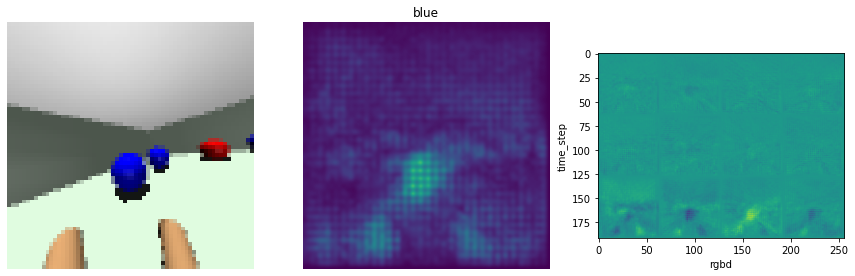

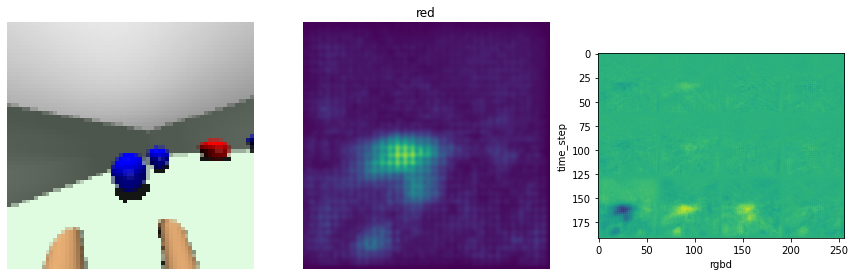

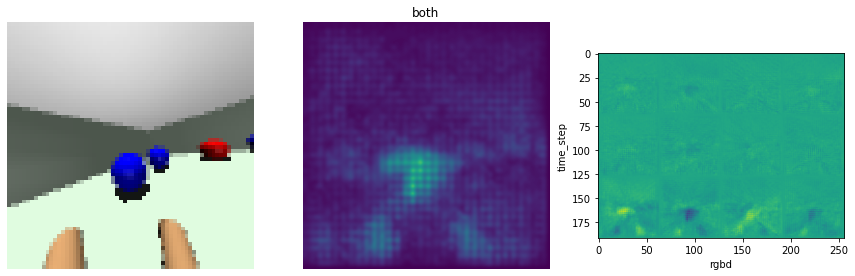

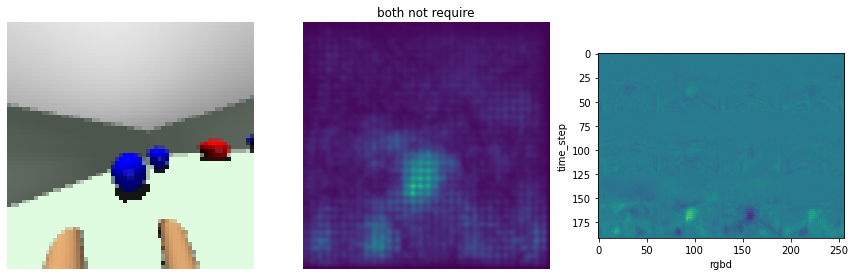

In [10]:
image_id = 210 # np.random.randint(MAX_STEPS)
print("image: ", image_id)

vmax = 0.05

obs_ = torch.tensor([obs_list[image_id]], device=device)
action_ = torch.tensor([action_list[image_id]], device=device)

scale = 0.15
intero_list = [
    ([-scale, 0], "blue"), 
    ([0, -scale], "red"),
    ([-scale, -scale], "both"),
    ([scale, scale], "both not require"),
]

for intero_val in intero_list:
    intero, cond = intero_val
    
    print(intero, cond)
    # get saliency
    sal, full_grad = get_visual_saliency(agent.model,
                                 obs_,
                                 action_,
                                 mode=mode,
                                 intero=intero)
    
    # draw figure
    f_ = frames[image_id][:, :, :3]

    # plt.imshow(f_)
    # plt.imshow(sal_list[i], alpha=.2, cmap="hot", interpolation="nearest", vmax=vmax)

    plt.figure(figsize=(15, 20))
    plt.subplot(131)
    plt.imshow(f_)
    plt.axis('off')

    plt.subplot(132)
    plt.title(cond)
    plt.imshow(sal, interpolation="bicubic", cmap="viridis")    
    plt.axis('off')
    
    plt.subplot(133)
    g = np.vstack([
        np.hstack(full_grad[:4]),
        np.hstack(full_grad[4:8]),
        np.hstack(full_grad[8:12])
    ])
#     g = np.hstack(full_grad[8:12])
    plt.imshow(g, interpolation="bicubic", cmap="viridis")
    plt.ylabel("time_step")
    plt.xlabel("rgbd")



In [3]:
########################################
# Conditioned  Environment
########################################

n_channel = 4
n_frame_stack = 3
im_size = (64, 64)

RADIUS = 5
NUM_FOOD = 6

random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.cuda.manual_seed(seed)

def get_cond_env():
    env_cond = gym.make(
        "conditioned_trp_env:SmallLowGearAntCTRP-v0",
        max_episode_steps=np.inf,
        internal_reset="setpoint",
        n_bins=2,
        sensor_range=0.1,
    )
    env_cond = RescaleAction(env_cond, 0, 1)
    env_cond = VisionEnvWrapper(env_cond, im_size=im_size, n_frame=n_frame_stack, mode="rgbd_array")
    env_cond = pfrl.wrappers.CastObservationToFloat32(env_cond)
    return env_cond

/Users/naotoyoshida/.local/share/virtualenvs/ppo_pfrl-dDkQBMDa/lib/python3.7/site-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


Creating offscreen glfw
tensor([[0., 0.]])
tensor([[0., 0.]])
tensor([[0., 0.]])
tensor([[0., 0.]])
tensor([[0., 0.]])
tensor([[0., 0.]])
tensor([[0., 0.]])
tensor([[0., 0.]])
tensor([[0., 0.]])
tensor([[0., 0.]])


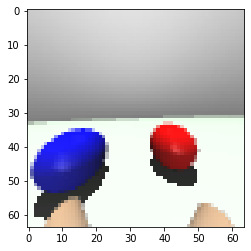

In [23]:
env_cond = get_cond_env()

env_cond.seed(1)

distance = 1.5
action = None
obs = env_cond.reset(initial_internal=(0, 0),
                     object_positions={"blue": [(-1, distance)], "red": [(1, distance)]})

for _ in range(10):
    with torch.no_grad():
        action = agent.act(obs)

    obs, reward, done, info = env_cond.step(action)
    
    _, intero, vision = to_multi_modal(torch.tensor([obs]), im_size=im_size, n_frame=n_frame_stack, n_channel=n_channel)

    vision = env.decode_vision(vision)
    vision = (255. * vision.permute(0, 2, 3, 1)[0].numpy()).astype(np.uint8)
    
    print(intero)
    
plt.imshow(vision[:,:,:4])

/Users/naotoyoshida/.local/share/virtualenvs/ppo_pfrl-dDkQBMDa/lib/python3.7/site-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


Creating offscreen glfw


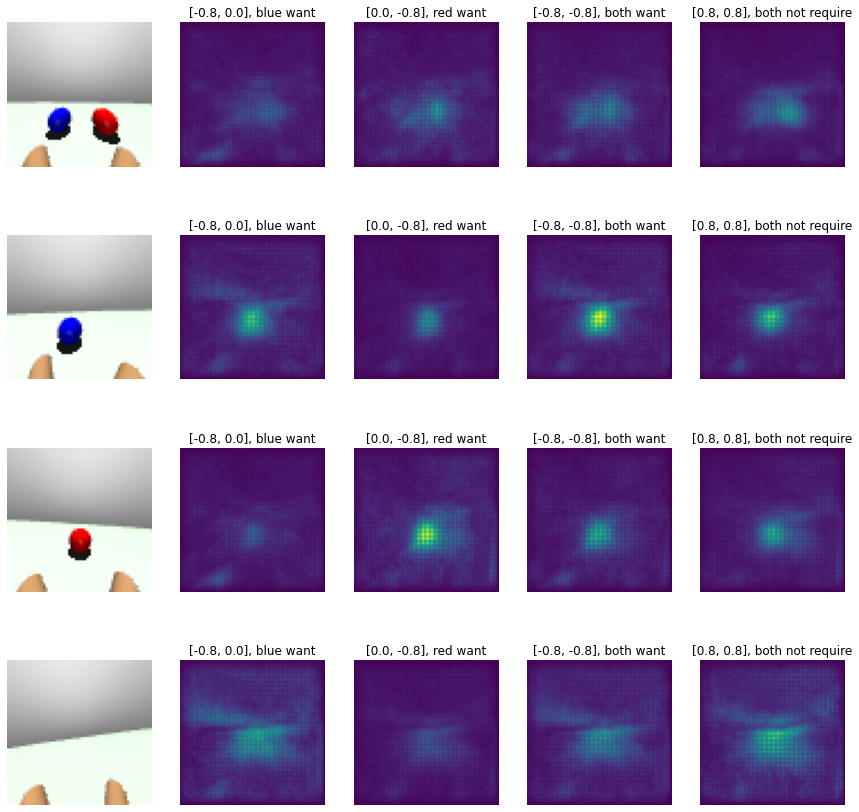

In [109]:
env_cond = get_cond_env()
env_cond.seed(1)

x0, y0, l = 26, 30, 12

distance = 2
action = None

obj_positions = [
    {"blue": [(-1, distance)], "red": [(1, distance)]},
    {"blue": [(0, distance)]},
    {"red": [(0, distance)]},
    {"blue": [(-100, distance)], "red": [(100, distance)]}
]

scale = -0.8
scale_pos  = 0.0
intero_list = [
    ([scale, scale_pos], "blue want"), 
    ([scale_pos, scale], "red want"),
    ([scale, scale], "both want"),
    ([-scale, -scale], "both not require"),
]

n_sample = 50
vmax = 0.06
negpos = False

plt.figure(figsize=(15, 15))
for posid, obj_position in enumerate(obj_positions):
    
    sal_ave_list = [None] * len(intero_list)
    for i in range(n_sample):
        obs = env_cond.reset(initial_internal=(0, 0), object_positions=obj_position)


        for _ in range(5):
            with torch.no_grad():
                action = agent.act(obs)

            obs, reward, done, info = env_cond.step(action)

        _, intero, vision = to_multi_modal(torch.tensor([obs]), im_size=im_size, n_frame=n_frame_stack, n_channel=n_channel)

        vision = env.decode_vision(vision)
        vision = (255. * vision.permute(0, 2, 3, 1)[0].numpy()).astype(np.uint8)

        ############################################
        # Get Saliency
        ############################################

        obs_ = torch.tensor([obs], device=device)
        action_ = torch.tensor([action], device=device)

        for j, intero_val in enumerate(intero_list):
            intero, cond = intero_val

            # get saliency
            sal, full_grad = get_visual_saliency(agent.model,
                                                 obs_,
                                                 action_,
                                                 intero=intero,
                                                 mode="policy",
                                                 negpos=negpos)

            #sal = np.clip(sal, a_min=-vmax, a_max=vmax)
            if sal_ave_list[j] is None:
                sal_ave_list[j] = np.zeros_like(sal)
            sal_ave_list[j] += sal

    # draw figure
    f_ = vision[:, :, :3]
    plt.subplot(len(obj_positions), len(intero_list) + 1, 1 + posid * len(intero_list) + posid)
    plt.imshow(f_)
    plt.axis('off')
    for m, intero_val in enumerate(intero_list):
        sal_ave = sal_ave_list[m] / n_sample

        plt.subplot(len(obj_positions), len(intero_list) + 1, 1 + posid * (len(intero_list) + 1) + m + 1)
        plt.title(f"{intero_val[0]}, {intero_val[1]}")
        if negpos:
            plt.imshow(sal_ave, interpolation="bicubic", cmap="coolwarm", vmax=vmax, vmin=-vmax)
        else:
            plt.imshow(sal_ave, interpolation="bicubic", cmap="viridis", vmax=vmax)    
        plt.axis('off')
        
#         plt.plot([x0, x0+l], [y0, y0], "r")
#         plt.plot([x0, x0+l], [y0+l, y0+l], "r")
#         plt.plot([x0, x0], [y0, y0+l], "r")
#         plt.plot([x0+l, x0+l], [y0, y0+l], "r")

#         plt.subplot(133)
#         g = np.vstack([
#             np.hstack(full_grad[:4]),
#             np.hstack(full_grad[4:8]),
#             np.hstack(full_grad[8:12])
#         ])

#         if negpos:
#             plt.imshow(g, interpolation="bicubic", cmap="coolwarm", vmax=vmax, vmin=-vmax)
#         else:
#             plt.imshow(g, interpolation="bicubic", cmap="viridis", vmax=vmax)    

#         plt.ylabel("time_step")
#         plt.xlabel("rgbd")

plt.show()

## Strength of Visual saliency dependenet on the internal state

In [8]:
# Target area

x0, y0, l = 26, 30, 12
print(sal_ave.shape)
plt.imshow(sal_ave[x0:(x0+l), y0:(y0+l)], interpolation="bicubic", cmap="viridis", vmax=vmax)   
plt.show()

plt.imshow(sal_ave, interpolation="bicubic", cmap="viridis", vmax=vmax)   
plt.plot([x0, x0+l], [y0, y0], "r")
plt.plot([x0, x0+l], [y0+l, y0+l], "r")
plt.plot([x0, x0], [y0, y0+l], "r")
plt.plot([x0+l, x0+l], [y0, y0+l], "r")

NameError: name 'sal_ave' is not defined

In [164]:
x0, y0, l = 26, 30, 12

env_cond = get_cond_env()
env_cond.seed(1)

distance = 2
action = None

obj_positions = [
    {"blue": [(0, distance)]},
    {"red": [(0, distance)]},
    {"blue": [(0, distance)]},
    {"red": [(0, distance)]},
    {},
    {},
]

n_sample = 50
negpos = False

intero_list = [-0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8]
n_intero = len(intero_list)

n_line_sample = 10

data_sal = np.zeros((len(obj_positions), n_line_sample, n_intero, n_sample))  # color, num_lines, num_intero, num_sample

for n_line in tqdm(range(n_line_sample)):
    for posid, obj_position in enumerate(obj_positions):
        for i in range(n_sample):
            redo = True
            while redo:
                obs = env_cond.reset(initial_internal=(0, 0), object_positions=obj_position)

                for _ in range(5):
                    with torch.no_grad():
                        action = agent.act(obs)

                    obs, reward, done, info = env_cond.step(action)

                _, intero, vision = to_multi_modal(torch.tensor([obs]), im_size=im_size, n_frame=n_frame_stack, n_channel=n_channel)

                vision = env.decode_vision(vision)
                vision = (255. * vision.permute(0, 2, 3, 1)[0].numpy()).astype(np.uint8)

                f_ = vision[:, :, :3]
                if np.mean(f_) > 10:
                    redo = False
                

            ############################################
            # Get Saliency
            ############################################

            obs_ = torch.tensor([obs], device=device)
            action_ = torch.tensor([action], device=device)

            for j, intero_val in enumerate(intero_list):
                if posid in {0, 1, 4}:
                    intero = [intero_val, 0.] 
                elif posid in {2, 3, 5}:
                    intero = [0., intero_val]
                
                # get saliency
                sal, full_grad = get_visual_saliency(agent.model,
                                                     obs_,
                                                     action_,
                                                     intero=intero,
                                                     mode="policy",
                                                     negpos=negpos)

                # get the average of the target area
                data_sal[posid, n_line, j, i] = np.mean(sal[x0:(x0+l), y0:(y0+l)])


/Users/naotoyoshida/.local/share/virtualenvs/ppo_pfrl-dDkQBMDa/lib/python3.7/site-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))
  0%|                                                                                                           | 0/10 [00:00<?, ?it/s]

Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [13:51<00:00, 83.14s/it]


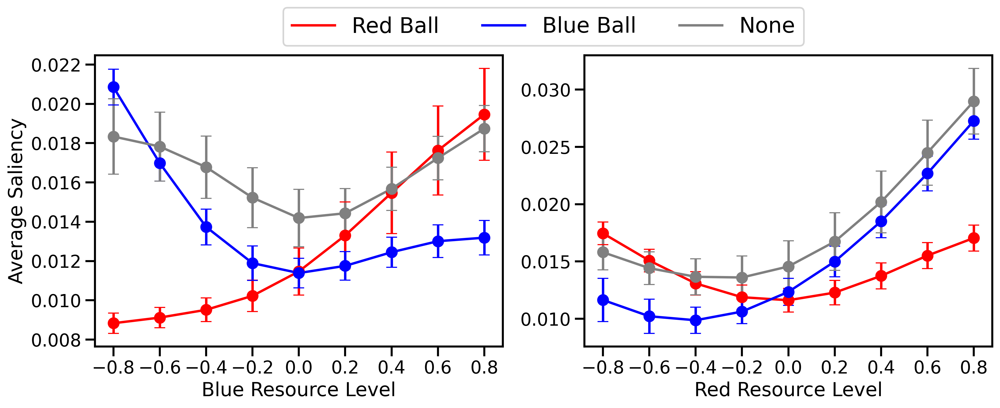

In [170]:
# 0: blue ball - blue intero
# 1: red ball- blue intero
# 2: blue ball- red intero
# 3: red ball- red intero
# 4: no ball- blue intero
# 5: no ball- red intero

sal_ave_b = np.mean(data_sal[0], axis=2)
y_b = np.mean(sal_ave_b, axis=0)
yerr_b = np.std(sal_ave_b, axis=0)

sal_ave_rb = np.mean(data_sal[1], axis=2)
y_rb = np.mean(sal_ave_rb, axis=0)
yerr_rb = np.std(sal_ave_rb, axis=0)

sal_ave_br = np.mean(data_sal[2], axis=2)
y_br = np.mean(sal_ave_br, axis=0)
yerr_br = np.std(sal_ave_br, axis=0)

sal_ave_r = np.mean(data_sal[3], axis=2)
y_r = np.mean(sal_ave_r, axis=0)
yerr_r = np.std(sal_ave_r, axis=0)

sal_ave_gb = np.mean(data_sal[4], axis=2)
y_gb = np.mean(sal_ave_gb, axis=0)
yerr_gb = np.std(sal_ave_gb, axis=0)

sal_ave_gr = np.mean(data_sal[5], axis=2)
y_gr = np.mean(sal_ave_gr, axis=0)
yerr_gr = np.std(sal_ave_gr, axis=0)


plt.figure(figsize=(15, 5), dpi=300)
plt.subplot(121)

plt.errorbar(intero_list, y_rb, yerr=yerr_rb, c="r", capsize=5, fmt='o', markersize=10)
plt.plot(intero_list, y_rb, "r", markersize=10)

plt.errorbar(intero_list, y_b, yerr=yerr_b, c="b", capsize=5, fmt='o', markersize=10)
plt.plot(intero_list, y_b, "b", markersize=10)

plt.errorbar(intero_list, y_gb, yerr=yerr_gb, c="gray", capsize=5, fmt='o', markersize=10)
plt.plot(intero_list, y_gb, "gray", markersize=10)

plt.xticks(intero_list)
plt.legend(["Red Ball", "Blue Ball", "None"],
           bbox_to_anchor=(1.1, 1.2), loc='upper center', ncol=4, prop={'size': 20})
plt.xlabel("Blue Resource Level")
plt.ylabel("Average Saliency")


plt.subplot(122)

plt.errorbar(intero_list, y_r, yerr=yerr_r, c="r", capsize=5, fmt='o', markersize=10)
plt.plot(intero_list, y_r, "r", markersize=10)

plt.errorbar(intero_list, y_br, yerr=yerr_br, c="b", capsize=5, fmt='o', markersize=10)
plt.plot(intero_list, y_br, "b", markersize=10)

plt.errorbar(intero_list, y_gr, yerr=yerr_gr, c="gray", capsize=5, fmt='o', markersize=10)
plt.plot(intero_list, y_gr, "gray", markersize=10)

plt.xticks(intero_list)
#plt.legend(["red ball", "blue ball"])
plt.xlabel("Red Resource Level")

plt.show()

In [166]:
np.save("data_sal.npy", data_sal)

# Calculate the interoception-average saliency map

In [167]:
x0, y0, l = 26, 30, 12

env_cond = get_cond_env()
env_cond.seed(100)

distance = 2
action = None

obj_positions = [
    {"blue": [(0, distance)]},
    {"red": [(0, distance)]},
    {}, # no ball in the vision
]

n_sample = 50
negpos = False

intero_list = [-0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8]
n_intero = len(intero_list)

n_point_sample = 10

data_sal_map = np.zeros((3, n_point_sample, n_intero, n_intero, n_sample))  # color, num_lines, num_intero, num_sample

for n_point in tqdm(range(n_point_sample)):
    for posid, obj_position in enumerate(obj_positions):
        for i in range(n_sample):
            redo = True
            while redo:
                obs = env_cond.reset(initial_internal=(0, 0), object_positions=obj_position)

                for _ in range(5):
                    with torch.no_grad():
                        action = agent.act(obs)

                    obs, reward, done, info = env_cond.step(action)

                _, intero, vision = to_multi_modal(torch.tensor([obs]), im_size=im_size, n_frame=n_frame_stack, n_channel=n_channel)

                vision = env.decode_vision(vision)
                vision = (255. * vision.permute(0, 2, 3, 1)[0].numpy()).astype(np.uint8)

                f_ = vision[:, :, :3]
                if np.mean(f_) > 10:
                    redo = False
                

            ############################################
            # Get Saliency
            ############################################

            obs_ = torch.tensor([obs], device=device)
            action_ = torch.tensor([action], device=device)

            for j, intero_val_b in enumerate(intero_list):
                for k, intero_val_r in enumerate(intero_list):
                    intero = [intero_val_b, intero_val_r] 
                    
                    # get saliency
                    sal, full_grad = get_visual_saliency(agent.model,
                                                         obs_,
                                                         action_,
                                                         intero=intero,
                                                         mode="policy",
                                                         negpos=negpos)

                    # get the average of the target area
                    data_sal_map[posid, n_point, j, k, i] = np.mean(sal[x0:(x0+l), y0:(y0+l)])

print(data_sal_map)

/Users/naotoyoshida/.local/share/virtualenvs/ppo_pfrl-dDkQBMDa/lib/python3.7/site-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))
  0%|                                                                                                           | 0/10 [00:00<?, ?it/s]

Creating offscreen glfw


100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [38:10<00:00, 229.06s/it]

[[[[[0.01267948 0.00602641 0.03285633 ... 0.06718816 0.0041834
     0.02271041]
    [0.01413627 0.0068459  0.03938476 ... 0.06107929 0.0034714
     0.02352167]
    [0.01543192 0.00789532 0.04761593 ... 0.05512245 0.00467096
     0.02477258]
    ...
    [0.02017188 0.02269361 0.07974603 ... 0.04448358 0.00840723
     0.05339758]
    [0.02610733 0.02933349 0.08554503 ... 0.04605592 0.01428258
     0.06864413]
    [0.03372157 0.03712954 0.08842259 ... 0.04862897 0.02105014
     0.08375122]]

   [[0.00802529 0.00745041 0.03161475 ... 0.06561833 0.00404395
     0.01743808]
    [0.00913785 0.00750304 0.03860201 ... 0.05795078 0.00578257
     0.01754117]
    [0.01014318 0.00685744 0.04743125 ... 0.0502457  0.00743559
     0.01802605]
    ...
    [0.01812165 0.0219337  0.08490746 ... 0.0396438  0.00934431
     0.05301398]
    [0.02541064 0.02881113 0.09134732 ... 0.04218424 0.01608212
     0.07021766]
    [0.03326819 0.03676387 0.09490016 ... 0.04568492 0.02356981
     0.08624032]]

   [[0.004

In [168]:
np.save("data_sal_map.npy", data_sal_map)

Text(-8, -3, 'Blue Resource Level')

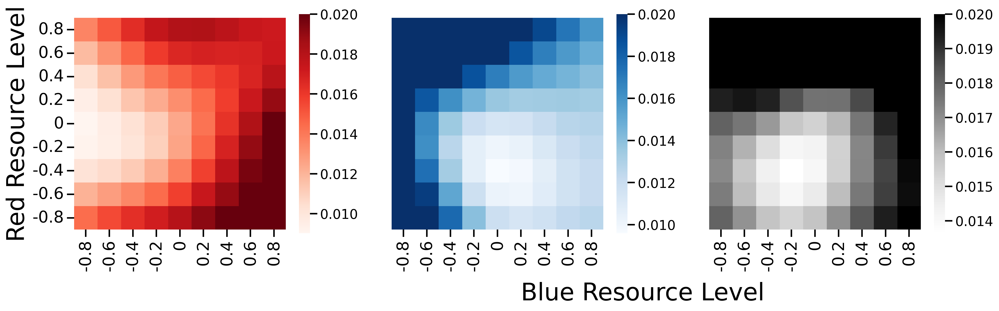

In [169]:
sal_ave_map_b = np.mean(data_sal_map[0], axis=3)
y_map_b = np.mean(sal_ave_map_b, axis=0).transpose()

sal_ave_map_r = np.mean(data_sal_map[1], axis=3)
y_map_r = np.mean(sal_ave_map_r, axis=0).transpose()

sal_ave_map_g = np.mean(data_sal_map[2], axis=3)
y_map_g = np.mean(sal_ave_map_g, axis=0).transpose()

#########################################
# Red matrix
#########################################
plt.figure(figsize=(20, 5), dpi=300)

plt.subplot(1, 3, 1)
ax = sns.heatmap(y_map_r,
                 cmap="Reds", 
                 square=True,
                 vmax=0.02, #0.015,
                 xticklabels=intero_list,
                 yticklabels=intero_list)
ax.invert_yaxis()
ax.set_ylabel("Red Resource Level", fontsize=30)
plt.tick_params(labelsize=20)


#########################################
# Blue matrix
#########################################
plt.subplot(1, 3, 2)
ax =sns.heatmap(y_map_b,
                cmap="Blues", 
                square=True,
                vmax=0.02, #0.015,
                xticklabels=intero_list,
                yticklabels=[])
ax.invert_yaxis()
plt.tick_params(labelsize=20)

#########################################
# Gray matrix
#########################################
plt.subplot(1, 3, 3)
ax =sns.heatmap(y_map_g,
                cmap="Greys", 
                square=True,
                vmax=0.02, #0.015,
                xticklabels=intero_list,
                yticklabels=[])
ax.invert_yaxis()
plt.tick_params(labelsize=20)


plt.text(x=-8, y=-3, s="Blue Resource Level", fontsize=30)

Text(-15, -3, 'Blue Resource Level')

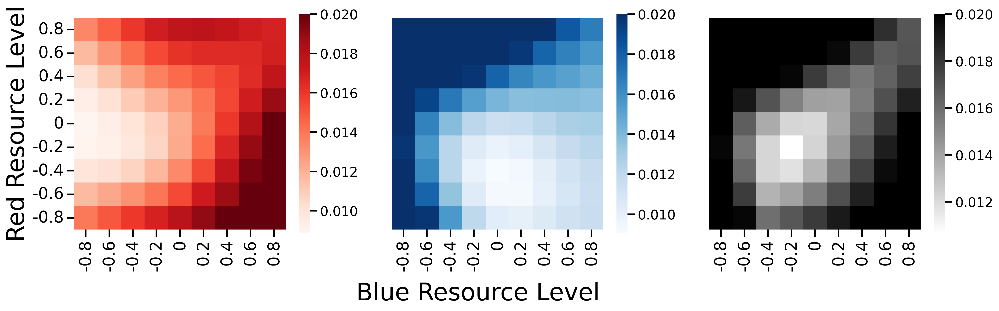

In [157]:
sal_ave_map_b = np.mean(data_sal_map[0], axis=3)
y_map_b = np.mean(sal_ave_map_b, axis=0).transpose()

sal_ave_map_r = np.mean(data_sal_map[1], axis=3)
y_map_r = np.mean(sal_ave_map_r, axis=0).transpose()

#########################################
# Red matrix
#########################################
plt.figure(figsize=(20, 5), dpi=300)

plt.subplot(1, 3, 1)
ax = sns.heatmap(y_map_r,
                 cmap="Reds", #"binary_r",
                 square=True,
                 vmax=0.02,
                 xticklabels=intero_list,
                 yticklabels=intero_list)
ax.invert_yaxis()
ax.set_ylabel("Red Resource Level", fontsize=30)
plt.tick_params(labelsize=20)


#########################################
# Blue matrix
#########################################
plt.subplot(1, 3, 2)
ax =sns.heatmap(y_map_b,
                cmap="Blues", #"binary_r",
                square=True,
                vmax=0.02,
                xticklabels=intero_list,
                yticklabels=[])
ax.invert_yaxis()
plt.tick_params(labelsize=20)

plt.subplot(1, 3, 3)

max_intensity = np.maximum(y_map_r, y_map_b)

ax = sns.heatmap(max_intensity,
                 cmap="binary",
                 square=True,
                 vmax=0.02,
                 xticklabels=intero_list,
                 yticklabels=[])
ax.invert_yaxis()
plt.tick_params(labelsize=20)

#ax.set_xlabel("Blue Resource Level", fontsize=30, labelpad=10)
plt.text(x=-15, y=-3, s="Blue Resource Level", fontsize=30)


# Analysis of Internal State

In [8]:
import numpy as np
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

MAX_STEPS = 20000

### Sampling

In [318]:
seed = 0
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.cuda.manual_seed(seed)
env.seed(seed)


frames = []
obs_list = []
action_list = []
intero_list = []
latent1_list = []
latent2_list = []
vision_embed_list = []
prop_list = []

obs = env.reset()
for i in tqdm(range(MAX_STEPS)):
    with torch.no_grad():
        action = agent.act(obs)
        latent1 = agent.model.feature(torch.tensor([obs], device=device), layer=1)
        latent2 = agent.model.feature(torch.tensor([obs], device=device), layer=2)
        vision_embed = agent.model.feature_vision(torch.tensor([obs], device=device))

    obs_list.append(deepcopy(obs))
    action_list.append(deepcopy(action))
    latent1_list.append(latent1[0])
    latent2_list.append(latent2[0])
    vision_embed_list.append(vision_embed[0])
    
    prop, intero, vision = to_multi_modal(torch.tensor([obs]), im_size=im_size, n_frame=n_frame_stack, n_channel=n_channel)

    intero_list.append(intero.numpy()[0].tolist())
    prop_list.append(prop.numpy()[0].tolist())

    vision = env.decode_vision(vision)
    vision = (255. * vision.permute(0, 2, 3, 1)[0].numpy()).astype(np.uint8)
    frames.append(vision)

    obs, reward, done, info = env.step(action)
    
    if done:
        break

intero_list = np.array(intero_list)
prop_list = np.array(prop_list)

latent1 = torch.stack(latent1_list).cpu().numpy()
latent2 = torch.stack(latent2_list).cpu().numpy()
vision_embed = torch.stack(vision_embed_list).cpu().numpy()

np.save("latent1_is2", latent1)
np.save("latent2_is2", latent2)

np.save("vision_embed_is2", vision_embed)

np.save("intero_list_is2", intero_list)
np.save("prop_list_is2", prop_list)

np.save("frames_is2", frames)


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [11:47<00:00, 28.29it/s]


In [ ]:
vision_embed.shape

In [ ]:
print(latent1.shape)
print(latent2.shape)

print(intero_list.shape)
print(prop_list.shape)

intero = np.array(intero_list)
plt.figure(figsize=(12, 4), dpi=300)
plt.plot(intero_list[:, 0], color="b")
plt.plot(intero_list[:, 1], color="r")
plt.xlabel("Time Step", fontsize=30)
plt.ylabel("Nutritional State", fontsize=30)
plt.ylim([-0.5, 0.5])
plt.xlim([0, MAX_STEPS])
#plt.xticks([10000 * i for i in range(5)])
plt.yticks([-0.5, -0.25, 0, 0.25, 0.5])
plt.tick_params(labelsize=25)
plt.legend(["Blue Resource", "Red Resource"],
           loc='lower right', ncol=4, prop={'size': 20})

plt.savefig(f"trp_vision{MAX_STEPS}.png", bbox_inches='tight')

30


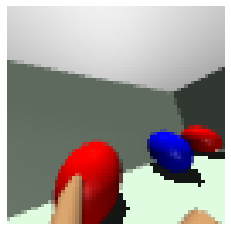

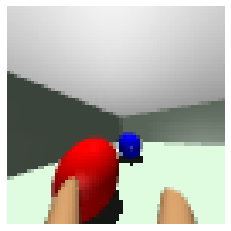

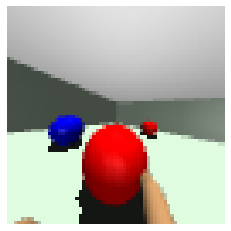

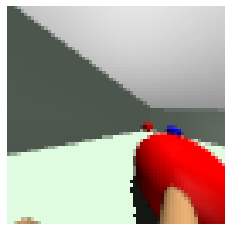

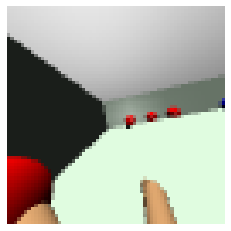

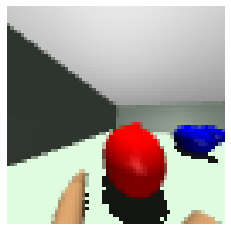

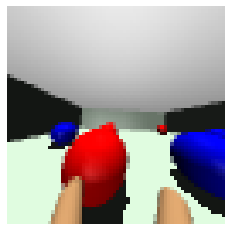

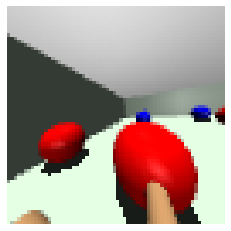

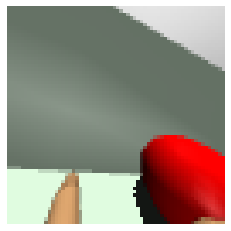

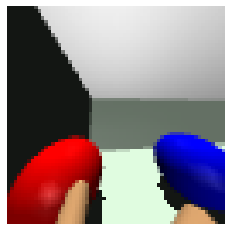

In [55]:
food_t = []

food = 1 # 0 for blue, 1 for red

diff_i = np.array(intero_list[1:, food]) - np.array(intero_list[:-1, food])
diff_i = diff_i > 0
print(diff_i.sum())

f_tmp = []
for i in range(MAX_STEPS - 1):
    if diff_i[i]:
        f_tmp.append(frames[i - 3])

for i in range(10):
    j = np.random.randint(len(f_tmp))
    plt.imshow(f_tmp[j][:, :, -4:-1])
    plt.axis("off")
    plt.show()

(10000, 2) [0.         0.01010101 0.02020202 ... 0.97979798 0.98989899 1.        ]


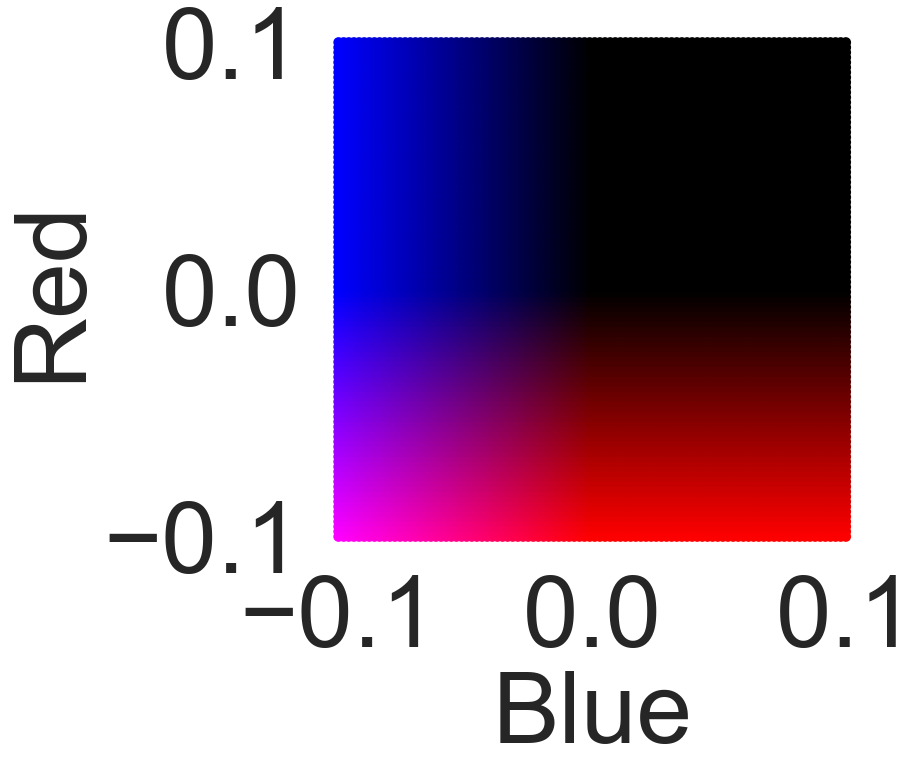

(20000, 300) (20000, 2) 20000


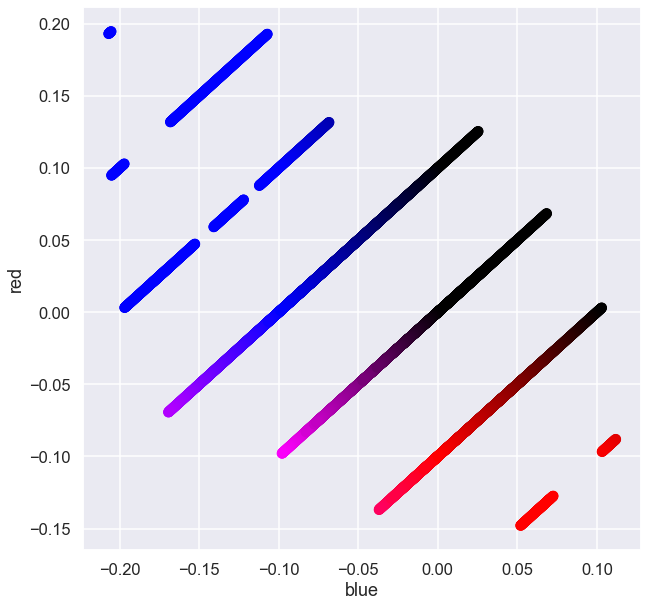

In [319]:
# Color Space

# latent1 = np.load("latent1_is.npy")
# latent2 = np.load("latent2_is.npy")
# vision_embed = np.load("vision_embed_is.npy")
# intero_list = np.load("intero_list_is.npy")
# frames = np.load("frames_is.npy")

latent1 = np.load("latent1_is2.npy")
latent2 = np.load("latent2_is2.npy")
vision_embed = np.load("vision_embed_is2.npy")
intero_list = np.load("intero_list_is2.npy")
frames = np.load("frames_is2.npy")
prop_list = np.load("prop_list_is2.npy")

# convert color
scale_color = 0.1

# def color_convert(blue, red):
# #     b = np.max([1 - 1.5 * blue, 0])
# #     r = np.max([1 - 1.5 * red, 0])
#     b = blue < 0.1
#     r = red < 0.1
    
#     if blue < red and red < 0.5:
#         r = 0

#     if blue > red and blue < 0.5:
#         b = 0

#     return (r, 0, b, 1)


def color_convert(blue, red):
    b = np.max([1 - 2 * blue, 0])
    r = np.max([1 - 2 * red, 0])
    return (r, 0, b, 1)

# example data
x_ = np.linspace(0, 1, 100)
y_ = np.linspace(0, 1, 100)
xx, yy = np.meshgrid(x_, y_)
xx = xx.flatten()
yy = yy.flatten()
tmp = np.array([xx, yy]).transpose()
#sns.set_style("white", {'axes.grid' : False})
#plt.axis("off")
print(tmp.shape, xx)

c_sample = [color_convert(v[0], v[1]) for v in tmp]

plt.figure(figsize=(10, 10))
plt.scatter(2 * scale_color * (xx - 0.5), 2 * scale_color *  (yy - 0.5), c=c_sample)
plt.xlabel("Blue", fontsize=100)
plt.ylabel("Red", fontsize=100)
plt.yticks([-scale_color, 0, scale_color], fontsize=100)
plt.xticks([-scale_color, 0, scale_color], fontsize=100)
plt.box(False)
plt.show()

# real data
# scale to 0~1 range
intero_list_ = 0.5 * (np.clip(intero_list, -scale_color, scale_color) + scale_color) / scale_color

c = [color_convert(v[0], v[1]) for v in intero_list_]

print(latent1.shape, intero_list.shape, len(c))

plt.figure(figsize=(10, 10))
plt.scatter(intero_list[:, 0],
            intero_list[:, 1], c=c)
plt.xlabel("blue")
plt.ylabel("red")
plt.show()

# TSNE Embedding 

In [329]:
from sklearn.manifold import TSNE

### 2d embed

In [330]:
vision_embed2d = TSNE(n_components=2, learning_rate="auto", init="pca").fit_transform(vision_embed)

/Users/naotoyoshida/.local/share/virtualenvs/ppo_pfrl-dDkQBMDa/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


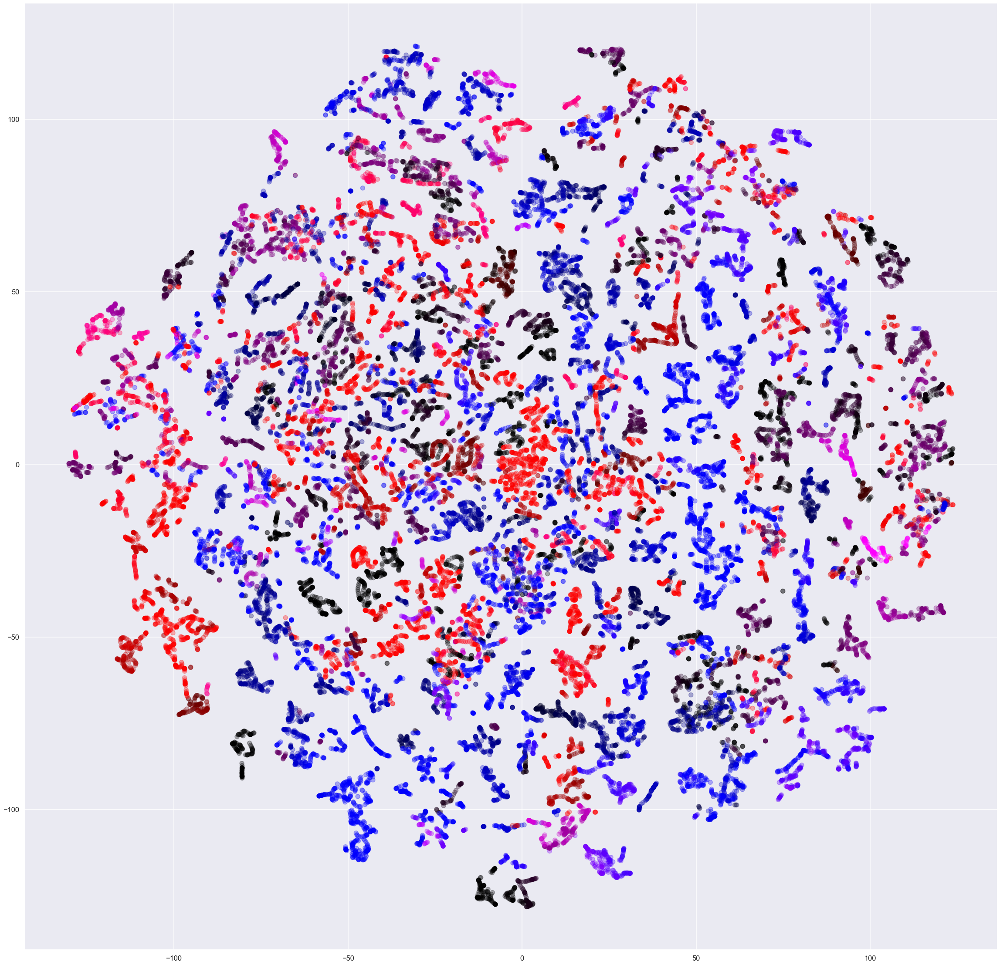

In [402]:
fig, ax = plt.subplots(figsize=(40, 40))

plt.scatter(vision_embed2d[:, 0], vision_embed2d[:, 1], c=c, s=100, alpha=0.3)
plt.show()

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39999/39999 [00:15<00:00, 2611.26it/s]


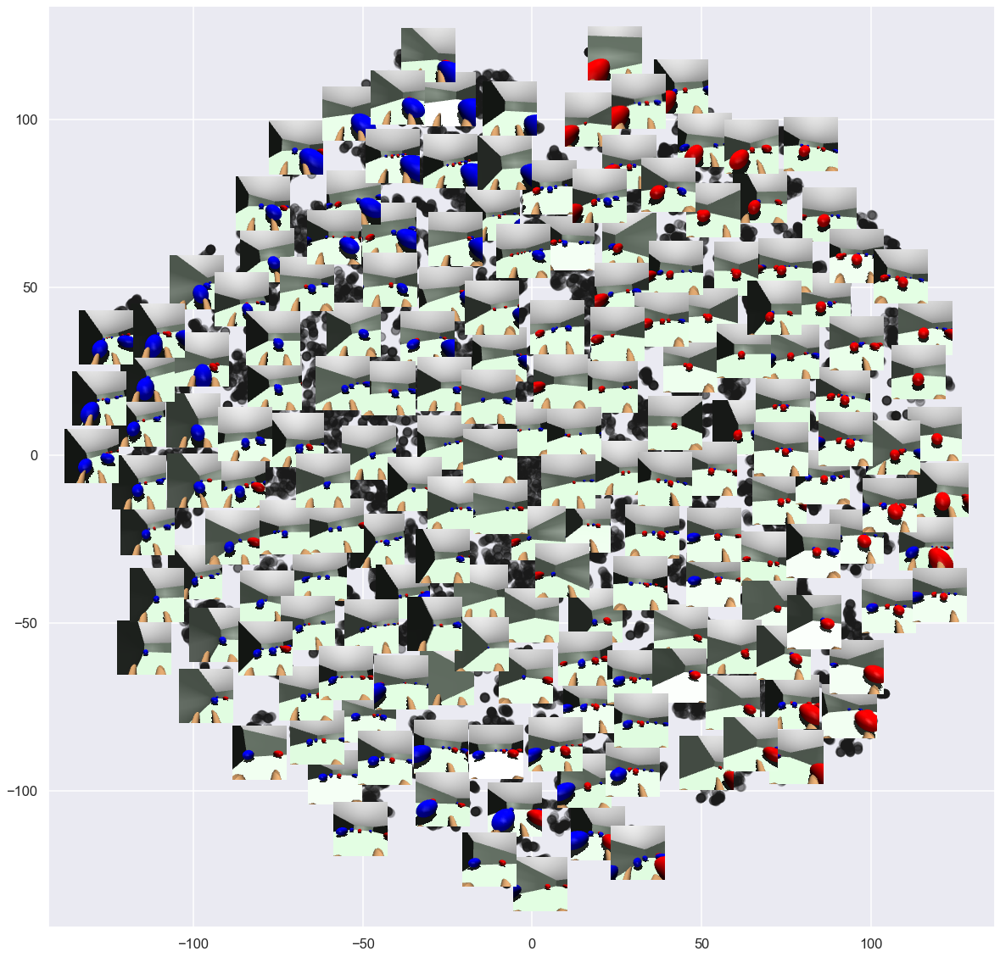

In [406]:
fig, ax = plt.subplots(figsize=(20, 20))

d_limit = 13

points_exist = []
artists = []
index_ = np.arange(MAX_STEPS - 1)
np.random.shuffle(index_)
for i in tqdm(index_):
    x, y = vision_embed2d[i, 0], vision_embed2d[i, 1]
    
    draw_ = True
    for point in points_exist:
        x_, y_ = point[0], point[1]
        
        if (x - x_)**2 + (y - y_)**2 < d_limit**2:
            draw_ = False
            break
            
    if draw_:
        im = OffsetImage(frames[i][:, :, -4:-1])
        ab = AnnotationBbox(im,
                            (x, y),
                            xycoords='data',
                            frameon=False)
        ax.add_artist(ab)
        points_exist.append((x, y))

plt.scatter(vision_embed2d[:, 0], vision_embed2d[:, 1], c="k", s=100, alpha=0.2)
plt.show()

In [333]:
latent1_embed2d = TSNE(n_components=2, learning_rate="auto", init="pca").fit_transform(latent1)

/Users/naotoyoshida/.local/share/virtualenvs/ppo_pfrl-dDkQBMDa/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


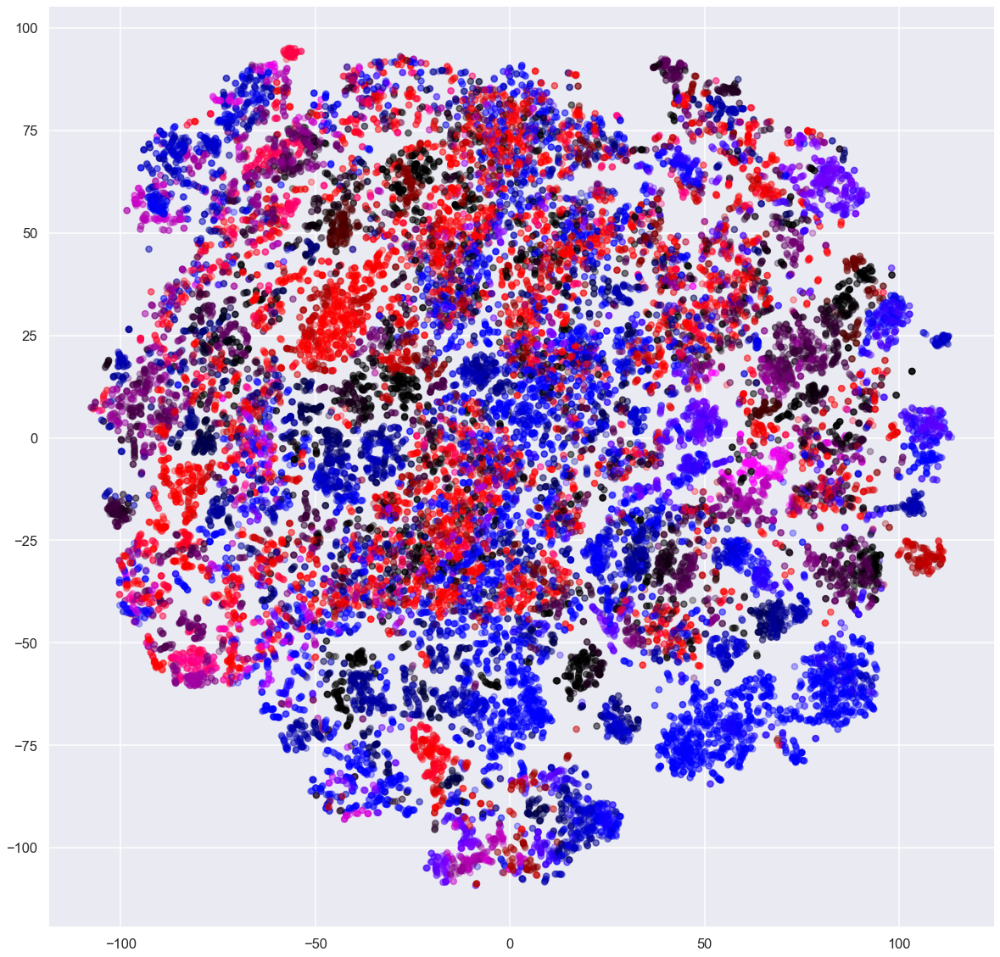

In [403]:
fig, ax = plt.subplots(figsize=(20, 20))

plt.scatter(latent1_embed2d[:, 0], latent1_embed2d[:, 1], c=c, s=50, alpha=0.3)
plt.show()

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39999/39999 [00:10<00:00, 3759.27it/s]


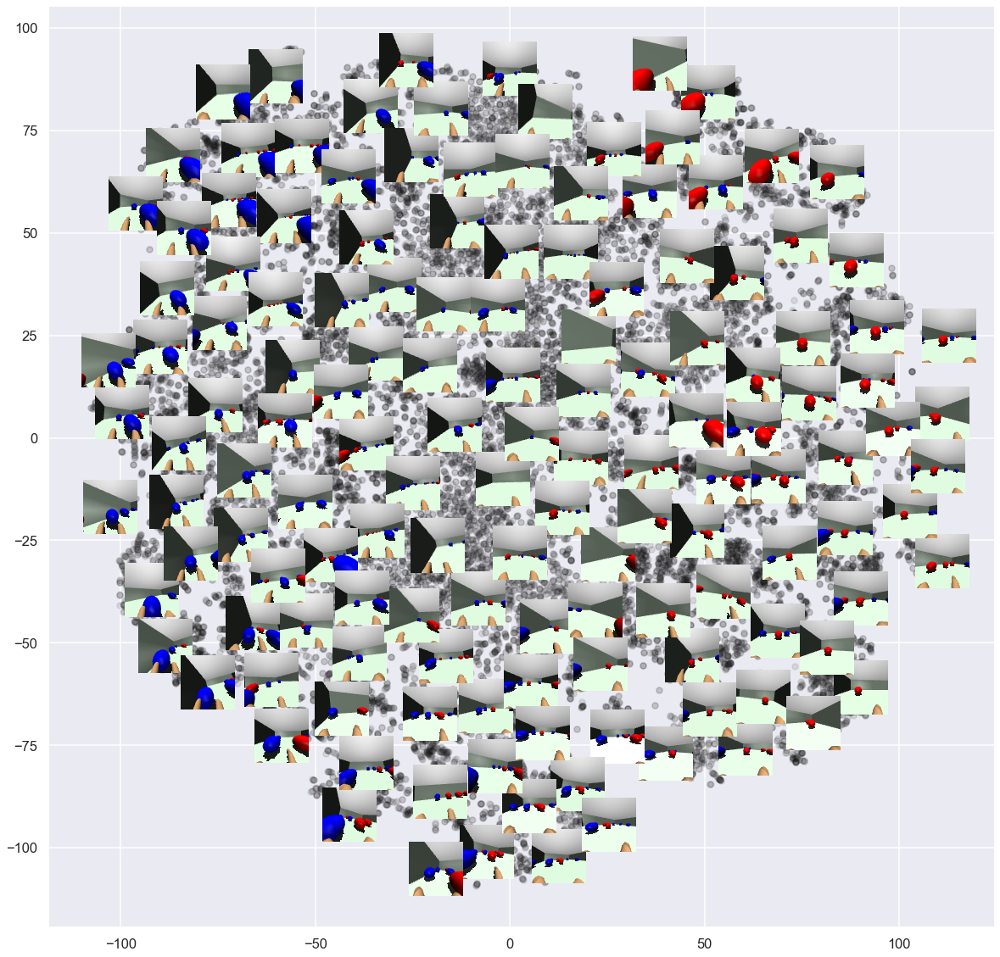

In [405]:
fig, ax = plt.subplots(figsize=(20, 20))

d_limit = 13

points_exist = []
artists = []
index_ = np.arange(MAX_STEPS - 1)
np.random.shuffle(index_)
for i in tqdm(index_):
    x, y = latent1_embed2d[i, 0], latent1_embed2d[i, 1]
    
    draw_ = True
    for point in points_exist:
        x_, y_ = point[0], point[1]
        
        if (x - x_)**2 + (y - y_)**2 < d_limit**2:
            draw_ = False
            break
            
    if draw_:
        im = OffsetImage(frames[i][:, :, -4:-1])
        ab = AnnotationBbox(im,
                            (x, y),
                            xycoords='data',
                            frameon=False)
        ax.add_artist(ab)
        points_exist.append((x, y))

plt.scatter(latent1_embed2d[:, 0], latent1_embed2d[:, 1], c="k", s=50, alpha=0.1)
plt.show()

### save video with nutritional state

  0%|                                                                                                                                                  | 0/20000 [00:00<?, ?it/s]/var/folders/hj/0xdmrh_n62n8g8c4lhb6085w0000gn/T/ipykernel_14709/1703235410.py:28: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
  0%|▎                                                                                                                                        | 42/20000 [00:02<21:14, 15.66it/s]


KeyboardInterrupt: 

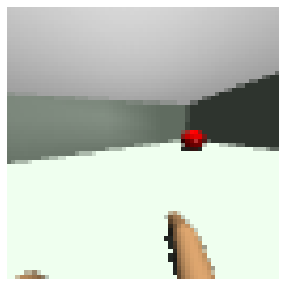

In [295]:
TEST_STEPS = 1000
save_every = 4000
FPS = 120

video_index = 0
frames_vi = []
for i in tqdm(range(MAX_STEPS)):      
    # draw figure
    f_ = frames[i][:, :, -4:-1]
    
    fig = plt.figure(figsize=(13, 5), frameon=False)
    plt.subplot(121)
    plt.imshow(f_)
    plt.axis('off')

    plt.subplot(122)
    plt.plot([-0.3, 0.3], [0, 0], "gray", alpha=0.1, linewidth=1)
    plt.plot([0, 0], [-0.25, 0.3], "gray", alpha=0.1, linewidth=1)
    plt.scatter(intero_list[::10, 0], intero_list[::10, 1], c=c[::10], alpha=0.3, s=1)
    plt.scatter(intero_list[i, 0], intero_list[i, 1], c=[c[i]], s=100)    
    plt.ylim([-0.3, 0.3])
    plt.xlim([-0.3, 0.3])
    plt.ylabel("Red")
    plt.xlabel("Blue")
    
    fig.canvas.draw()

    data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
    data = data.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    
    plt.clf()
    plt.close()
    
    frames_vi.append(data)
    
    # record periodically
    if (i % save_every == 0 and i != 0) or (i == MAX_STEPS - 1):
        frames_vi = np.array(frames_vi)

        print("get anim...")
        anim = display_video(frames_vi, FPS)
        print("get writer...")
        writervideo = animation.FFMpegWriter(fps=FPS)
        print("saving...")
        s = f'ecocentroc_vision_intero_{i}.mp4'
        anim.save(s, writer=writervideo)
        print(f"done. : {s}")
        
        frames_vi = []
        video_index += 1

print("all done.")

### pca plot time series

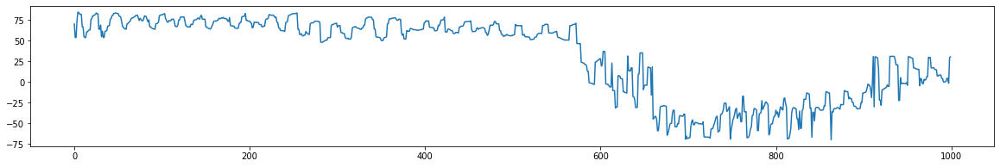

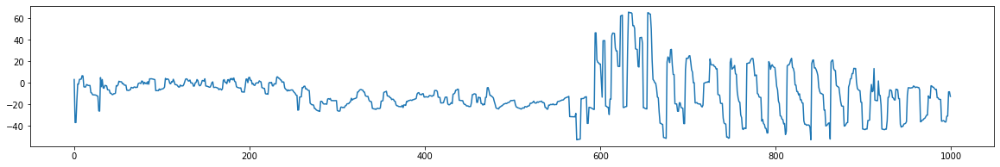

In [63]:
plt.figure(figsize=(20, 3), frameon=False)
plt.plot(latent1_embed2d[:1000, 0])
plt.show()

plt.figure(figsize=(20, 3), frameon=False)
plt.plot(latent1_embed2d[:1000, 1])
plt.show()

In [41]:
print(latent1_embed.min(), latent_embed.max())

-95.28125 102.11496


# PCA Embedding

[0.25445017 0.18700796 0.10977735 0.06988307 0.05703204 0.05258629
 0.02560391 0.02152141 0.01915956 0.01593602]
[0.2749214  0.16313955 0.14844744 0.06145643 0.04646216 0.04349805
 0.02934976 0.02289524 0.01853518 0.01533325]


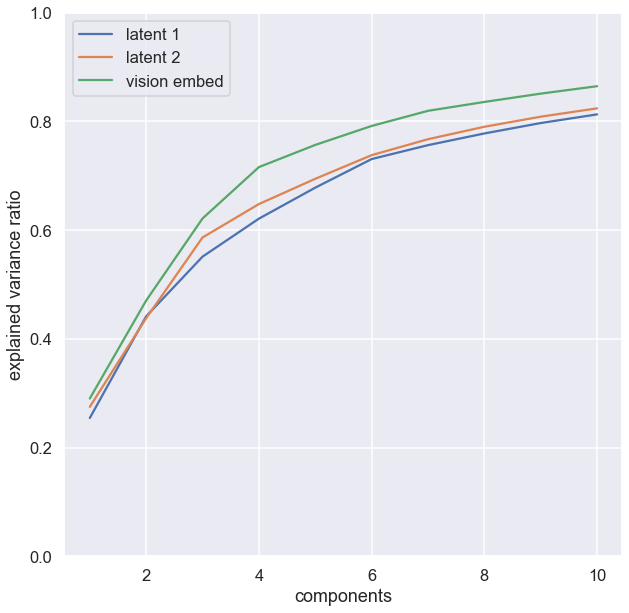

In [320]:
from sklearn.decomposition import PCA

pca_l1 = PCA(n_components=10)
pca_l1.fit(latent1)
embed_pca_l1 = pca_l1.transform(latent1)

pca_l2 = PCA(n_components=10)
pca_l2.fit(latent2)
embed_pca_l2 = pca_l2.transform(latent2)

pca_v = PCA(n_components=10)
pca_v.fit(vision_embed)
embed_pca_v = pca_v.transform(vision_embed)

plt.figure(figsize=(10, 10))
x = range(1, 11)
y = [np.sum(pca_l1.explained_variance_ratio_[:i]) for i in range(11)][1:]
print(pca_l1.explained_variance_ratio_)
plt.plot(x, y)
#plt.scatter(x, y)

y = [np.sum(pca_l2.explained_variance_ratio_[:i]) for i in range(11)][1:]
print(pca_l2.explained_variance_ratio_)
plt.plot(x, y)
#plt.scatter(x, y)

y = [np.sum(pca_v.explained_variance_ratio_[:i]) for i in range(11)][1:]
plt.plot(x, y)
#plt.scatter(x, y)
plt.ylabel("explained variance ratio")
plt.xlabel("components")
plt.ylim([0, 1])

plt.legend(["latent 1", "latent 2","vision embed"])


### 2D embed

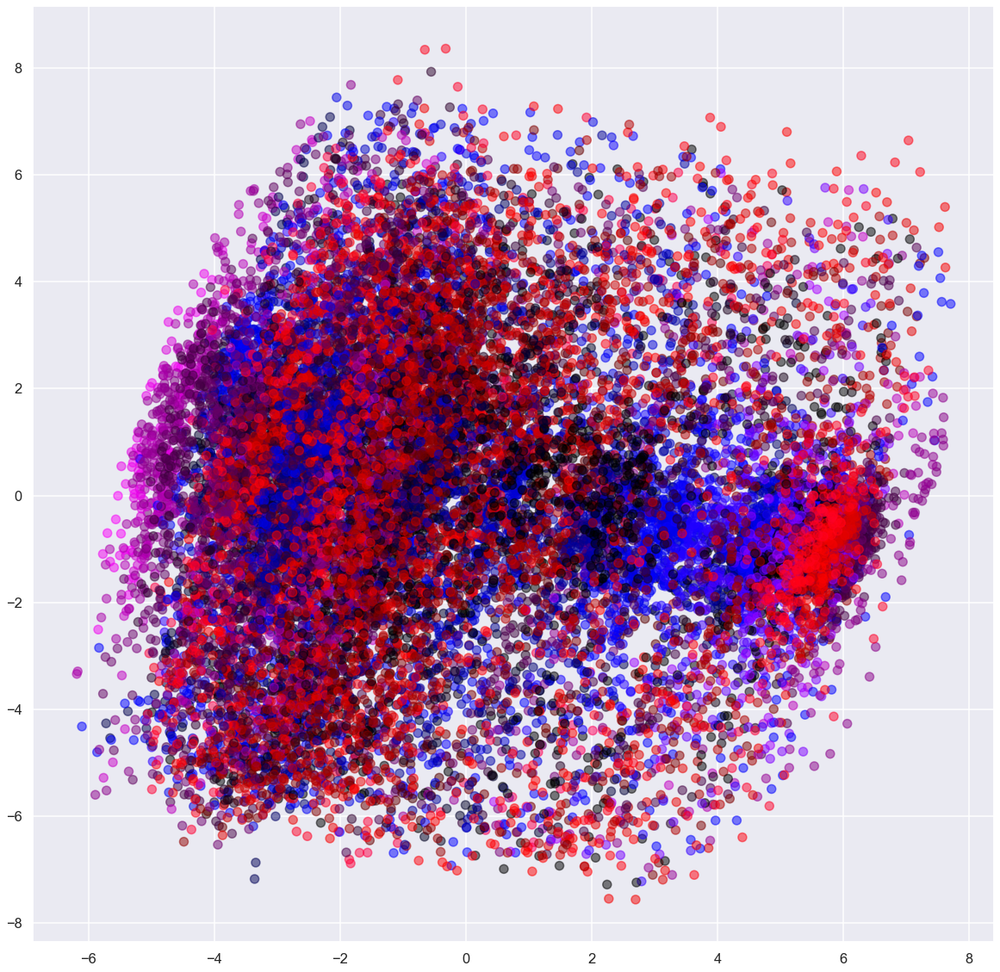

In [321]:
fig, ax = plt.subplots(figsize=(20, 20))
plt.scatter(embed_pca_l1[:, 0], embed_pca_l1[:, 1], c=c, s=100, alpha=0.5)
#plt.axis("off")
plt.show()

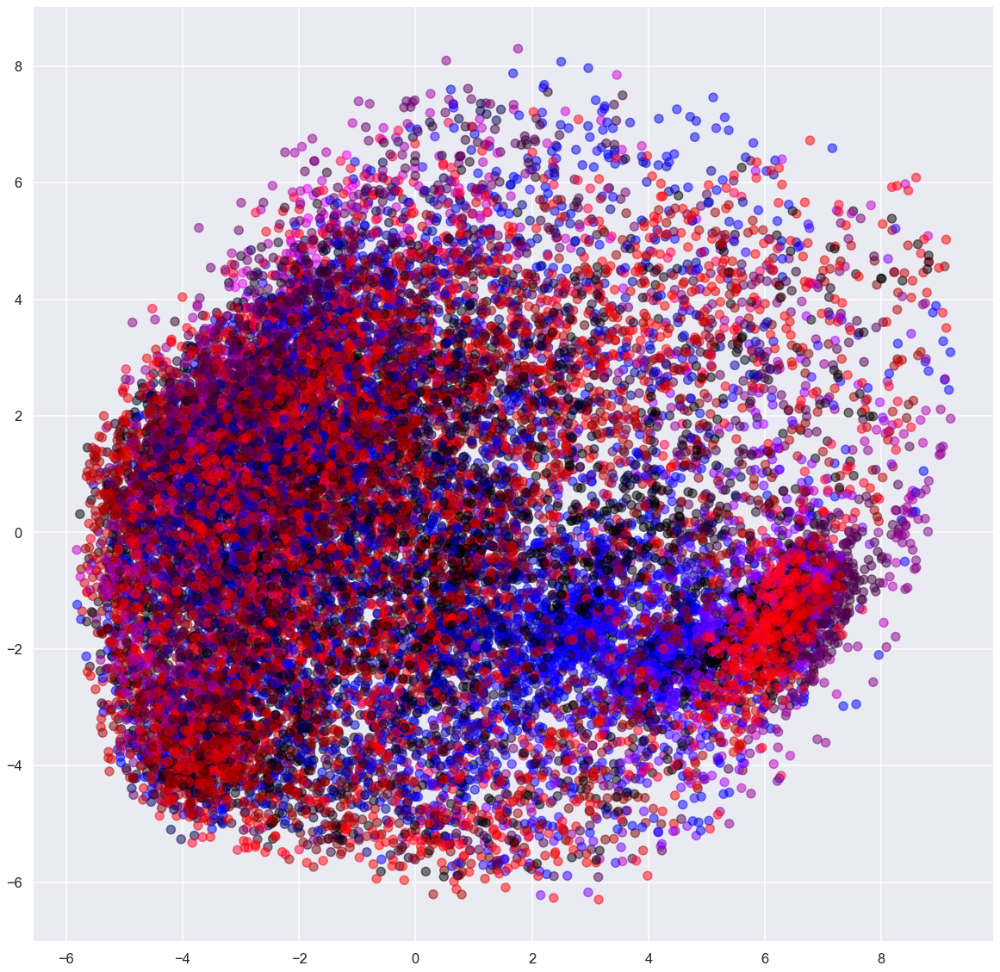

In [322]:
fig, ax = plt.subplots(figsize=(20, 20))
plt.scatter(embed_pca_l2[:, 0], embed_pca_l2[:, 1], c=c, s=100, alpha=0.5)
#plt.axis("off")
plt.show()

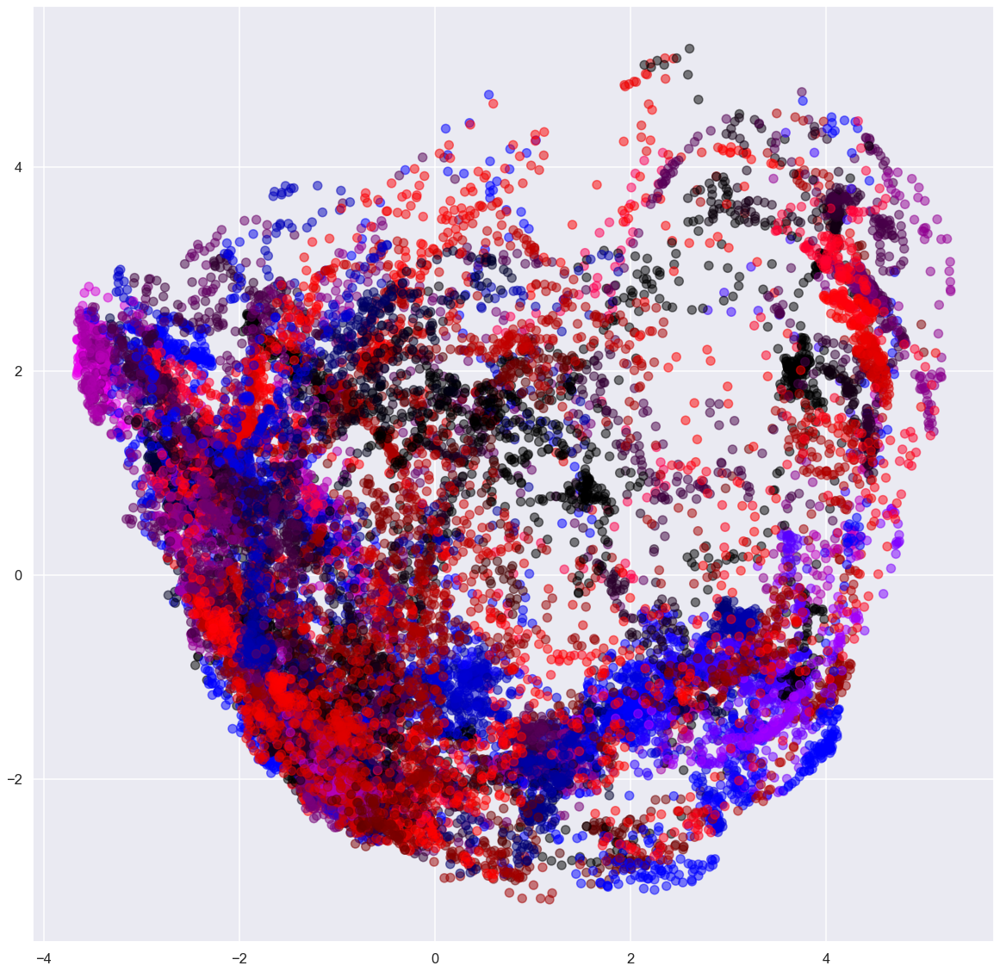

In [323]:
fig, ax = plt.subplots(figsize=(20, 20))
plt.scatter(embed_pca_v[:, 0], embed_pca_v[:, 1], c=c, s=100, alpha=0.5)
#plt.axis("off")
plt.show()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19999/19999 [00:01<00:00, 12385.06it/s]


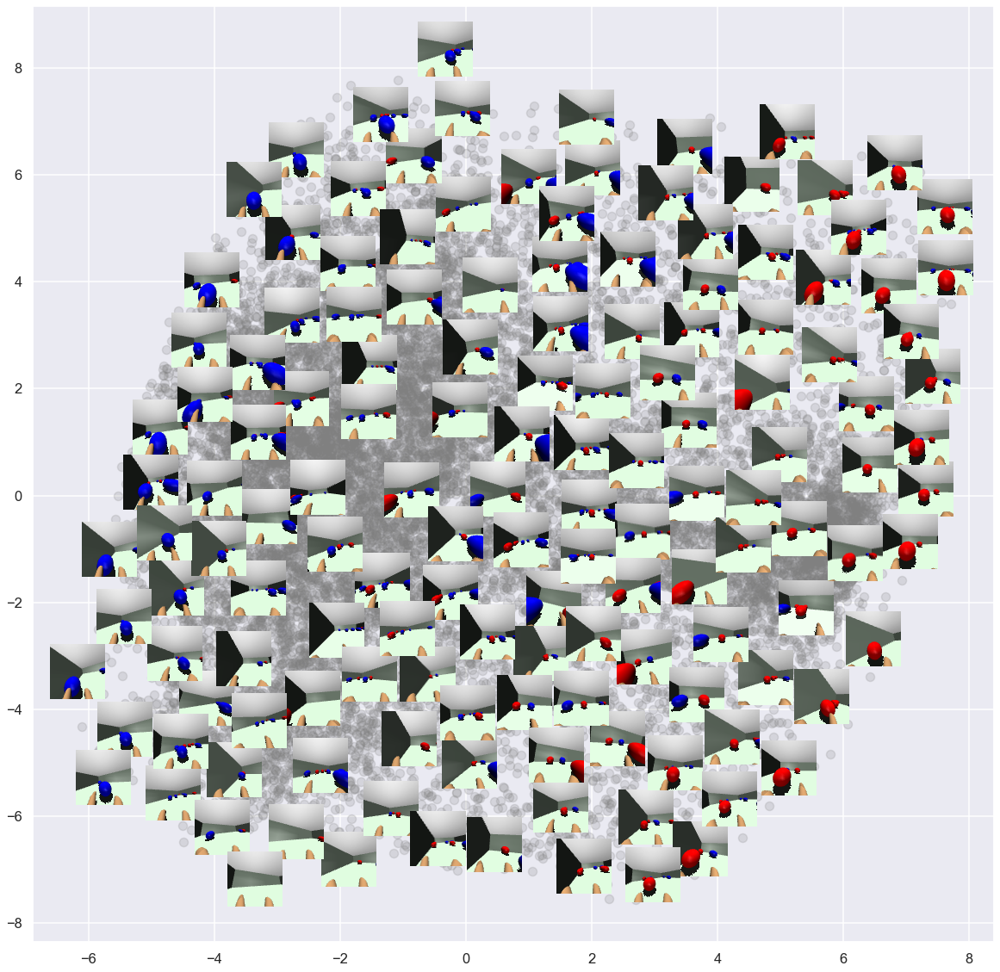

In [324]:
fig, ax = plt.subplots(figsize=(20, 20))

d_limit = 0.9

x_axis_pc = 0
y_axis_pc = 1

points_exist = []
artists = []

index_ = np.arange(MAX_STEPS - 1)
np.random.shuffle(index_)
for i in tqdm(index_):
    x, y = embed_pca_l1[i, x_axis_pc], embed_pca_l1[i, y_axis_pc]
    
#     draw_ = False
#     if  intero_list[i][1] < -0.2 and intero_list[i][0] > 0.1:
#         draw_ = True
    
    draw_ = True
    for point in points_exist:
        x_, y_ = point[0], point[1]
        
        if (x - x_)**2 + (y - y_)**2 < d_limit**2:
            draw_ = False
            break        
            
    if draw_:
        im = OffsetImage(frames[i][:, :, -4:-1])
        ab = AnnotationBbox(im,
                            (x, y),
                            xycoords='data',
                            frameon=False)
        ax.add_artist(ab)
        points_exist.append((x, y))

plt.scatter(embed_pca_l1[:, x_axis_pc], embed_pca_l1[:, y_axis_pc], color="gray", s=100, alpha=0.2)
#plt.axis("off")
# plt.xlabel(f"PC{x_axis_pc + 1}")
# plt.ylabel(f"PC{y_axis_pc + 1}")
plt.show()

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19999/19999 [00:00<00:00, 799697.65it/s]


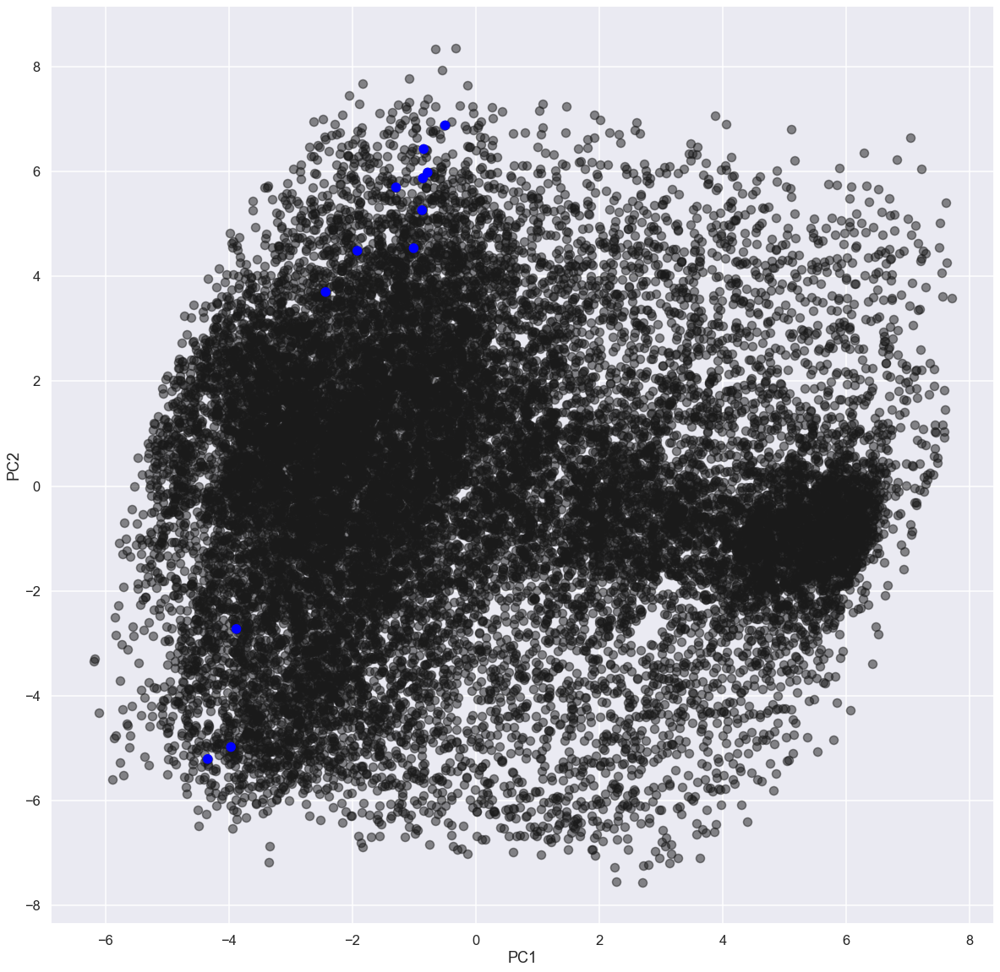

In [325]:
fig, ax = plt.subplots(figsize=(20, 20))

d_limit = 0.9

points_exist = []
index_ = np.arange(MAX_STEPS - 1)
np.random.shuffle(index_)
for i in tqdm(index_):
    x, y = embed_pca_l1[i, 0], embed_pca_l1[i, 1]
    
    # filter
    draw_ = False
    if  intero_list[i][0] < -0.2 and intero_list[i][1] > 0.1:
        draw_ = True  

    if  intero_list[i][1] < -0.2 and intero_list[i][0] > 0.1:
        draw_ = True  

#     if  intero_list[i][0] < -0.15 and intero_list[i][1] < -0.15:
#         draw_ = True  
            
    if draw_:
        points_exist.append((x, y, c[i]))

x_ = [v[0] for v in points_exist]
y_ = [v[1] for v in points_exist]
c_ = [v[2] for v in points_exist]

plt.scatter(embed_pca_l1[:, 0], embed_pca_l1[:, 1], c="k", s=100, alpha=0.5)
plt.scatter(x_, y_, c=c_, s=100, alpha=1)
#plt.axis("off")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.show()

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19999/19999 [00:00<00:00, 643942.53it/s]


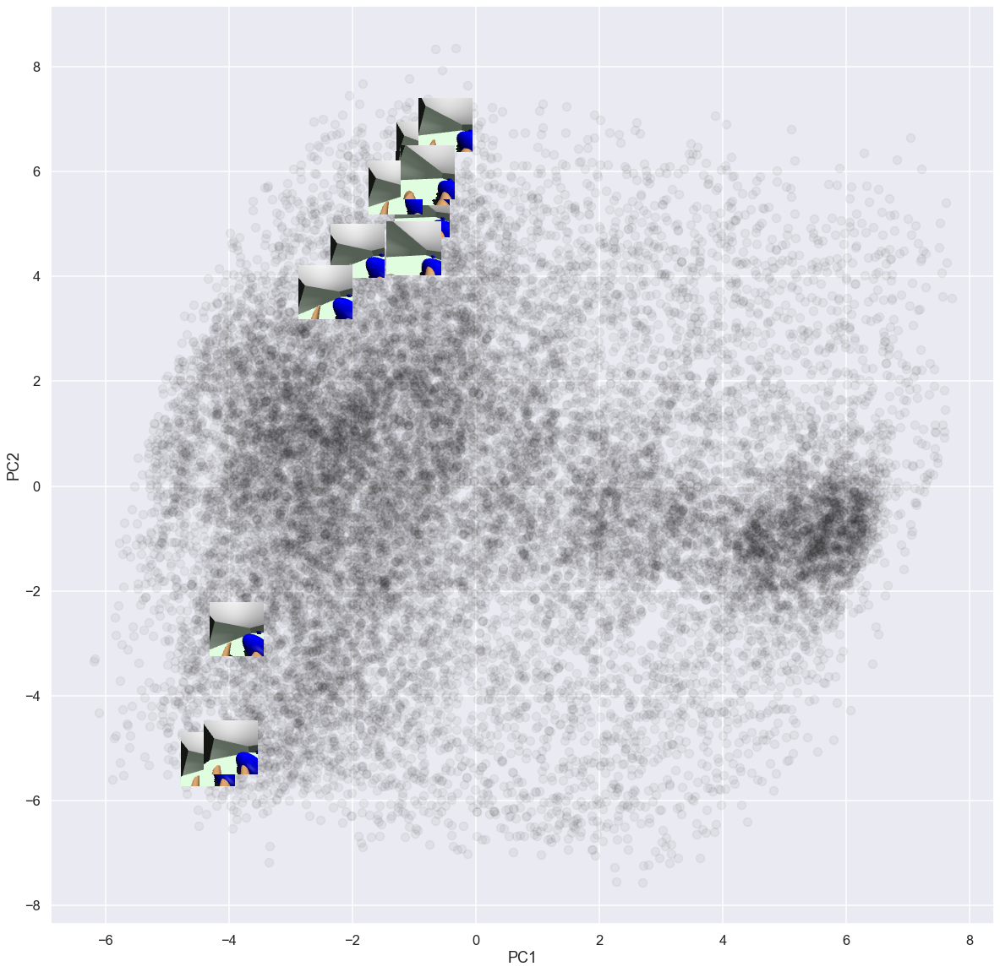

In [326]:
fig, ax = plt.subplots(figsize=(20, 20))

d_limit = 0.9

points_exist = []
index_ = np.arange(MAX_STEPS - 1)
np.random.shuffle(index_)
for i in tqdm(index_):
    x, y = embed_pca_l1[i, 0], embed_pca_l1[i, 1]
    
    # filter
    draw_ = False
    if  intero_list[i][0] < -0.2 and intero_list[i][1] > 0.1:
        draw_ = True  

    if  intero_list[i][1] < -0.2 and intero_list[i][0] > 0.1:
        draw_ = True  

#     if  intero_list[i][0] < -0.15 and intero_list[i][1] < -0.15:
#         draw_ = True  
            
    if draw_:
        im = OffsetImage(frames[i][:, :, -4:-1])
        ab = AnnotationBbox(im,
                            (x, y),
                            xycoords='data',
                            frameon=False)
        ax.add_artist(ab)
        
        points_exist.append((x, y, c[i]))

x_ = [v[0] for v in points_exist]
y_ = [v[1] for v in points_exist]
c_ = [v[2] for v in points_exist]

plt.scatter(embed_pca_l1[:, 0], embed_pca_l1[:, 1], c="k", s=100, alpha=0.05)
plt.scatter(x_, y_, c=c_, s=100, alpha=0.5)
#plt.axis("off")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.show()

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19999/19999 [00:00<00:00, 879818.39it/s]


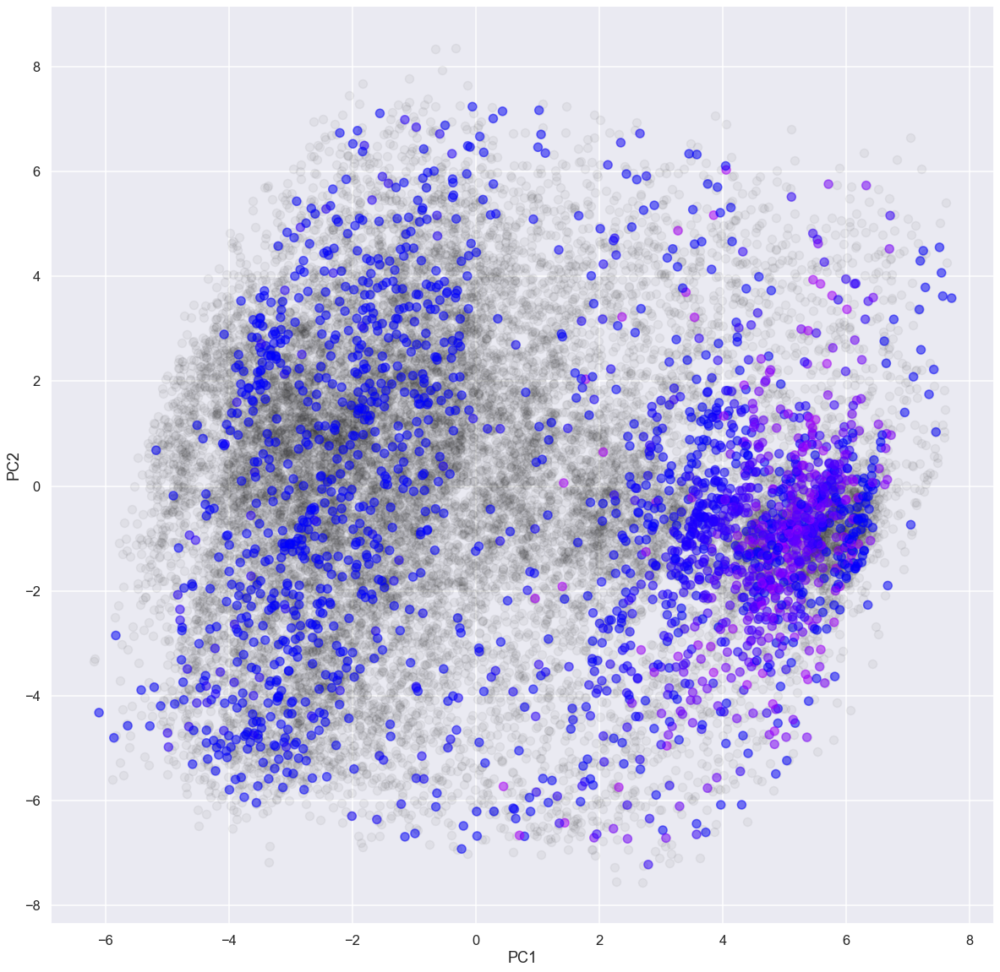

In [327]:
fig, ax = plt.subplots(figsize=(20, 20))

d_limit = 0.9

points_exist = []
index_ = np.arange(MAX_STEPS - 1)
np.random.shuffle(index_)
for i in tqdm(index_):
    x, y = embed_pca_l1[i, 0], embed_pca_l1[i, 1]
    
    # filter
    draw_ = False
    if  intero_list[i][0] < -0.1 and intero_list[i][1] > -0.1:
        draw_ = True  
            
    if draw_:
        points_exist.append((x, y, c[i]))

x_ = [v[0] for v in points_exist]
y_ = [v[1] for v in points_exist]
c_ = [v[2] for v in points_exist]

plt.scatter(embed_pca_l1[:, 0], embed_pca_l1[:, 1], c="k", s=100, alpha=0.05)
plt.scatter(x_, y_, c=c_, s=100, alpha=0.5)
#plt.axis("off")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.show()

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19999/19999 [00:00<00:00, 930459.85it/s]


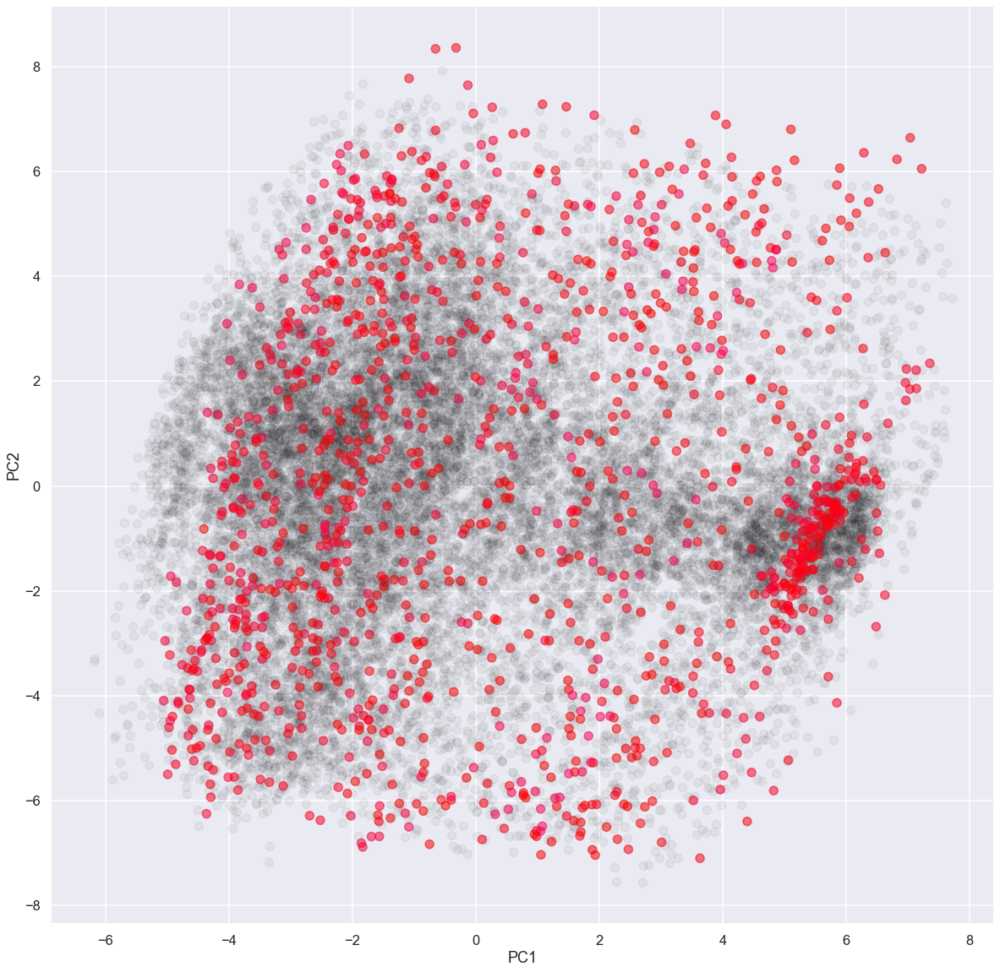

In [328]:
fig, ax = plt.subplots(figsize=(20, 20))

d_limit = 0.9

points_exist = []
index_ = np.arange(MAX_STEPS - 1)
np.random.shuffle(index_)
for i in tqdm(index_):
    x, y = embed_pca_l1[i, 0], embed_pca_l1[i, 1]
    
    # filter
    draw_ = False
    if  intero_list[i][1] < -0.1 and intero_list[i][0] > -0.1:
        draw_ = True  
            
    if draw_:
        points_exist.append((x, y, c[i]))

x_ = [v[0] for v in points_exist]
y_ = [v[1] for v in points_exist]
c_ = [v[2] for v in points_exist]

plt.scatter(embed_pca_l1[:, 0], embed_pca_l1[:, 1], c="k", s=100, alpha=0.05)
plt.scatter(x_, y_, c=c_, s=100, alpha=0.5)
#plt.axis("off")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.show()

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19999/19999 [00:02<00:00, 8918.57it/s]


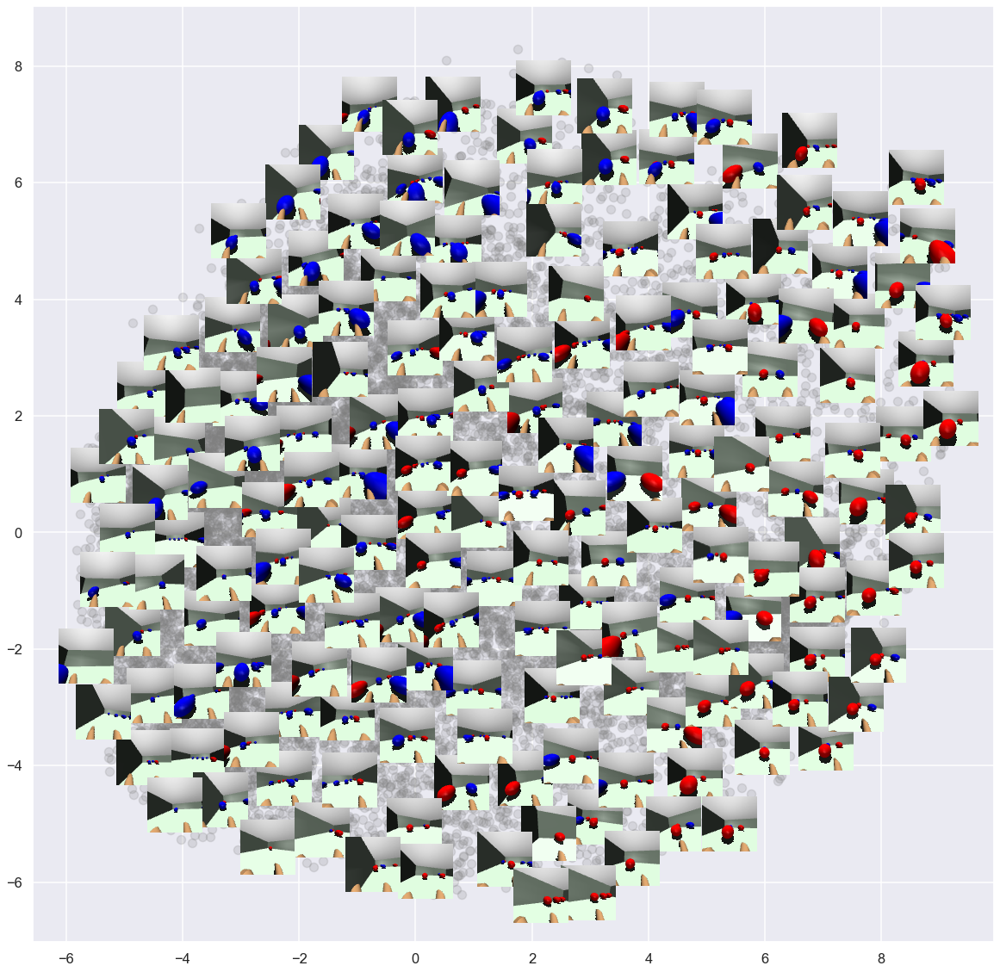

In [329]:
fig, ax = plt.subplots(figsize=(20, 20))

d_limit = 0.8

points_exist = []
artists = []
index_ = np.arange(MAX_STEPS - 1)
np.random.shuffle(index_)
for i in tqdm(index_):
    x, y = embed_pca_l2[i, 0], embed_pca_l2[i, 1]
    
#     # red want
#     draw_ = False
#     if  intero_list[i][0] < -0.15 and intero_list[i][1] < -0.15:
#         draw_ = True
    
#     # blue want
#     if  intero_list[i][1] > 0.1 and intero_list[i][0] < -0.2:
#         draw_ = True
    
    draw_ = True
    for point in points_exist:
        x_, y_ = point[0], point[1]
        
        if (x - x_)**2 + (y - y_)**2 < d_limit**2:
            draw_ = False
            break
            
    if draw_:
        im = OffsetImage(frames[i][:, :, -4:-1])
        ab = AnnotationBbox(im,
                            (x, y),
                            xycoords='data',
                            frameon=False)
        ax.add_artist(ab)
        points_exist.append((x, y))

plt.scatter(embed_pca_l2[:, 0], embed_pca_l2[:, 1], c="gray", s=100, alpha=0.2)
#plt.axis("off")
# plt.xlabel("PC1")
# plt.ylabel("PC2")
plt.show()

0.32262152 0.2696702
2.377346 -5.893872
5.5976033 5.7587295
2876 178 108


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19999/19999 [00:00<00:00, 140831.21it/s]


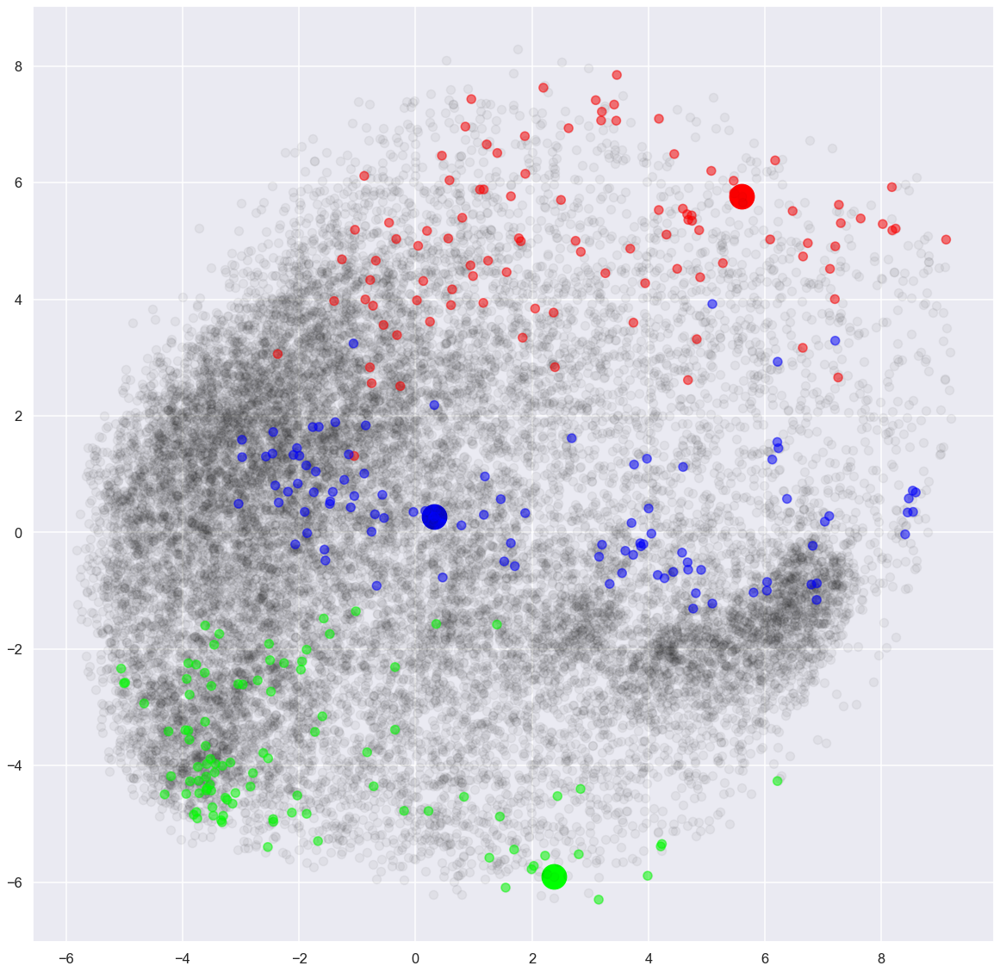

In [336]:
from copy import copy

fig, ax = plt.subplots(figsize=(20, 20))

N = 100
thresh = 0.5
cols = [(1,0,0), (0,1,0),(0,0,1)]

index_ = np.arange(MAX_STEPS - 1)

points_exist = [[],[],[]]
d_list = [[], [], []]

# pick up three reference points manually
i_0, i_1, i_2 = None, None, None
for i in index_:
    x, y = embed_pca_l2[i, 0], embed_pca_l2[i, 1]
    
    if i_0 is None and np.abs(x - 6) < thresh and np.abs(y - 6) < thresh:
        print(x, y)
        plt.scatter(x, y, color=(1,0,0), s=800, alpha=1)
        i_0 = copy(i)
    
    if i_1 is None and np.abs(x - 2) < thresh and np.abs(y + 6) < thresh:
        print(x, y)
        plt.scatter(x, y, color=(0,1,0), s=800, alpha=1)
        i_1 = copy(i)

    if i_2 is None and np.abs(x - 0) < thresh and np.abs(y - 0) < thresh:
        print(x, y)
        plt.scatter(x, y, color=(0,0,1), s=800, alpha=1)
        i_2 = copy(i)
        
    if i_0 is not None and i_1 is not None and i_2 is not None:
        break

print(i_0, i_1, i_2)

#0, 100, ?
ref_p = [prop_list[i_0],
         prop_list[i_1],
         prop_list[i_2]]


# Calc proprooceptive distance from the referene points
for i in tqdm(index_):
    
    p = prop_list[i]
    
    for j in range(3):
        d_list[j].append(np.linalg.norm(p - ref_p[j]))

index = []
for k in range(3):
    index.append(np.array(d_list[k]).argsort()[:N])

for i in range(3):
    for j in index[i]:
        x, y = embed_pca_l2[j, 0], embed_pca_l2[j, 1]
        points_exist[i].append((x, y, cols[i]))

x_, y_, c_ = [], [], []
for i in range(3):
    x_ += [v[0] for v in points_exist[i]]
    y_ += [v[1] for v in points_exist[i]]
    c_ += [v[2] for v in points_exist[i]]

plt.scatter(embed_pca_l2[:, 0], embed_pca_l2[:, 1], c="k", s=100, alpha=0.05)
plt.scatter(x_, y_, c=c_, s=100, alpha=0.5)
#plt.axis("off")
#plt.xlabel("PC1")
#plt.ylabel("PC2")
plt.show()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19999/19999 [00:01<00:00, 11978.40it/s]


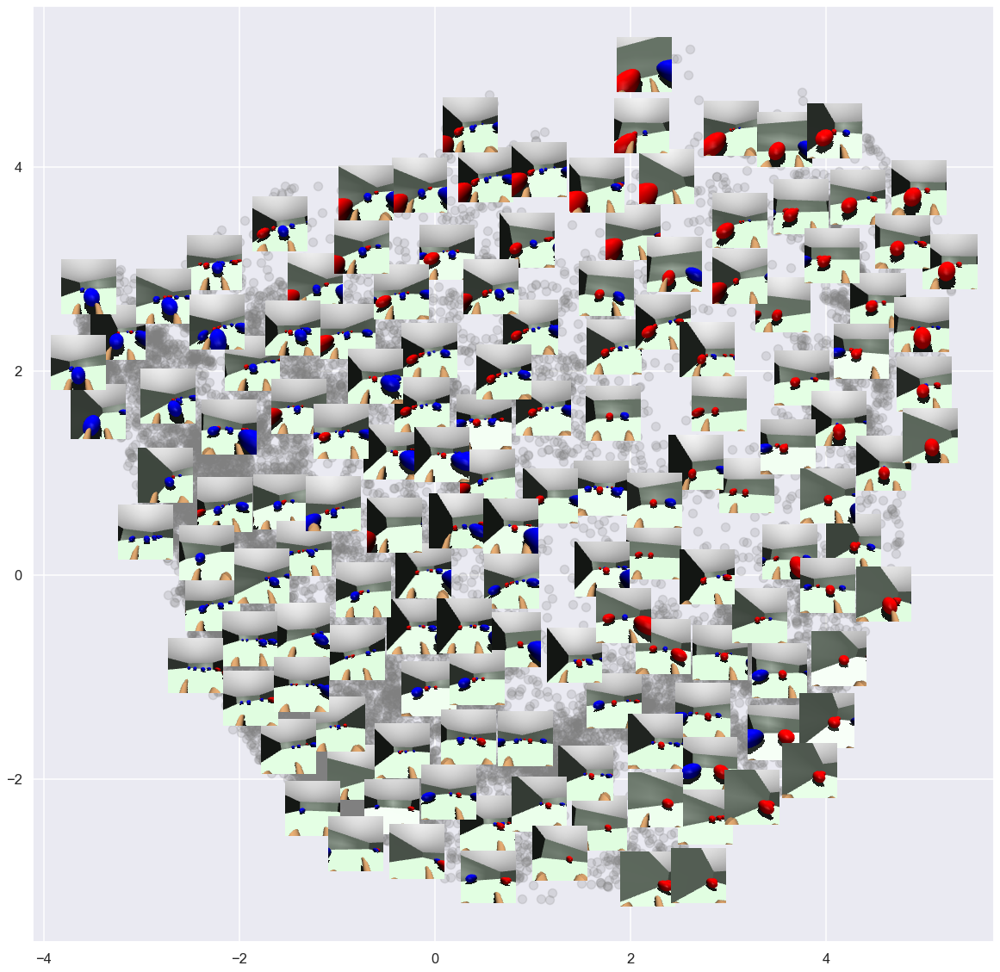

In [337]:
fig, ax = plt.subplots(figsize=(20, 20))

x_axis_pc = 0
y_axis_pc = 1

d_limit = 0.5

points_exist = []
artists = []
index_ = np.arange(MAX_STEPS - 1)
np.random.shuffle(index_)
for i in tqdm(index_):
    x, y = embed_pca_v[i, x_axis_pc], embed_pca_v[i, y_axis_pc]
    
    draw_ = True
    for point in points_exist:
        x_, y_ = point[0], point[1]
        
        if (x - x_)**2 + (y - y_)**2 < d_limit**2:
            draw_ = False
            break
            
    if draw_:
        im = OffsetImage(frames[i][:, :, -4:-1])
        ab = AnnotationBbox(im,
                            (x, y),
                            xycoords='data',
                            frameon=False)
        ax.add_artist(ab)
        points_exist.append((x, y))

plt.scatter(embed_pca_v[:, x_axis_pc], embed_pca_v[:, y_axis_pc], c="gray", s=100, alpha=0.2)
#plt.axis("off")
# plt.xlabel(f"PC{x_axis_pc + 1}")
# plt.ylabel(f"PC{y_axis_pc + 1}")
plt.show()

2876 178 108


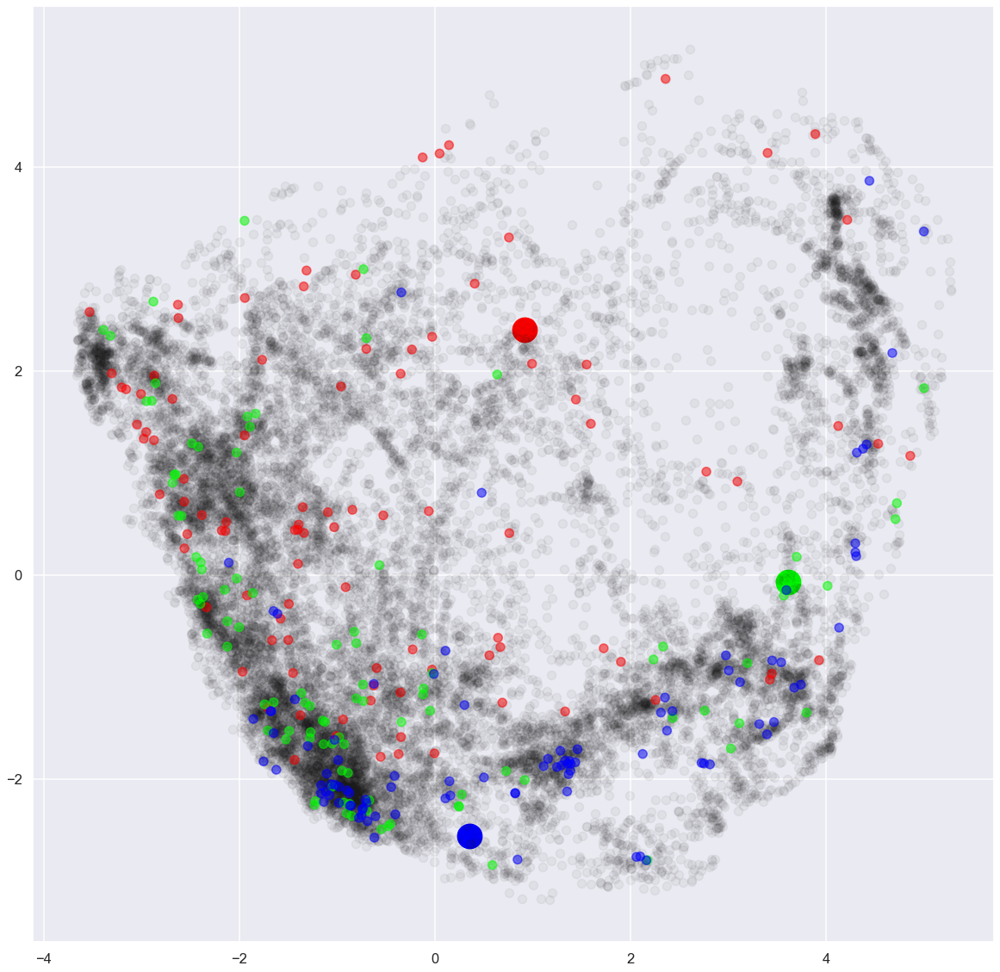

In [338]:
from copy import copy

fig, ax = plt.subplots(figsize=(20, 20))

N = 100
thresh = 0.5
cols = [(1,0,0), (0,1,0),(0,0,1)]

index_ = np.arange(MAX_STEPS - 1)

points_exist = [[],[],[]]
d_list = [[], [], []]

# i_0, i_1, i_2 = None, None, None
# for i in index_:
#     x, y = embed_pca_v[i, 0], embed_pca_v[i, 1]
    
#     if i_0 is None and np.abs(x + 2) < thresh and np.abs(y - 3) < thresh:
#         print(x, y)
#         plt.scatter(x, y, color=(1,0,0), s=800, alpha=1)
#         i_0 = copy(i)
    
#     if i_1 is None and np.abs(x - 0) < thresh and np.abs(y + 3) < thresh:
#         print(x, y)
#         plt.scatter(x, y, color=(0,1,0), s=800, alpha=1)
#         i_1 = copy(i)

#     if i_2 is None and np.abs(x - 3) < thresh and np.abs(y - 0) < thresh:
#         print(x, y)
#         plt.scatter(x, y, color=(0,0,1), s=800, alpha=1)
#         i_2 = copy(i)
        
#     if i_0 is not None and i_1 is not None and i_2 is not None:
#         break

plt.scatter(embed_pca_v[i_0, 0], embed_pca_v[i_0, 1], color=(1,0,0), s=800, alpha=1)
plt.scatter(embed_pca_v[i_1, 0], embed_pca_v[i_1, 1], color=(0,1,0), s=800, alpha=1)
plt.scatter(embed_pca_v[i_2, 0], embed_pca_v[i_2, 1], color=(0,0,1), s=800, alpha=1)

print(i_0, i_1, i_2)

#0, 100, ?
ref_p = [prop_list[i_0],
         prop_list[i_1],
         prop_list[i_2]]


# Calc proprooceptive distance from the referene points
# for i in tqdm(index_):
    
#     p = prop_list[i]
    
#     for j in range(3):
#         d_list[j].append(np.linalg.norm(p - ref_p[j]))

# index = []
# for k in range(3):
#     index.append(np.array(d_list[k]).argsort()[:N])

for i in range(3):
    for j in index[i]:
        x, y = embed_pca_v[j, 0], embed_pca_v[j, 1]
        points_exist[i].append((x, y, cols[i]))

x_, y_, c_ = [], [], []
for i in range(3):
    x_ += [v[0] for v in points_exist[i]]
    y_ += [v[1] for v in points_exist[i]]
    c_ += [v[2] for v in points_exist[i]]

plt.scatter(embed_pca_v[:, 0], embed_pca_v[:, 1], c="k", s=100, alpha=0.05)
plt.scatter(x_, y_, c=c_, s=100, alpha=0.5)
#plt.axis("off")
#plt.xlabel("PC1")
#plt.ylabel("PC2")
plt.show()

2876 178 108


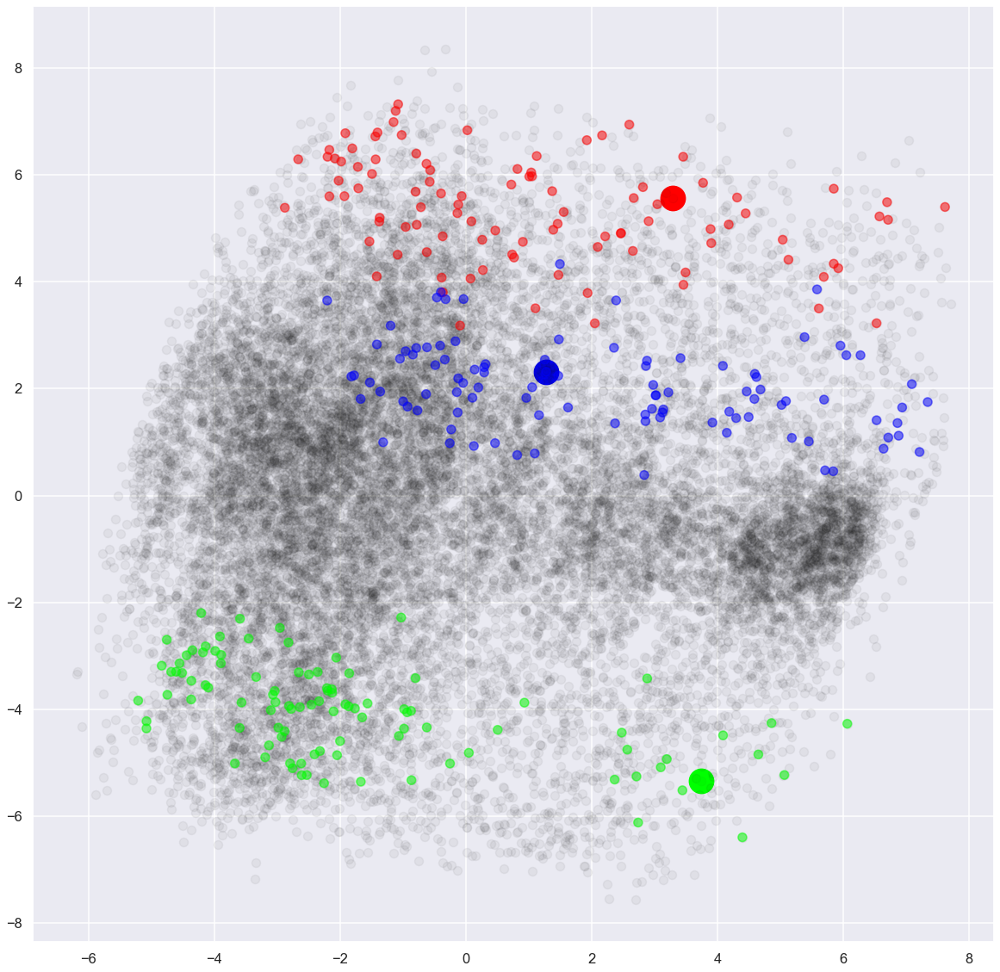

In [339]:
from copy import copy

fig, ax = plt.subplots(figsize=(20, 20))

N = 100
thresh = 0.5
cols = [(1,0,0), (0,1,0),(0,0,1)]

index_ = np.arange(MAX_STEPS - 1)

points_exist = [[],[],[]]
d_list = [[], [], []]

# i_0, i_1, i_2 = None, None, None
# for i in index_:
#     x, y = embed_pca_v[i, 0], embed_pca_v[i, 1]
    
#     if i_0 is None and np.abs(x + 2) < thresh and np.abs(y - 3) < thresh:
#         print(x, y)
#         plt.scatter(x, y, color=(1,0,0), s=800, alpha=1)
#         i_0 = copy(i)
    
#     if i_1 is None and np.abs(x - 0) < thresh and np.abs(y + 3) < thresh:
#         print(x, y)
#         plt.scatter(x, y, color=(0,1,0), s=800, alpha=1)
#         i_1 = copy(i)

#     if i_2 is None and np.abs(x - 3) < thresh and np.abs(y - 0) < thresh:
#         print(x, y)
#         plt.scatter(x, y, color=(0,0,1), s=800, alpha=1)
#         i_2 = copy(i)
        
#     if i_0 is not None and i_1 is not None and i_2 is not None:
#         break

plt.scatter(embed_pca_l1[i_0, 0], embed_pca_l1[i_0, 1], color=(1,0,0), s=800, alpha=1)
plt.scatter(embed_pca_l1[i_1, 0], embed_pca_l1[i_1, 1], color=(0,1,0), s=800, alpha=1)
plt.scatter(embed_pca_l1[i_2, 0], embed_pca_l1[i_2, 1], color=(0,0,1), s=800, alpha=1)

print(i_0, i_1, i_2)

#0, 100, ?
ref_p = [prop_list[i_0],
         prop_list[i_1],
         prop_list[i_2]]


# Calc proprooceptive distance from the referene points
# for i in tqdm(index_):
    
#     p = prop_list[i]
    
#     for j in range(3):
#         d_list[j].append(np.linalg.norm(p - ref_p[j]))

# index = []
# for k in range(3):
#     index.append(np.array(d_list[k]).argsort()[:N])

for i in range(3):
    for j in index[i]:
        x, y = embed_pca_l1[j, 0], embed_pca_l1[j, 1]
        points_exist[i].append((x, y, cols[i]))

x_, y_, c_ = [], [], []
for i in range(3):
    x_ += [v[0] for v in points_exist[i]]
    y_ += [v[1] for v in points_exist[i]]
    c_ += [v[2] for v in points_exist[i]]

plt.scatter(embed_pca_l1[:, 0], embed_pca_l1[:, 1], c="k", s=100, alpha=0.05)
plt.scatter(x_, y_, c=c_, s=100, alpha=0.5)
#plt.axis("off")
#plt.xlabel("PC1")
#plt.ylabel("PC2")
plt.show()

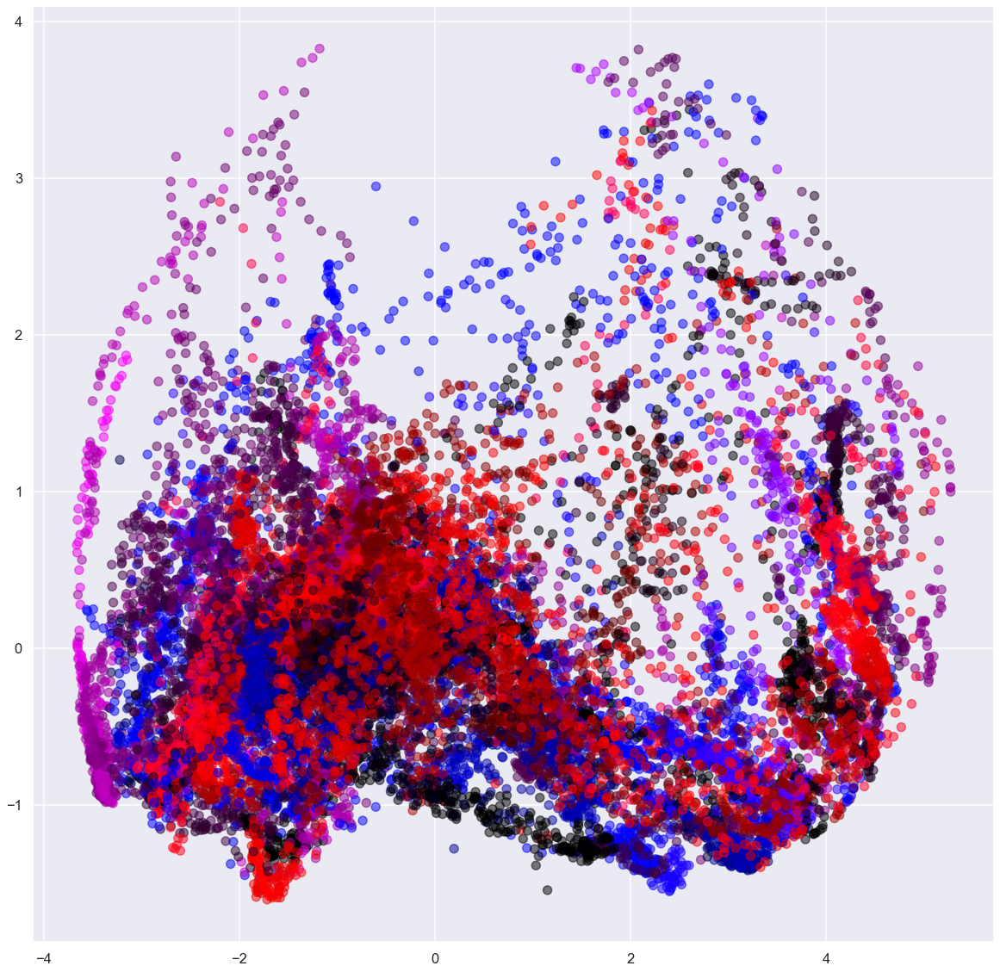

In [334]:
x_axis_pc = 0
y_axis_pc = 4

fig, ax = plt.subplots(figsize=(20, 20))
plt.scatter(embed_pca_v[:, x_axis_pc], embed_pca_v[:, y_axis_pc], c=c, s=100, alpha=0.5)

### 3d embed

In [240]:
print(embed_pca.shape, intero_list.shape, len(c))

(6000, 10) (6000, 2) 6000


### save video with internal representation

In [341]:
TEST_STEPS = 300
save_every = 4000
FPS = 120
time_stamp = datetime.now().strftime("%Y-%m-%d-%H-%M-%S")

video_index = 0
frames_is = []
for i in tqdm(range(MAX_STEPS)):

    fig = plt.figure(figsize=(10, 5), frameon=False)

    plt.subplot(121)
    plt.imshow(frames[i][:, :, -4:-1])
    plt.axis('off')

    plt.subplot(122)
    plt.scatter(embed_pca_l2[:, 0], embed_pca_l2[:, 1], c=c[:], s=2, alpha=0.5)
    plt.scatter(embed_pca_l2[i, 0], embed_pca_l2[i, 1], c=[c[i]], s=100, edgecolor="white")
    plt.axis("off")
    
    fig.canvas.draw()

    data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
    data = data.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    
    plt.clf()
    plt.close()
    
    frames_is.append(data)
    
    # record periodically
    if (i % save_every == 0 and i != 0) or (i == MAX_STEPS - 1):
        frames_vi = np.array(frames_is)

        print("get anim...")
        anim = display_video(frames_is, FPS)
        print("get writer...")
        writervideo = animation.FFMpegWriter(fps=FPS)
        print("saving...")
        s = f'ecocentroc_vision_latent2_{time_stamp}_{i}.mp4'
        anim.save(s, writer=writervideo)
        print(f"done. : {s}")
        
        frames_is = []
        video_index += 1

print("all done.")

  0%|                                                                                                                                                  | 0/20000 [00:00<?, ?it/s]/var/folders/hj/0xdmrh_n62n8g8c4lhb6085w0000gn/T/ipykernel_14709/544211836.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 20%|███████████████████████████                                                                                                            | 4000/20000 [11:35<46:40,  5.71it/s]

get anim...
get writer...
saving...


 20%|██████████████████████████▍                                                                                                         | 4001/20000 [12:40<86:38:35, 19.50s/it]/var/folders/hj/0xdmrh_n62n8g8c4lhb6085w0000gn/T/ipykernel_14709/544211836.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 20%|██████████████████████████▍                                                                                                         | 4002/20000 [12:40<60:54:04, 13.70s/it]

done. : ecocentroc_vision_latent2_2022-04-07-17-09-45_4000.mp4


 40%|██████████████████████████████████████████████████████                                                                                 | 8000/20000 [24:42<35:55,  5.57it/s]

get anim...
get writer...
saving...


 40%|████████████████████████████████████████████████████▊                                                                               | 8001/20000 [25:45<63:01:38, 18.91s/it]/var/folders/hj/0xdmrh_n62n8g8c4lhb6085w0000gn/T/ipykernel_14709/544211836.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 40%|████████████████████████████████████████████████████▊                                                                               | 8002/20000 [25:45<44:18:05, 13.29s/it]

done. : ecocentroc_vision_latent2_2022-04-07-17-09-45_8000.mp4


 60%|████████████████████████████████████████████████████████████████████████████████▍                                                     | 12000/20000 [38:07<25:58,  5.13it/s]

get anim...
get writer...
saving...


 60%|██████████████████████████████████████████████████████████████████████████████▌                                                    | 12001/20000 [39:13<44:14:41, 19.91s/it]

done. : ecocentroc_vision_latent2_2022-04-07-17-09-45_12000.mp4


/var/folders/hj/0xdmrh_n62n8g8c4lhb6085w0000gn/T/ipykernel_14709/544211836.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 16000/20000 [54:17<17:48,  3.74it/s]

get anim...
get writer...
saving...


 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 16001/20000 [55:58<34:00:50, 30.62s/it]

done. : ecocentroc_vision_latent2_2022-04-07-17-09-45_16000.mp4


/var/folders/hj/0xdmrh_n62n8g8c4lhb6085w0000gn/T/ipykernel_14709/544211836.py:23: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 19999/20000 [1:16:19<00:00,  3.70it/s]

get anim...
get writer...
saving...


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [1:17:56<00:00,  4.28it/s]

done. : ecocentroc_vision_latent2_2022-04-07-17-09-45_19999.mp4
all done.


## Conditioned embeded trajectory

### sampling conditioned trajectory : blue

In [123]:
STEPS_CONDITIONED = 6000

latent_list = []

obs = env.reset()
for i in tqdm(range(STEPS_CONDITIONED)):
    
    # Set interoception
    obs[27] = -0.2  # Blue
    obs[28] = 0.1 # Red
    env.reset_internal_state()
    
    with torch.no_grad():
        action = agent.act(obs)
        latent = agent.model.feature(torch.tensor([obs], device=f"cuda:{gpu_id}"), layer=2)

    latent_list.append(latent[0])

    obs, reward, done, info = env.step(action)
    
    if done:
        break

latent_blue = torch.stack(latent_list).cpu().numpy()

np.save("latent_blue", latent_blue)

100%|██████████| 6000/6000 [01:59<00:00, 50.06it/s]


In [124]:
latent_list = []

obs = env.reset()
for i in tqdm(range(STEPS_CONDITIONED)):
    
    # Set interoception
    obs[27] = 0.1  # Blue
    obs[28] = -0.2 # Red
    env.reset_internal_state()
    
    with torch.no_grad():
        action = agent.act(obs)
        latent = agent.model.feature(torch.tensor([obs], device=f"cuda:{gpu_id}"), layer=2)

    latent_list.append(latent[0])

    obs, reward, done, info = env.step(action)
    
    if done:
        break

latent_red = torch.stack(latent_list).cpu().numpy()

np.save("latent_red", latent_red)

100%|██████████| 6000/6000 [02:00<00:00, 49.79it/s]


In [8]:
latent_blue = np.load("latent_blue.npy")
latent_red = np.load("latent_red.npy")

embed_pca_blue = pca.transform(latent_blue)
embed_pca_red = pca.transform(latent_red)

In [225]:
#%matplotlib tk
%matplotlib inline

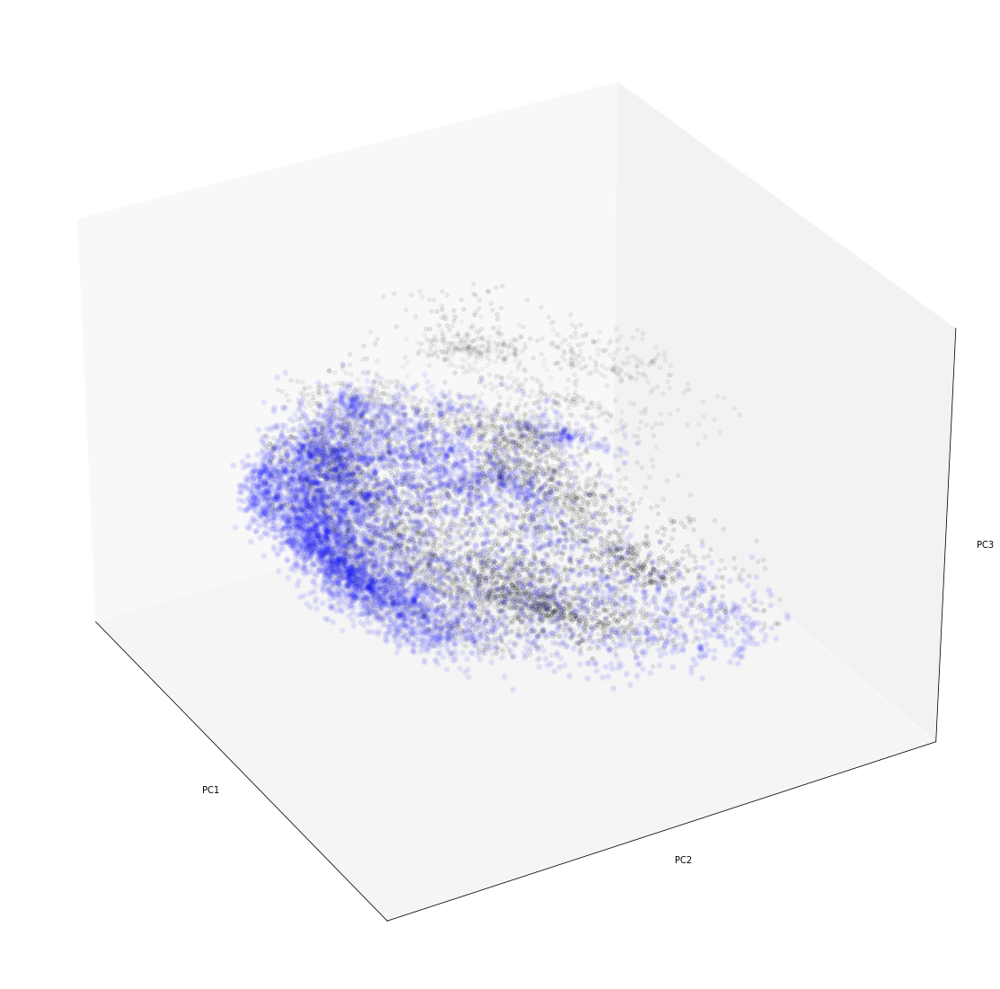

In [251]:
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(projection='3d')
ax.scatter(embed_pca[:, 0], embed_pca[:, 1], embed_pca[:, 2], color=(0,0,0,0.1))
ax.scatter(embed_pca_blue[:, 0], embed_pca_blue[:, 1], embed_pca_blue[:, 2], color=(0,0,1,0.1), linewidth=3)

ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")
ax.set_xticks([])
ax.set_yticks([])
ax.set_zticks([])
#ax.xaxis.pane.fill = False
ax.xaxis.pane.set_edgecolor('white')
#ax.yaxis.pane.fill = False
ax.yaxis.pane.set_edgecolor('white')
#ax.zaxis.pane.fill = False
ax.zaxis.pane.set_edgecolor('white')
ax.grid(False)

ax.azim = -30
ax.dist = 10
ax.elev =30
    
plt.show()

done


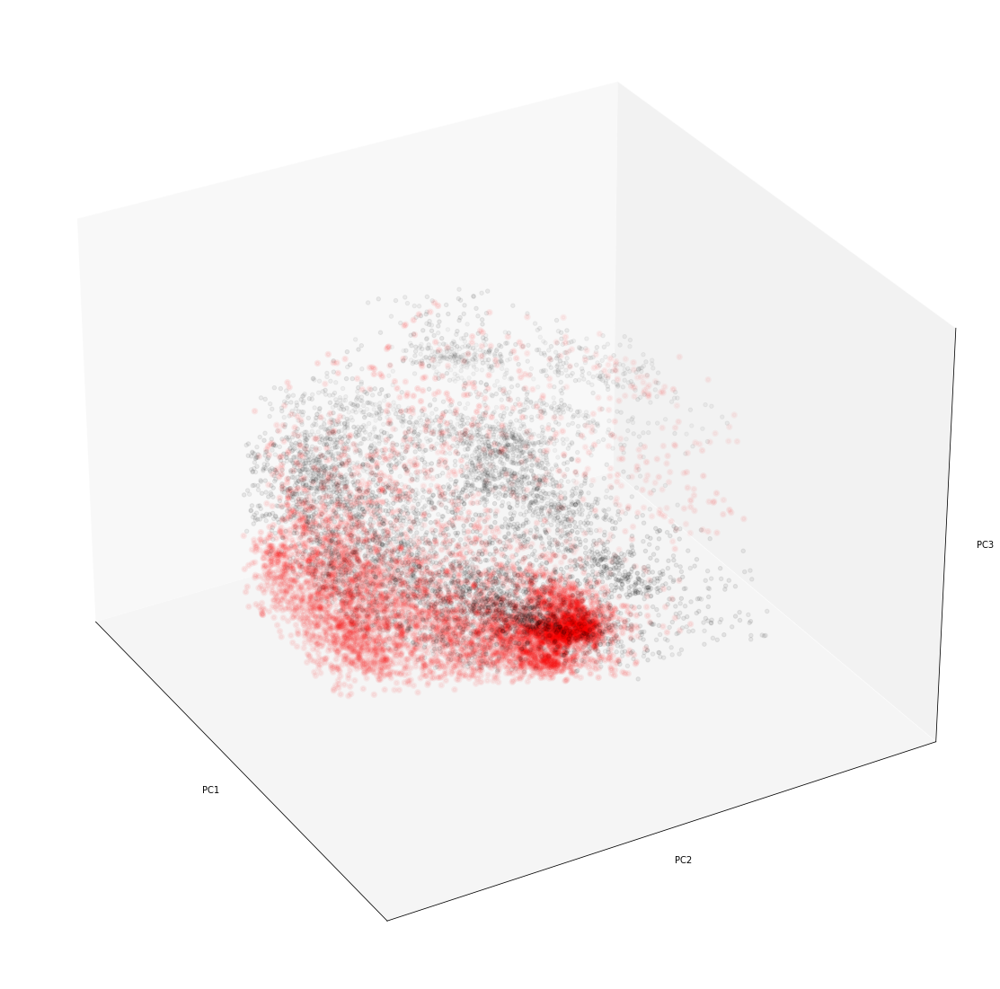

In [256]:
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(projection='3d')

ax.scatter(embed_pca[:, 0], embed_pca[:, 1], embed_pca[:, 2], color=(0,0,0,0.1))
ax.scatter(embed_pca_red[:, 0], embed_pca_red[:, 1], embed_pca_red[:, 2], color=(1,0,0,0.1), linewidth=3)

ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")
ax.set_xticks([])
ax.set_yticks([])
ax.set_zticks([])
#ax.xaxis.pane.fill = False
ax.xaxis.pane.set_edgecolor('white')
#ax.yaxis.pane.fill = False
ax.yaxis.pane.set_edgecolor('white')
#ax.zaxis.pane.fill = False
ax.zaxis.pane.set_edgecolor('white')
ax.grid(False)

ax.azim = -30
ax.dist = 10
ax.elev =30
print("done")

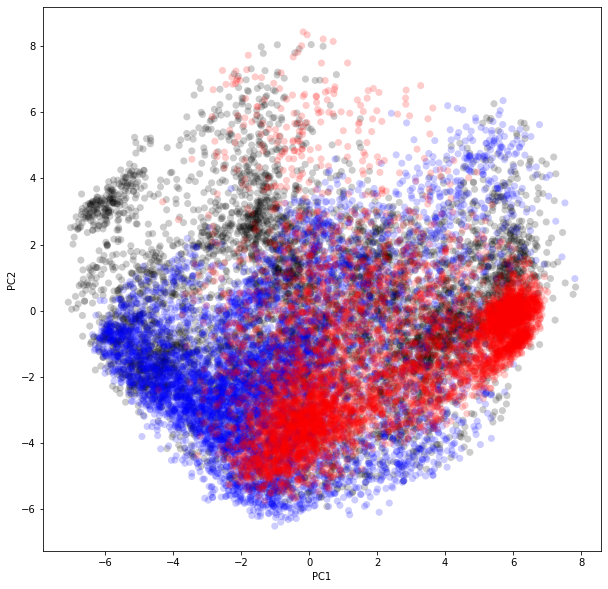

In [243]:
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot()
ax.scatter(embed_pca[:, 0], embed_pca[:, 1], color=(0,0,0,0.2), s=50, edgecolors='none')
ax.scatter(embed_pca_blue[:, 0], embed_pca_blue[:, 1], color=(0,0,1,0.2), edgecolors='none', s=50)
ax.scatter(embed_pca_red[:, 0], embed_pca_red[:, 1], color=(1,0,0,0.2), edgecolors='none', s=50)

ax.set_xlabel("PC1")
ax.set_ylabel("PC2")

plt.show()

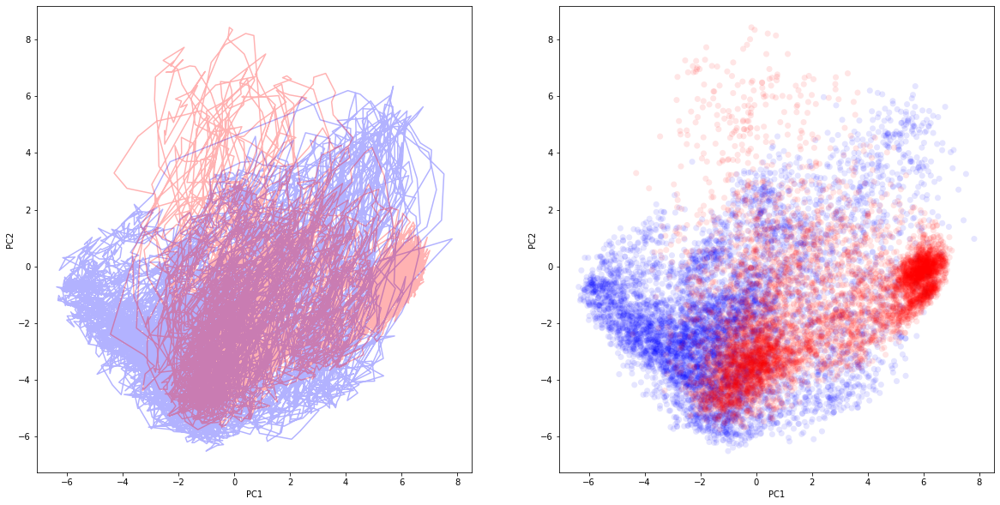

In [266]:
fig = plt.figure(figsize=(20, 10))

plt.subplot(121)
plt.plot(embed_pca_blue[:, 0], embed_pca_blue[:, 1], color=(0,0,1,0.3))
plt.plot(embed_pca_red[:, 0], embed_pca_red[:, 1], color=(1,0,0,0.3))

plt.xlabel("PC1")
plt.ylabel("PC2")

plt.subplot(122)
plt.scatter(embed_pca_blue[:, 0], embed_pca_blue[:, 1], color=(0,0,1,0.1), edgecolors='none', s=50)
plt.scatter(embed_pca_red[:, 0], embed_pca_red[:, 1], color=(1,0,0,0.1), edgecolors='none', s=50)

plt.xlabel("PC1")
plt.ylabel("PC2")
    
plt.show()

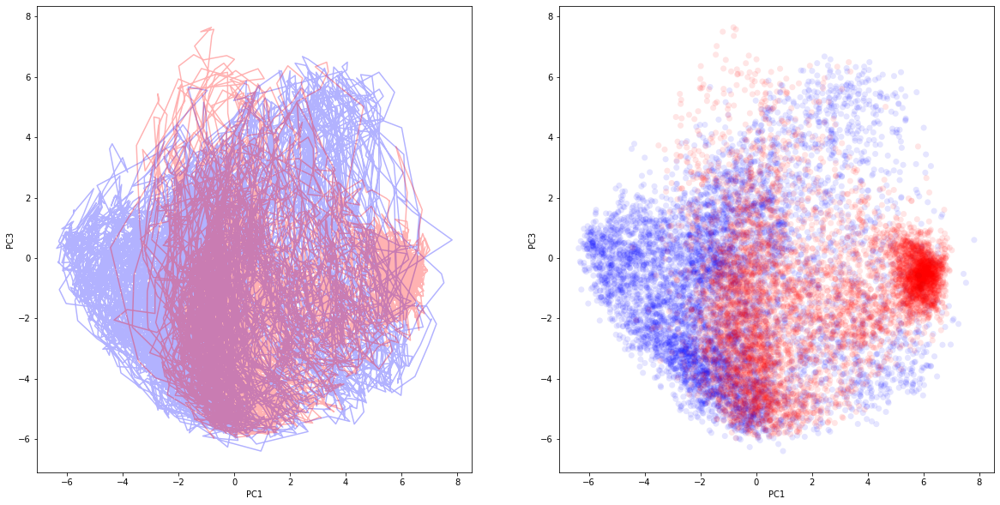

In [28]:
fig = plt.figure(figsize=(20, 10))

plt.subplot(121)
plt.plot(embed_pca_blue[:, 0], embed_pca_blue[:, 2], color=(0,0,1,0.3))
plt.plot(embed_pca_red[:, 0], embed_pca_red[:, 2], color=(1,0,0,0.3))

plt.xlabel("PC1")
plt.ylabel("PC3")

plt.subplot(122)
plt.scatter(embed_pca_blue[:, 0], embed_pca_blue[:, 2], color=(0,0,1,0.1), edgecolors='none', s=50)
plt.scatter(embed_pca_red[:, 0], embed_pca_red[:, 2], color=(1,0,0,0.1), edgecolors='none', s=50)

plt.xlabel("PC1")
plt.ylabel("PC3")

plt.show()

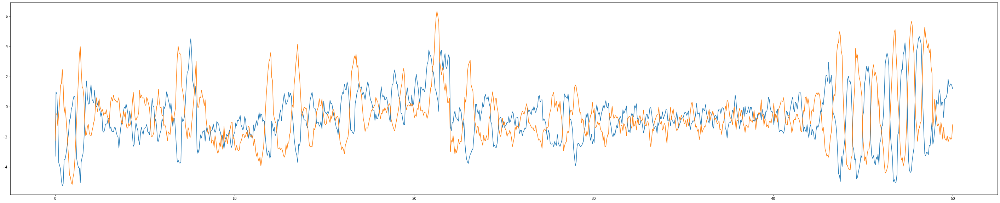

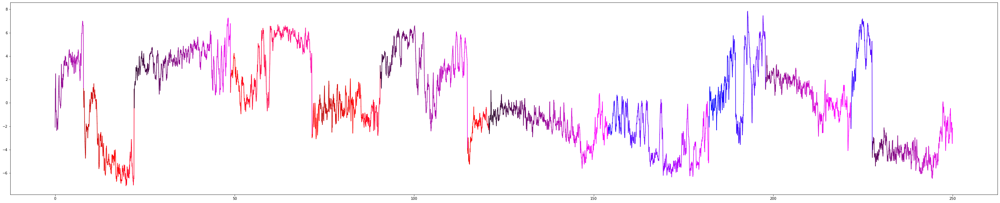

In [83]:
plt.figure(figsize=(50, 10))
plt.plot(np.linspace(0, env.dt*1000, 1000), embed_pca[:1000, 1])
plt.plot(np.linspace(0, env.dt*1000, 1000), embed_pca[:1000, 2])
plt.show()

plt.figure(figsize=(50, 10))
for i in range(5000):
    plt.plot([env.dt * i, env.dt * (i+1)],
             [embed_pca[i, 0], embed_pca[i+1, 0]],
             color=c[i])
# plt.plot(embed_pca[:1000, 0])

0.05


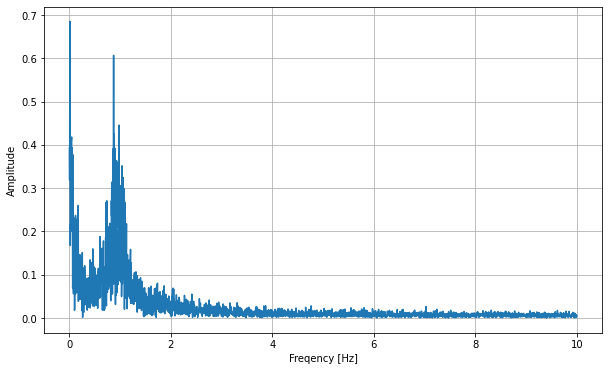

In [93]:
seq = embed_pca[:, 2]
F = np.fft.fft(seq) # 変換結果
print(env.dt)
freq = np.fft.fftfreq(len(seq), d=env.dt) # 周波数

# fig, ax = plt.subplots(nrows=3, sharex=True, figsize=(10,6))
# ax[0].plot(F.real, label="Real part")
# ax[0].legend()
# ax[1].plot(F.imag, label="Imaginary part")
# ax[1].legend()
# ax[2].plot(freq, label="Frequency")
# ax[2].legend()
# ax[2].set_xlabel("Number of data")
# plt.show()

Amp = np.abs(F/(len(seq)/2)) # 振幅

fig, ax = plt.subplots(figsize=(10,6))
ax.plot(freq[1:int(len(seq)/2)], Amp[1:int(len(seq)/2)])
ax.set_xlabel("Freqency [Hz]")
ax.set_ylabel("Amplitude")
ax.grid()
plt.show()

# joint TSNE embeding of the latent space

In [11]:
all_latent = np.vstack([latent, latent_blue, latent_red])
latent_embed_all = TSNE(n_components=2, learning_rate="auto", init="random").fit_transform(all_latent)

In [12]:
print(latent_embed_all.shape, latent.shape, latent_blue.shape, latent_red.shape)

(18000, 2) (6000, 200) (6000, 200) (6000, 200)


(-119.51406478881836,
 113.80112838745117,
 -107.13494758605957,
 103.63967018127441)

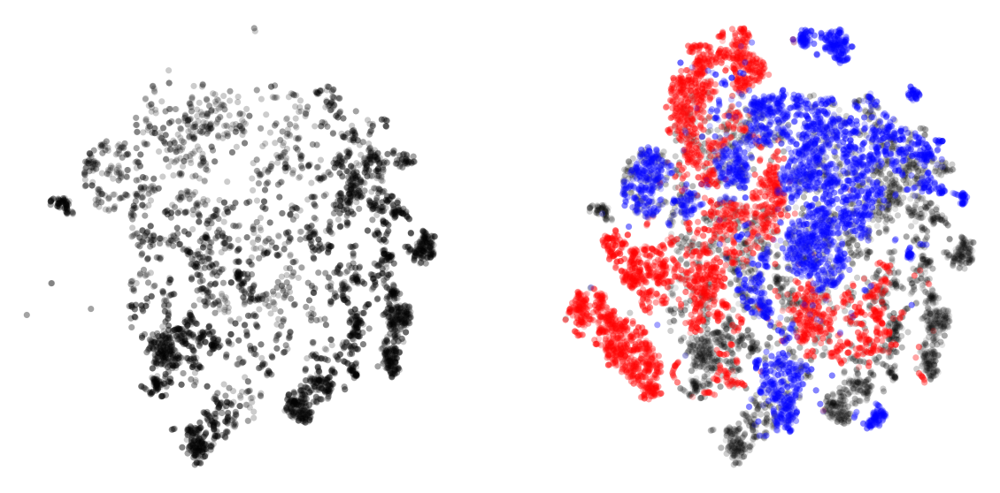

In [13]:
l = latent_embed_all[:MAX_STEPS]
lb = latent_embed_all[MAX_STEPS:2*MAX_STEPS]
lr = latent_embed_all[2*MAX_STEPS:3*MAX_STEPS]

plt.figure(figsize=(20, 10))
plt.subplot(1,2,1)
plt.scatter(l[:, 0], l[:, 1], color=(0,0,0,0.2), edgecolors='none', s=50)
plt.axis("off")

plt.subplot(1,2,2)
plt.scatter(l[:, 0], l[:, 1], color=(0,0,0,0.1), edgecolors='none', s=50)
plt.scatter(lr[:, 0], lr[:, 1], color=(1,0,0,0.2), edgecolors='none', s=50)
plt.scatter(lb[:, 0], lb[:, 1], color=(0,0,1,0.2), edgecolors='none', s=50)
plt.axis("off")

# Food counting

In [7]:
n_sample = 50
MAX_STEPS = 8000

## Data of normal situation (nutritional target)

In [55]:
cum_nutrient_target = np.zeros((n_sample, MAX_STEPS, 2))
intero_data_target = np.zeros((n_sample, MAX_STEPS, 2))
seeds = np.random.randint(0, 100000, n_sample).tolist()
print("seeds: ", seeds)

for n in range(n_sample):
    env = get_env()
    env.seed(seeds[n])
    obs = env.reset()

    for i in tqdm(range(MAX_STEPS)):
        action = agent.act(obs)
        obs, reward, done, info = env.step(action)

        if i > 0:
            d_nutrient = info["food_eaten"][0] * np.array((0.1, 0)) + info["food_eaten"][1] * np.array((0, 0.1))
            cum_nutrient_target[n, i] = cum_nutrient_target[n, i - 1] + d_nutrient

        intero_data_target[n, i] = env.get_interoception()

        if done:
            print("dead... @", b)
            break

seeds:  [22803, 8760, 56010, 14930, 7890, 87956, 92766, 13197, 85317, 92907, 60186, 80396, 35264, 15354, 82174, 5697, 28912, 22261, 34181, 82839, 32561, 45766, 61236, 83607, 95730, 52984, 27992, 75192, 39913, 36213, 20239, 21402, 73377, 50083, 84749, 55184, 43283, 2587, 70428, 81789, 78255, 10934, 59300, 38376, 54943, 96519, 29435, 94739, 21544, 65516]
Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:14<00:00, 59.55it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:11<00:00, 60.99it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:11<00:00, 60.91it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:14<00:00, 59.58it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:10<00:00, 61.23it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:16<00:00, 58.48it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:14<00:00, 59.42it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:13<00:00, 59.88it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:10<00:00, 61.29it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:18<00:00, 57.83it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:54<00:00, 45.91it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:54<00:00, 45.86it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:55<00:00, 45.53it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:58<00:00, 44.79it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:53<00:00, 46.18it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:58<00:00, 44.90it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:00<00:00, 44.27it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:05<00:00, 43.04it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.33it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.34it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.43it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:09<00:00, 42.18it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:09<00:00, 42.25it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:07<00:00, 42.55it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:10<00:00, 42.09it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.41it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:07<00:00, 42.62it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.39it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.36it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:10<00:00, 42.10it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:07<00:00, 42.60it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:09<00:00, 42.31it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.36it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:04<00:00, 43.44it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:09<00:00, 42.26it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.53it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.38it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.40it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.37it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [02:58<00:00, 44.84it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:10<00:00, 42.08it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:09<00:00, 42.15it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.52it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.45it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.47it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:09<00:00, 42.15it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:07<00:00, 42.60it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:08<00:00, 42.44it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:10<00:00, 42.05it/s]


Creating offscreen glfw


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8000/8000 [03:06<00:00, 42.81it/s]


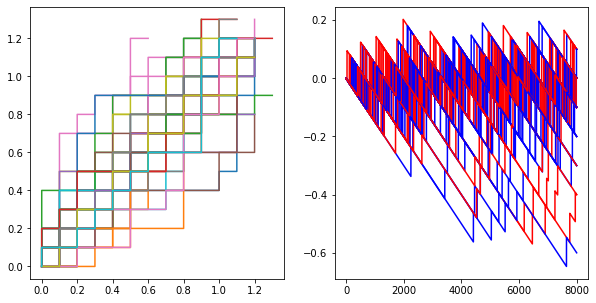

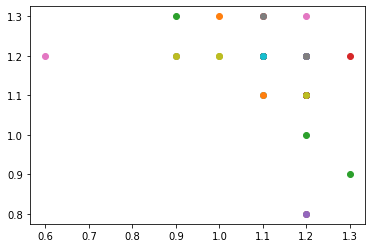

In [59]:
plt.figure(figsize=(10, 5))
for n in range(n_sample):
    plt.subplot(121)
    plt.plot(cum_nutrient_target[n, :, 0], cum_nutrient_target[n, :, 1])
    plt.subplot(122)
    plt.plot(intero_data_target[n, :, 0], "b")
    plt.plot(intero_data_target[n, :, 1], "r")
plt.show()

for n in range(n_sample):
    plt.scatter(cum_nutrient_target[n, -1, 0], cum_nutrient_target[n, -1, 1])

    
np.save("cum_nutrient_target50.npy", cum_nutrient_target)
np.save("intero_data_cn_target50.npy", intero_data_target)

## Data of Red Food

In [8]:
n_bias = 0 # zero ideally

seeds = np.random.randint(0, 100000, n_sample).tolist()
print("seeds: ", seeds)

balance_list = np.linspace(0.02, 0.08, 10).tolist()

for n in tqdm(range(1000)):#n_sample - n_bias + 1)):
    cum_nutrient = np.zeros((len(balance_list), MAX_STEPS, 2))
    intero_data = np.zeros((len(balance_list), MAX_STEPS, 2))
    is_dead = np.zeros((len(balance_list)))
    for i, b in enumerate(balance_list):
        print(f"balance list @ {b}, {i+1}/{len(balance_list)}")
        env = get_env(n_blue_red=(0, 6), red_nutrient=(b, 0.1 - b))
        env.seed(seeds[n])
        obs = env.reset()

        for j in range(MAX_STEPS):
            action = agent.act(obs)
            obs, reward, done, info = env.step(action)
            env.render()

            if j > 0:
                d_nutrient = info["food_eaten"][1] * np.array((b, 0.1 - b))
                cum_nutrient[i, j] = cum_nutrient[i, j - 1] + d_nutrient

            intero_data[i, j] = env.get_interoception()

            if done:
                print("dead... @", b)
                is_dead[i] = True
                break
        env.close()
    
    # save files
#     np.save(f"cum_nutrient50_{n + n_bias}.npy", cum_nutrient)
#     np.save(f"intero_data_cn50_{n + n_bias}.npy", intero_data)
#     np.save(f"is_dead50_{n + n_bias}.npy", is_dead)

seeds:  [38408, 56088, 79683, 77655, 65615, 81840, 63370, 82270, 14260, 75618, 20533, 13890, 71182, 49954, 78833, 86296, 91791, 59243, 17724, 7738, 42491, 38537, 80989, 6230, 84354, 71323, 83820, 30596, 27039, 21377, 35981, 6901, 54995, 10843, 77755, 96305, 44463, 93889, 76093, 85687, 21243, 52560, 49154, 66425, 35294, 26003, 12571, 61240, 23790, 62833]


  0%|                                                                       | 0/1000 [00:00<?, ?it/s]

balance list @ 0.02, 1/10
Creating offscreen glfw
GLFW error (code %d): %s 65537 b'The GLFW library is not initialized'
GLFW error (code %d): %s 65537 b'The GLFW library is not initialized'
GLFW error (code %d): %s 65537 b'The GLFW library is not initialized'


GlfwError: Failed to create GLFW window

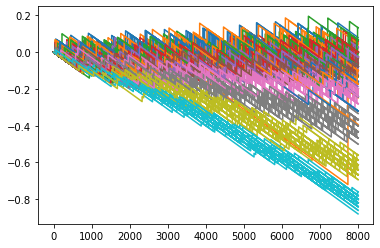

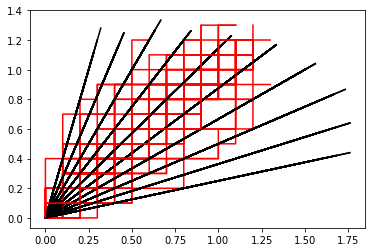

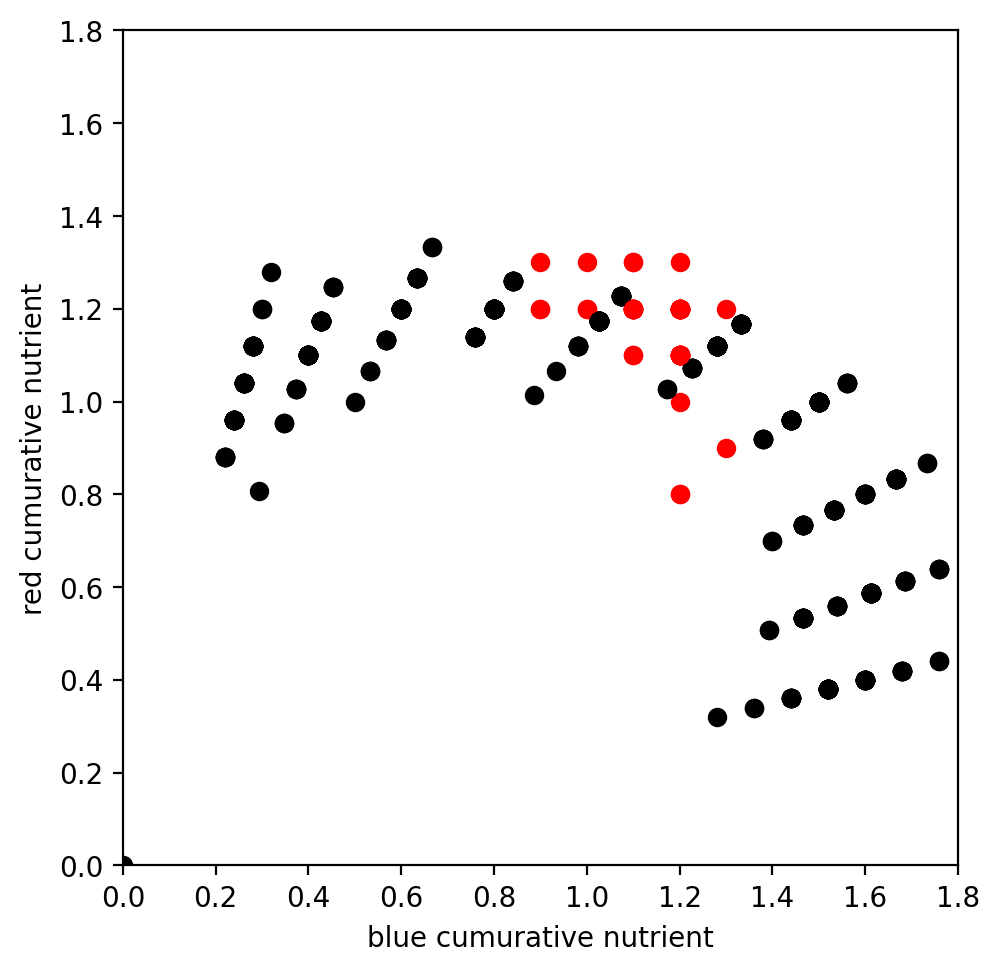

In [8]:
cum_nutrient_target = np.load("cum_nutrient_target50.npy")
intete_data_target = np.load("intero_data_cn_target50.npy")

cum_nutrient = np.zeros((n_sample, len(balance_list), MAX_STEPS, 2))
intero_data = np.zeros((n_sample, len(balance_list), MAX_STEPS, 2))
for i in range(n_sample):
    cum_nutrient[i] = np.load(f"cum_nutrient50_{i}.npy")
    intero_data[i] = np.load(f"intero_data_cn50_{i}.npy")

for n in range(n_sample):
    for i in range(len(balance_list)):
        plt.plot(intero_data[n, i, :, 1])
plt.show()

for n in range(n_sample):
    for i in range(len(balance_list)):
        #if not is_dead[i]:
        plt.plot(cum_nutrient[n, i, :, 0],
                 cum_nutrient[n, i, :, 1], c="k")
    
    plt.plot(cum_nutrient_target[n, :, 0],
             cum_nutrient_target[n, :, 1], c="r")

plt.show()


fig = plt.figure(figsize=(5, 5), dpi=200)
ax = fig.subplots(1,1)

for n in range(n_sample):
    for i in range(len(balance_list)):
        #if not is_dead[i]:
        plt.scatter(cum_nutrient[n, i, -1, 0],
                    cum_nutrient[n, i, -1, 1], c="k")
    
    plt.scatter(cum_nutrient_target[n, -1, 0],
                cum_nutrient_target[n, -1, 1], c="r")

ax.set_xlabel("blue cumurative nutrient")
ax.set_ylabel("red cumurative nutrient")
#plt.legend(balance_list)
ax.set_aspect('equal', 'box')
plt.ylim([0, 1.8])
plt.xlim([0, 1.8])
fig.tight_layout()
plt.show()

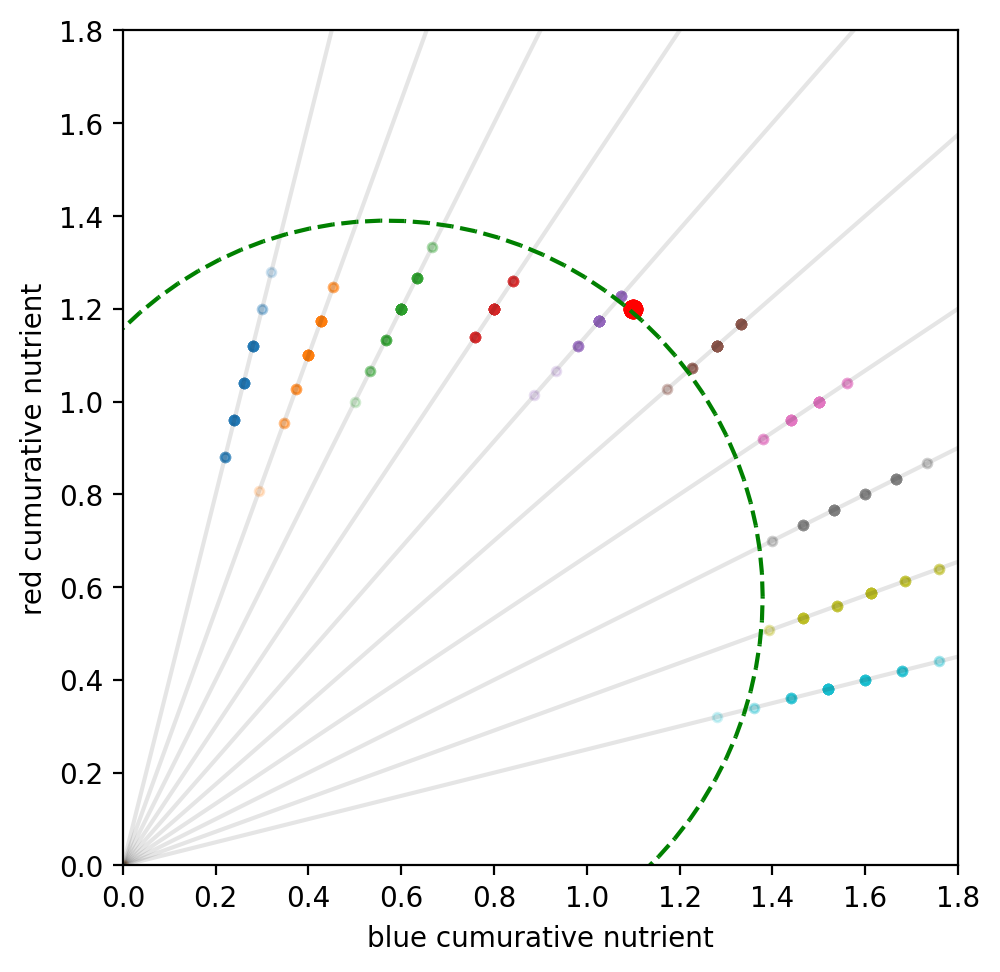

In [33]:
fig = plt.figure(figsize=(5, 5), dpi=200)
ax = fig.subplots(1,1)

for i in range(len(balance_list)):
    # nurtient rail
    plt.plot([0, 100 * balance_list[i]], [0, 100 * (0.1 - balance_list[i])], color=(0, 0, 0, 0.1))

    color = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink', 'tab:gray', 'tab:olive', 'tab:cyan']
    for n in range(n_sample):
        plt.scatter(cum_nutrient[n, i, -1, 0],
                    cum_nutrient[n, i, -1, 1],
                    s=10,
                    color=color[i],
                    alpha=0.2)
    
    plt.scatter(cum_nutrient_target[n, -1, 0],
                cum_nutrient_target[n, -1, 1], c="r")

# equi distance circle
angles = np.linspace(0, 2 * np.pi, 100)
R = np.sqrt(np.mean(cum_nutrient_target[:, -1, 0])**2 + np.mean(cum_nutrient_target[:, -1, 1])**2) / 2
theta = np.arctan2(np.mean(cum_nutrient_target[:, -1, 1]),
                   np.mean(cum_nutrient_target[:, -1, 0]))
c = R * np.array([np.cos(theta), np.sin(theta)])
for i, ang in enumerate(angles):
    x0 = c[0] + R * np.cos(angles[i - 1])
    y0 = c[1] + R * np.sin(angles[i - 1])
    x1 = c[0] + R * np.cos(angles[i])
    y1 = c[1] + R * np.sin(angles[i])
    plt.plot([x0, x1], [y0, y1], "--g")

ax.set_xlabel("blue cumurative nutrient")
ax.set_ylabel("red cumurative nutrient")
#plt.legend(balance_list)
ax.set_aspect('equal', 'box')
plt.ylim([0, 1.8])
plt.xlim([0, 1.8])
fig.tight_layout()
plt.show()

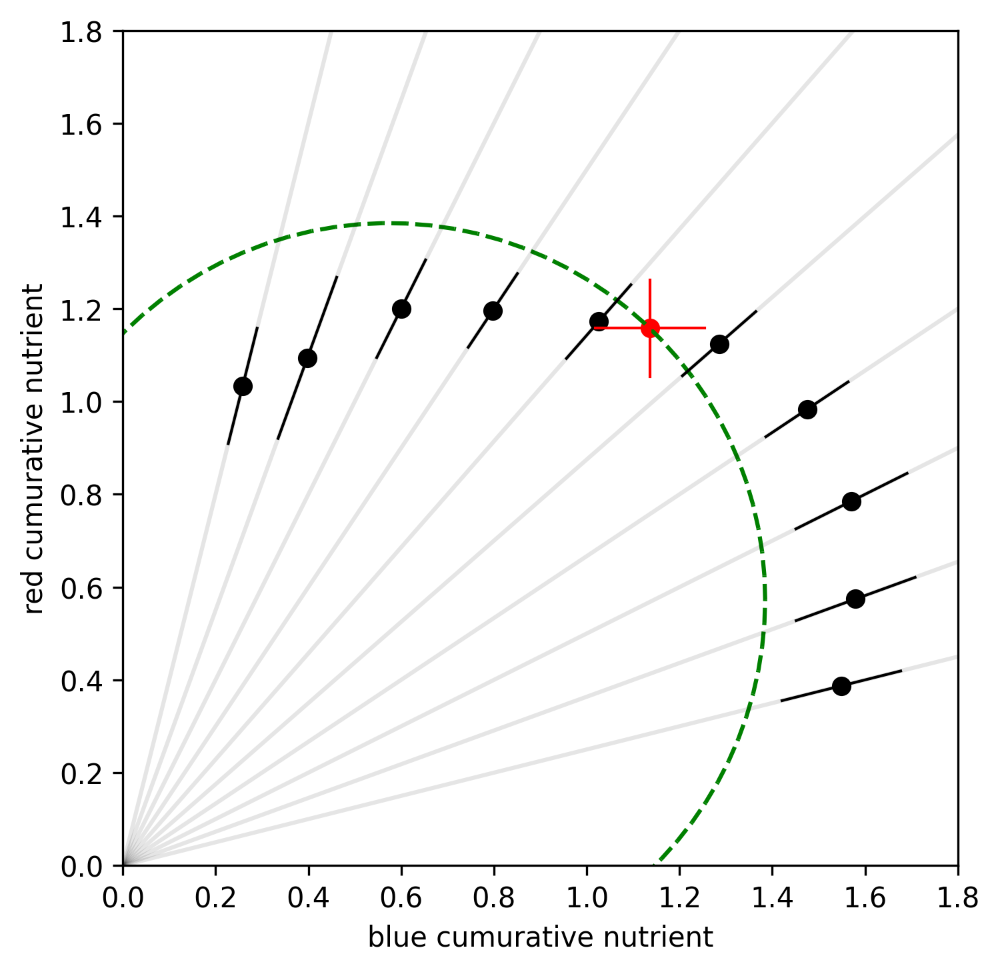

In [32]:
def progress_plot(fig, time_at=-1):
    ax = fig.subplots(1,1)

    mean_cn_b = np.mean(cum_nutrient[:, :, time_at, 0], axis=0)
    mean_cn_r = np.mean(cum_nutrient[:, :, time_at, 1], axis=0)

    std_cn = np.zeros(len(balance_list))
    for i in range(len(balance_list)):
        tmpb = cum_nutrient[:, i, time_at, 0] - mean_cn_b[i]
        tmpr = cum_nutrient[:, i, time_at, 1] - mean_cn_r[i]
        std_cn[i] = np.sqrt((np.linalg.norm(tmpb, 2) + np.linalg.norm(tmpr, 2)) / n_sample)

    mean_cn_tb = np.mean(cum_nutrient_target[:, time_at, 0])
    mean_cn_tr = np.mean(cum_nutrient_target[:, time_at, 1])
    std_cn_tb = np.std(cum_nutrient_target[:, time_at, 0])
    std_cn_tr = np.std(cum_nutrient_target[:, time_at, 1])

    # equi distance circle
    angles = np.linspace(0, 2 * np.pi, 100)
    R = np.sqrt(mean_cn_tb**2 + mean_cn_tr**2) / 2
    theta = np.arctan2(mean_cn_tr, mean_cn_tr)
    c = R * np.array([np.cos(theta), np.sin(theta)])

    for i, ang in enumerate(angles):
        x0 = c[0] + R * np.cos(angles[i - 1])
        y0 = c[1] + R * np.sin(angles[i - 1])
        x1 = c[0] + R * np.cos(angles[i])
        y1 = c[1] + R * np.sin(angles[i])
        plt.plot([x0, x1], [y0, y1], "--g")

    # plot error bar
    for i in range(len(balance_list)):
        err_angle = np.arctan2(0.1 - balance_list[i], balance_list[i])
        dx = std_cn[i] * np.cos(err_angle)
        dy = std_cn[i] * np.sin(err_angle)
        plt.plot([mean_cn_b[i], mean_cn_b[i] + dx], [mean_cn_r[i], mean_cn_r[i] + dy], "k", linewidth=1)
        plt.plot([mean_cn_b[i], mean_cn_b[i] - dx], [mean_cn_r[i], mean_cn_r[i] - dy], "k", linewidth=1)
        
        # nurtient rail
        plt.plot([0, 100 * balance_list[i]], [0, 100 * (0.1 - balance_list[i])], color=(0, 0, 0, 0.1))

    dx = std_cn_tb
    dy = std_cn_tr
    plt.plot([mean_cn_tb, mean_cn_tb + dx], [mean_cn_tr, mean_cn_tr], "r", linewidth=1)
    plt.plot([mean_cn_tb, mean_cn_tb - dx], [mean_cn_tr, mean_cn_tr], "r", linewidth=1)
    plt.plot([mean_cn_tb, mean_cn_tb], [mean_cn_tr, mean_cn_tr + dy], "r", linewidth=1)
    plt.plot([mean_cn_tb, mean_cn_tb], [mean_cn_tr, mean_cn_tr - dy], "r", linewidth=1)

    # plot mean points
    plt.scatter(mean_cn_b, mean_cn_r, c="k")
    plt.scatter([mean_cn_tb], [mean_cn_tr], c="r")

    # for n in range(n_sample):
    #     for i in range(len(balance_list)):
    #         #if not is_dead[i]:
    #         plt.plot(cum_nutrient[n, i, :, 0],
    #                  cum_nutrient[n, i, :, 1], c="k")

    # for n in range(n_sample):
    #     for i in range(len(balance_list)):
    #         #if not is_dead[i]:
    #         plt.scatter(cum_nutrient[n, i, -1, 0],
    #                     cum_nutrient[n, i, -1, 1], c="k")

    ax.set_xlabel("blue cumurative nutrient")
    ax.set_ylabel("red cumurative nutrient")
    #plt.legend(balance_list)
    ax.set_aspect('equal', 'box')
    plt.ylim([0, 1.8])
    plt.xlim([0, 1.8])
    fig.tight_layout()

    plt.show()

fig = plt.figure(figsize=(5, 5), dpi=300)
progress_plot(fig)

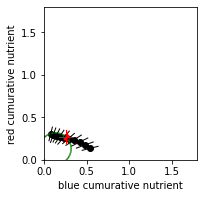

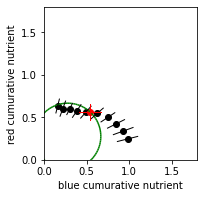

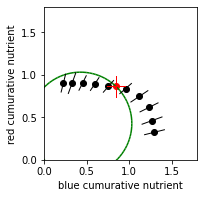

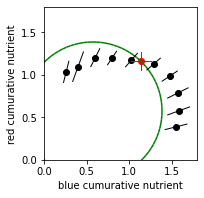

In [20]:
for at in [2000, 4000, 6000, 8000]:
    fig = plt.figure(figsize=(3, 3))
    progress_plot(fig, at - 1)

## Data of Blue food (not used)

In [ ]:
balance_list = np.linspace(0.03, 0.06, 20).tolist()

cum_nutrient = np.zeros((len(balance_list), MAX_STEPS, 2))
intero_data = np.zeros((len(balance_list), MAX_STEPS, 2))

for i, b in enumerate(balance_list):
    print(f"balance list @ {b}, {i+1}/{len(balance_list)}")
    env = get_env(n_blue_red=(6, 0), blue_nutrient=(b, 0.1 - b))
    obs = env.reset()

    for j in range(MAX_STEPS):
        action = agent.act(obs)
        obs, reward, done, info = env.step(action)

        if j > 0:
            d_nutrient = info["food_eaten"][0] * np.array((b, 0.1 - b))
            cum_nutrient[i, j] = cum_nutrient[i, j - 1] + d_nutrient
            
        intero_data[i, j] = env.get_interoception()

        if done:
            print("dead... @", b)
            break

plt.figure(figsize=(3, 3), dpi=300)
for i in range(len(balance_list)):
    plt.plot(cum_nutrient[i, :8000, 0], cum_nutrient[i, :8000, 1])
plt.xlabel("blue")
plt.ylabel("red")
#plt.legend(balance_list)
plt.show()

In [37]:
cum_nutrient_target[0, :]

array([[0. , 0. ],
       [0. , 0. ],
       [0. , 0. ],
       ...,
       [0.3, 0.2],
       [0.3, 0.2],
       [0.3, 0.2]])

# Developmental Analysis

In [8]:
developmental_file_path = [f"results/vision_checkpoint/{i+1}000000_checkpoint/" for i in range(20)]

for file_path in developmental_file_path:
    agent.load(file_path)

In [7]:
print([i for i in range(1)])

[0]
